## Loading the data and making the association between the name of the Txt file and the position of the sensor

In [1]:
import os
import pandas as pd
import numpy as np

# Directory Setup 
data_dir = "/Users/afonsoamaral/Desktop/data"

if not os.path.exists(data_dir):
    raise FileNotFoundError(f"Directory not found: {data_dir}")
    
# Find All TXT Files 
txt_files = [f for f in os.listdir(data_dir) if f.endswith(".txt")]
if not txt_files:
    raise FileNotFoundError("No TXT files found in the directory.")

print(f"Found {len(txt_files)} TXT files: {txt_files}\n")

# Master Mapping: sensor position → list of device IDs from 3 sets 
position_to_ids = {
    "head":      ["00B417C1", "00B4351F", "0010B41434"],
    "torso":     ["00B417C7", "00B43524", "0010B41435"],
    "humerus_r": ["00B417CE", "00E13528", "0010B41436"],
    "humerus_l": ["00B417EB", "00B43529", "0010B41437"],
    "ulna_r":    ["00B41841", "00B4352A", "0010B41438"],
    "ulna_l":    ["00B4184F", "00B4352B", "0010B4145B"],
    "hand_r":    ["00B418AE", "00B4352C", "0010B4145C"],
    "hand_l":    ["00B44027", "00B43536", "0010B41461"],
    "pelvis":    ["00B45B76", "00B43537", "0010B41462"],
    "femur_r":   ["00B45B77", "00B43538", "0010B41464"],
    "femur_l":   ["00B45B79", "00B4353F", "0010B4147D"],
    "tibia_r":   ["00B45B7A", "00B43542", "0010B4147E"],
    "tibia_l":   ["00B45B7C", "00B43543", "0010B41480"],
    "calcn_r":   ["00B45B83", "00B43547", "0010B41481"],
    "calcn_l":   ["00B45B88", "00B4359C", "0010B41487"]
}

# Build device ID → sensor position map 
sensor_map = {}
for position, ids in position_to_ids.items():
    for device_id in ids:
        sensor_map[device_id] = position

# Loop Over Files 
for filename in txt_files:
    file_path = os.path.join(data_dir, filename)

    # Attempt to identify the sensor based on file name
    matched_key = next((key for key in sensor_map if key in filename), None)
    if matched_key is None:
        print(f" Could not match device ID in file: {filename}")
        continue

    sensor_name = sensor_map[matched_key]
    print(f" Processing file: {filename} as '{sensor_name}'")

    #  Preview the file 
    with open(file_path, "r") as f:
        lines = f.readlines()

    print(f"First 3 lines from {sensor_name}:")
    for i, line in enumerate(lines[:3]):
        print(f"Line {i+1}: {line.strip()}")

Found 15 TXT files: ['Kinetikos20230913_131157_00B45B76.txt', 'Kinetikos20230913_131157_00B45B88.txt', 'Kinetikos20230913_131157_00B45B77.txt', 'Kinetikos20230913_131157_00B45B7A.txt', 'Kinetikos20230913_131157_00B45B7C.txt', 'Kinetikos20230913_131157_00B418AE.txt', 'Kinetikos20230913_131157_00B417EB.txt', 'Kinetikos20230913_131157_00B417C7.txt', 'Kinetikos20230913_131157_00B417CE.txt', 'Kinetikos20230913_131157_00B417C1.txt', 'Kinetikos20230913_131157_00B44027.txt', 'Kinetikos20230913_131157_00B45B83.txt', 'Kinetikos20230913_131157_00B4184F.txt', 'Kinetikos20230913_131157_00B41841.txt', 'Kinetikos20230913_131157_00B45B79.txt']

 Processing file: Kinetikos20230913_131157_00B45B76.txt as 'pelvis'
First 3 lines from pelvis:
Line 1: // Version: Elderberry
Line 2: // Acquisition date: 2023-09-13 13:12:25
Line 3: // Update Rate: 40.0Hz
 Processing file: Kinetikos20230913_131157_00B45B88.txt as 'calcn_l'
First 3 lines from calcn_l:
Line 1: // Version: Elderberry
Line 2: // Acquisition date: 

## Make the file accessible for work

In [2]:
import os
import numpy as np
import pandas as pd

# Define column names based on the IMU data structure 
columns = ["PacketCounter", "Roll_measured", "Pitch_measured", "Yaw_measured", 
           "AccX", "AccY", "AccZ", "GyrX", "GyrY", "GyrZ", "MagX", "MagY", "MagZ"]

data_dir = "/Users/afonsoamaral/Desktop/data"
txt_files = [f for f in os.listdir(data_dir) if f.endswith(".txt")]

if not txt_files:
    raise FileNotFoundError("No TXT files found in the directory.")

# Load all files, store DataFrames and lengths 
dfs = []
file_infos = []

for file in txt_files:
    file_path = os.path.join(data_dir, file)
    matched_key = next((key for key in sensor_map if key in file), None)
    sensor_name = sensor_map.get(matched_key, "unknown")
    df = pd.read_csv(file_path, delim_whitespace=True, skiprows=7, header=None, names=columns)
    dfs.append(df)
    file_infos.append({"file": file, "sensor_name": sensor_name, "nrows": len(df)})

# Find the minimum number of rows across all files 
min_rows = min(info["nrows"] for info in file_infos)
print(f"\nMinimum number of rows across all files: {min_rows}")

# Pass 2: Truncate all DataFrames and save as CSV 
for df, info in zip(dfs, file_infos):
    original_nrows = info["nrows"]
    sensor_name = info["sensor_name"]
    file = info["file"]

    if original_nrows != min_rows:
        print(f"Truncating {file} ({sensor_name}): {original_nrows} → {min_rows}")
        df = df.iloc[:min_rows]
    else:
        print(f"No truncation needed for {file} ({sensor_name})")

    output_file = os.path.join(data_dir, f"cleaned_data_{sensor_name}.csv")
    df.to_csv(output_file, index=False)
    print(f"Saved cleaned file: {output_file}")



Minimum number of rows across all files: 1058
No truncation needed for Kinetikos20230913_131157_00B45B76.txt (pelvis)
Saved cleaned file: /Users/afonsoamaral/Desktop/data/cleaned_data_pelvis.csv
No truncation needed for Kinetikos20230913_131157_00B45B88.txt (calcn_l)
Saved cleaned file: /Users/afonsoamaral/Desktop/data/cleaned_data_calcn_l.csv
No truncation needed for Kinetikos20230913_131157_00B45B77.txt (femur_r)
Saved cleaned file: /Users/afonsoamaral/Desktop/data/cleaned_data_femur_r.csv
No truncation needed for Kinetikos20230913_131157_00B45B7A.txt (tibia_r)
Saved cleaned file: /Users/afonsoamaral/Desktop/data/cleaned_data_tibia_r.csv
No truncation needed for Kinetikos20230913_131157_00B45B7C.txt (tibia_l)
Saved cleaned file: /Users/afonsoamaral/Desktop/data/cleaned_data_tibia_l.csv
No truncation needed for Kinetikos20230913_131157_00B418AE.txt (hand_r)
Saved cleaned file: /Users/afonsoamaral/Desktop/data/cleaned_data_hand_r.csv
No truncation needed for Kinetikos20230913_131157_0

## Creating separate file for measured orientation for it not to be unwantedly overwrited or modified

In [3]:

import os
import pandas as pd

# Set your data directory
data_dir = "/Users/afonsoamaral/Desktop/data"

# Loop through all cleaned_data files
for file in os.listdir(data_dir):
    if file.startswith("cleaned_data_") and file.endswith(".csv"):
        sensor_name = file.replace("cleaned_data_", "").replace(".csv", "")
        file_path = os.path.join(data_dir, file)

        # Load the full cleaned data
        df = pd.read_csv(file_path)

        # Select only the measured orientation columns
        columns_to_keep = ["PacketCounter", "Roll_measured", "Pitch_measured", "Yaw_measured"]
        if all(col in df.columns for col in columns_to_keep):
            df_measured = df[columns_to_keep]
            
            # Print first 10 rows for inspection
            print(f"\nPreview of measured orientation for {sensor_name}:")
            print(df_measured.head(10))

            # Save to new file
            output_path = os.path.join(data_dir, f"measured_orientation_{sensor_name}.csv")
            df_measured.to_csv(output_path, index=False)
            print(f"Saved measured orientation to: {output_path}")
        else:
            print(f"Missing columns in {file}, skipping.")


Preview of measured orientation for humerus_r:
   PacketCounter  Roll_measured  Pitch_measured  Yaw_measured
0          11582       1.713560        9.880738     10.072471
1          11583       1.687457        9.853171     10.137533
2          11584       1.659707        9.824273     10.214031
3          11585       1.616531        9.795961     10.263390
4          11586       1.573911        9.766440     10.277622
5          11587       1.551758        9.747812     10.274497
6          11588       1.540554        9.736295     10.281405
7          11589       1.532267        9.730605     10.291873
8          11590       1.530348        9.732300     10.320989
9          11591       1.530870        9.742268     10.342056
Saved measured orientation to: /Users/afonsoamaral/Desktop/data/measured_orientation_humerus_r.csv

Preview of measured orientation for tibia_l:
   PacketCounter  Roll_measured  Pitch_measured  Yaw_measured
0          11582       2.915637       -2.119565      3.993445
1

Saved measured orientation to: /Users/afonsoamaral/Desktop/data/measured_orientation_torso.csv

Preview of measured orientation for humerus_l:
   PacketCounter  Roll_measured  Pitch_measured  Yaw_measured
0          11582      -0.014486       19.584627     25.112726
1          11583      -0.043578       19.551132     25.141004
2          11584      -0.090731       19.516793     25.121331
3          11585      -0.147605       19.476608     25.058096
4          11586      -0.194190       19.439359     25.000533
5          11587      -0.220653       19.412962     24.958144
6          11588      -0.247521       19.397205     24.918165
7          11589      -0.275816       19.384714     24.888724
8          11590      -0.307944       19.369277     24.863027
9          11591      -0.333794       19.355366     24.820265
Saved measured orientation to: /Users/afonsoamaral/Desktop/data/measured_orientation_humerus_l.csv

Preview of measured orientation for tibia_r:
   PacketCounter  Roll_measure

# Pre-Processing

# GYROSCOPE

## Processing Pipeline

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_humerus_r.csv


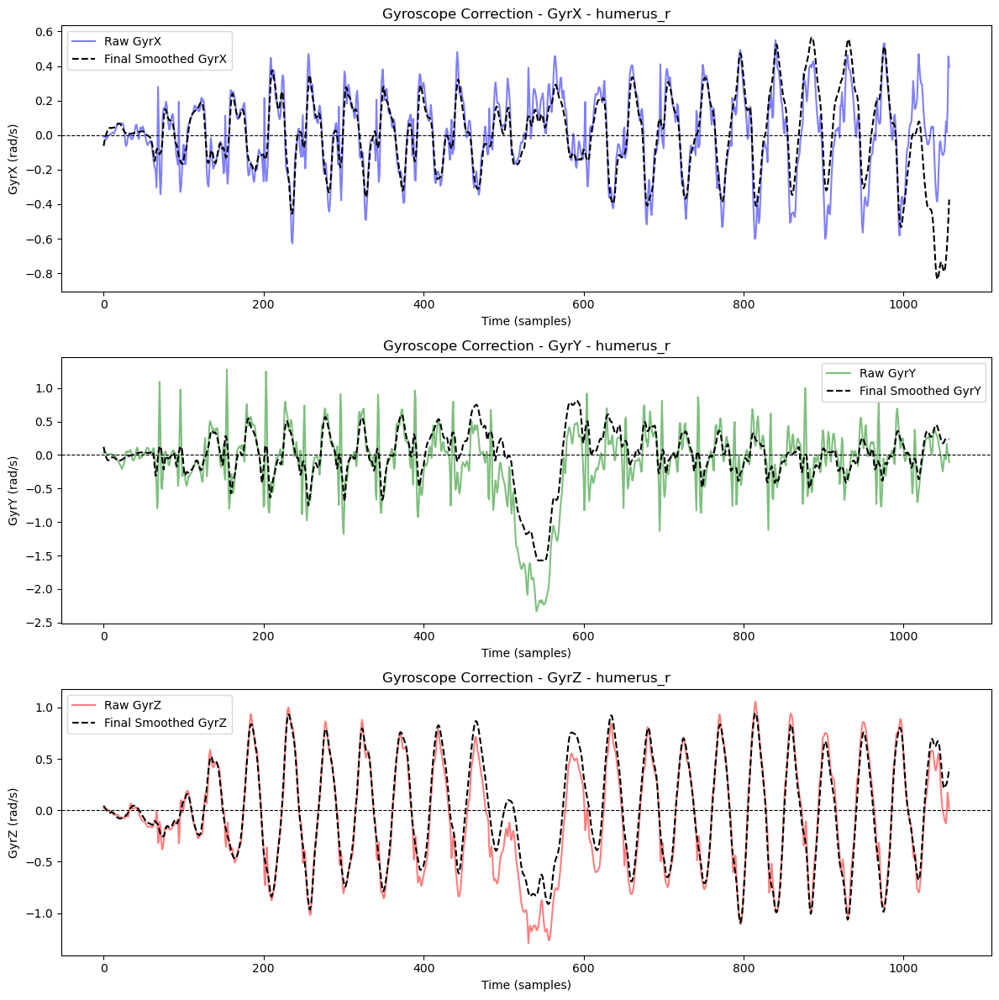

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_tibia_l.csv


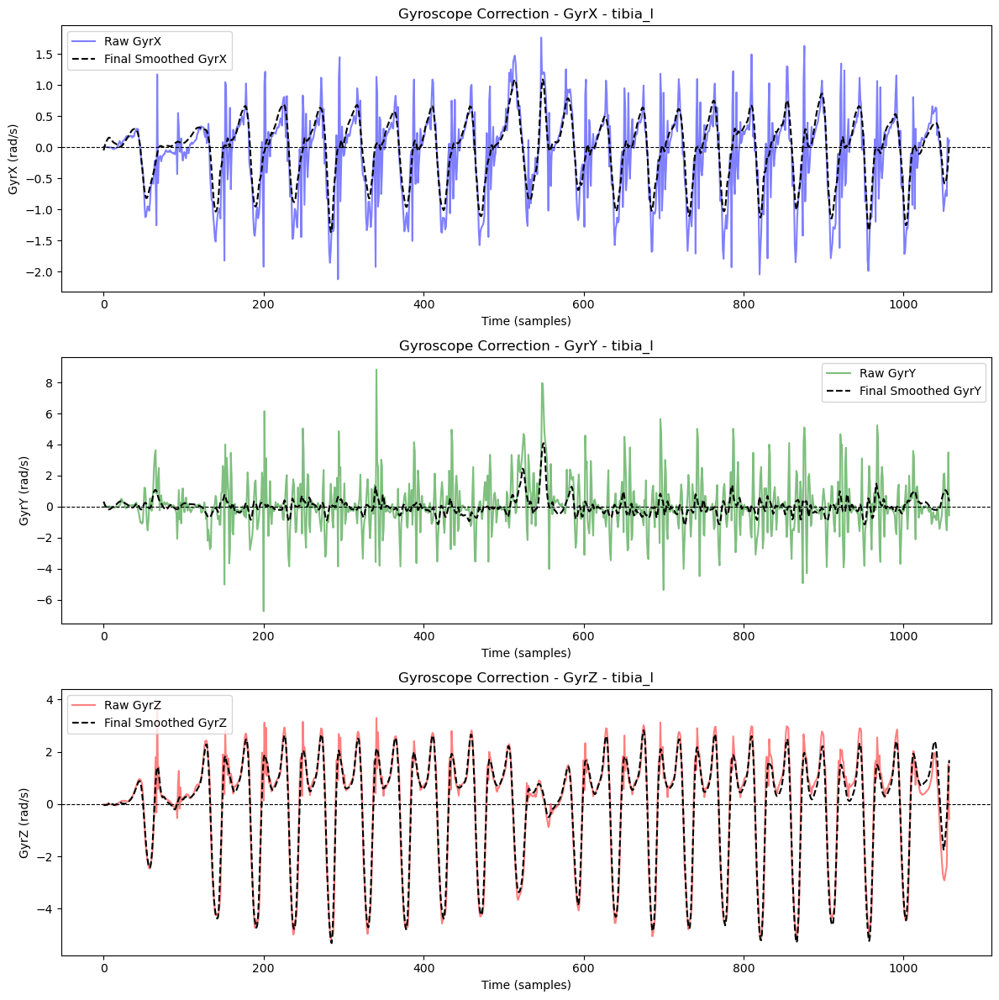

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_femur_l.csv


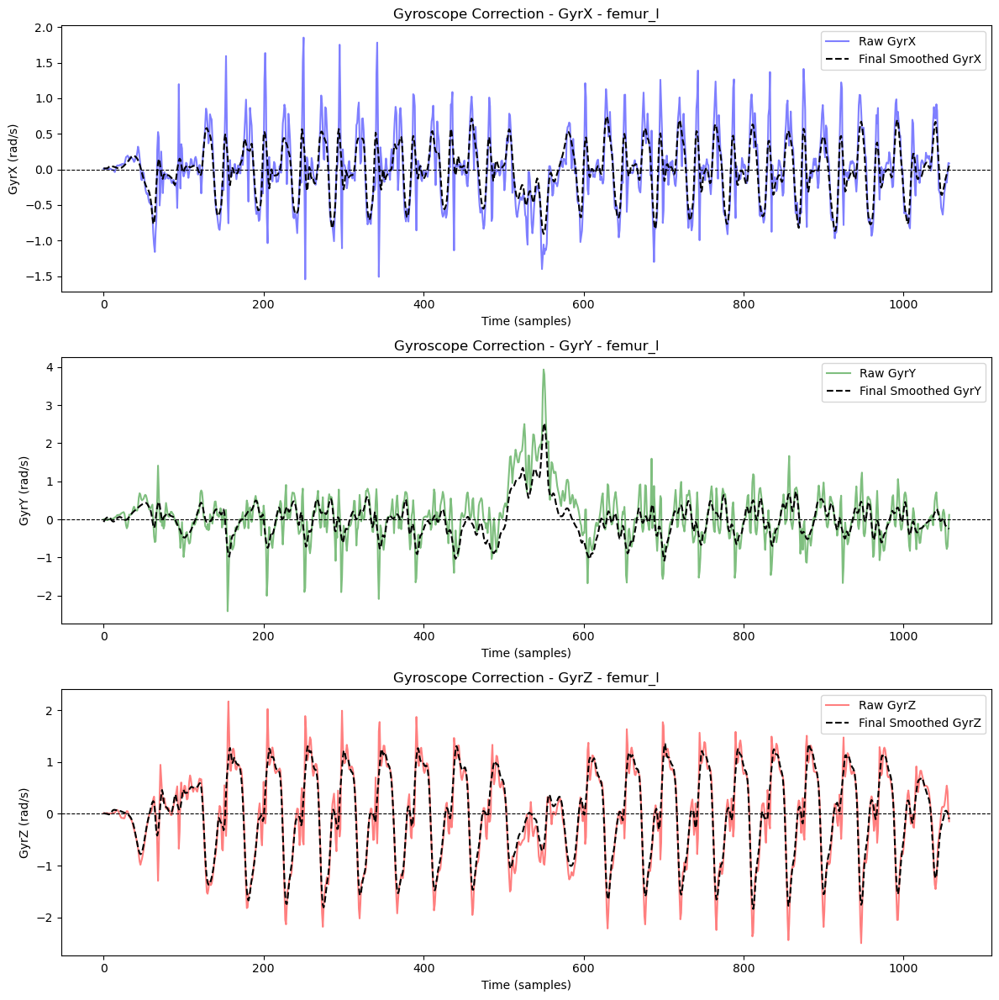

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_head.csv


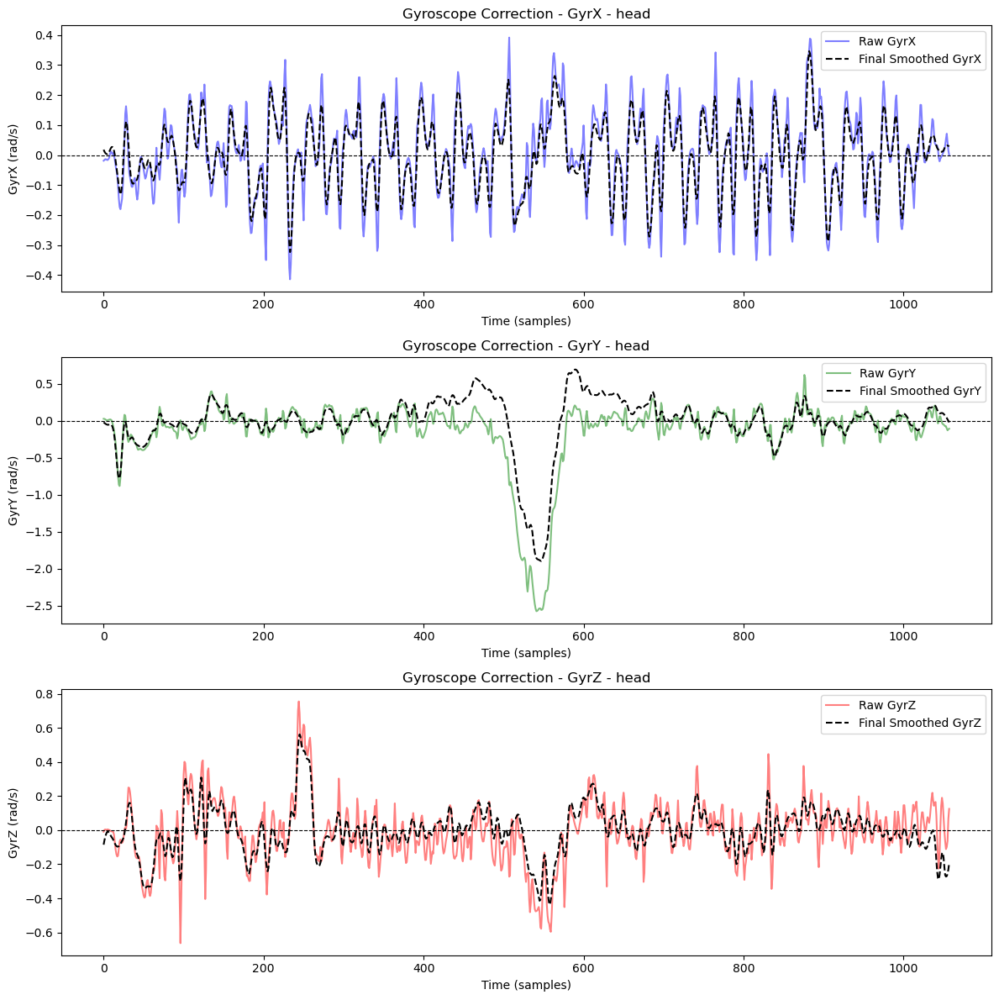

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_pelvis.csv


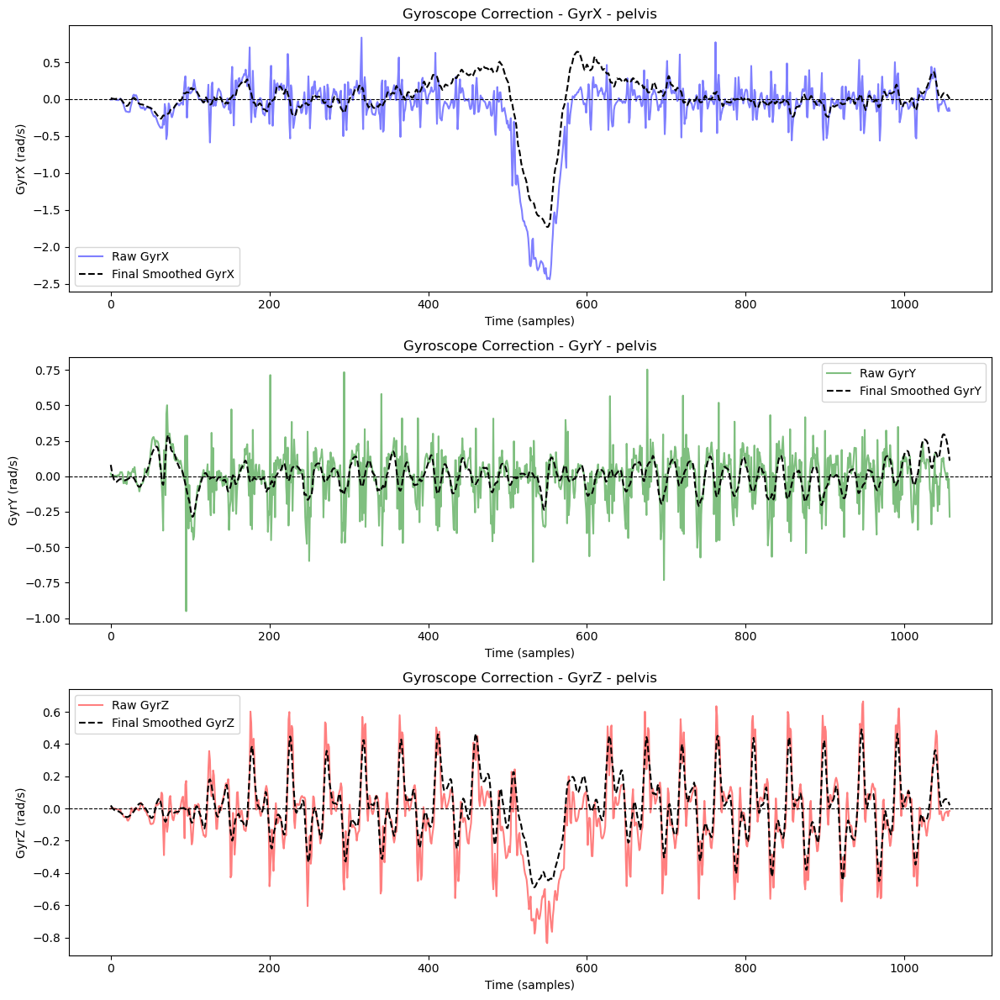

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_ulna_r.csv


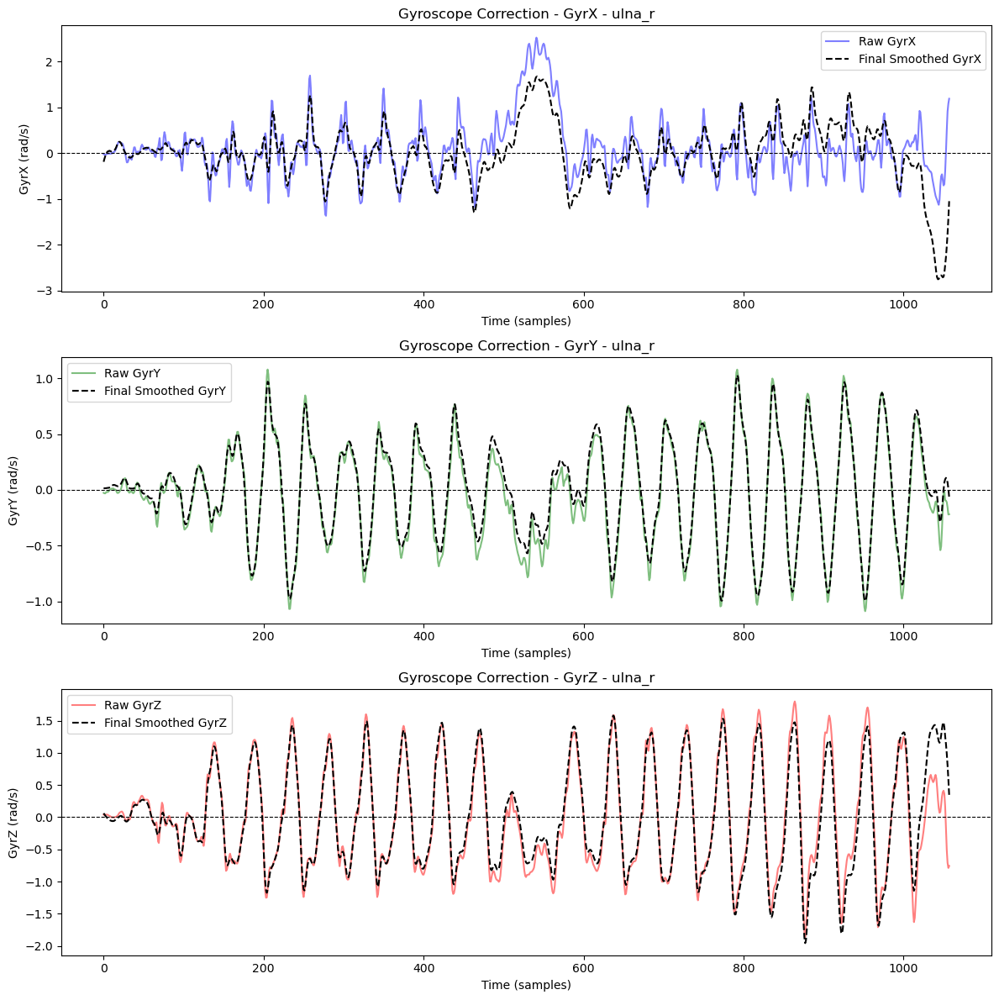

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_unknown.csv


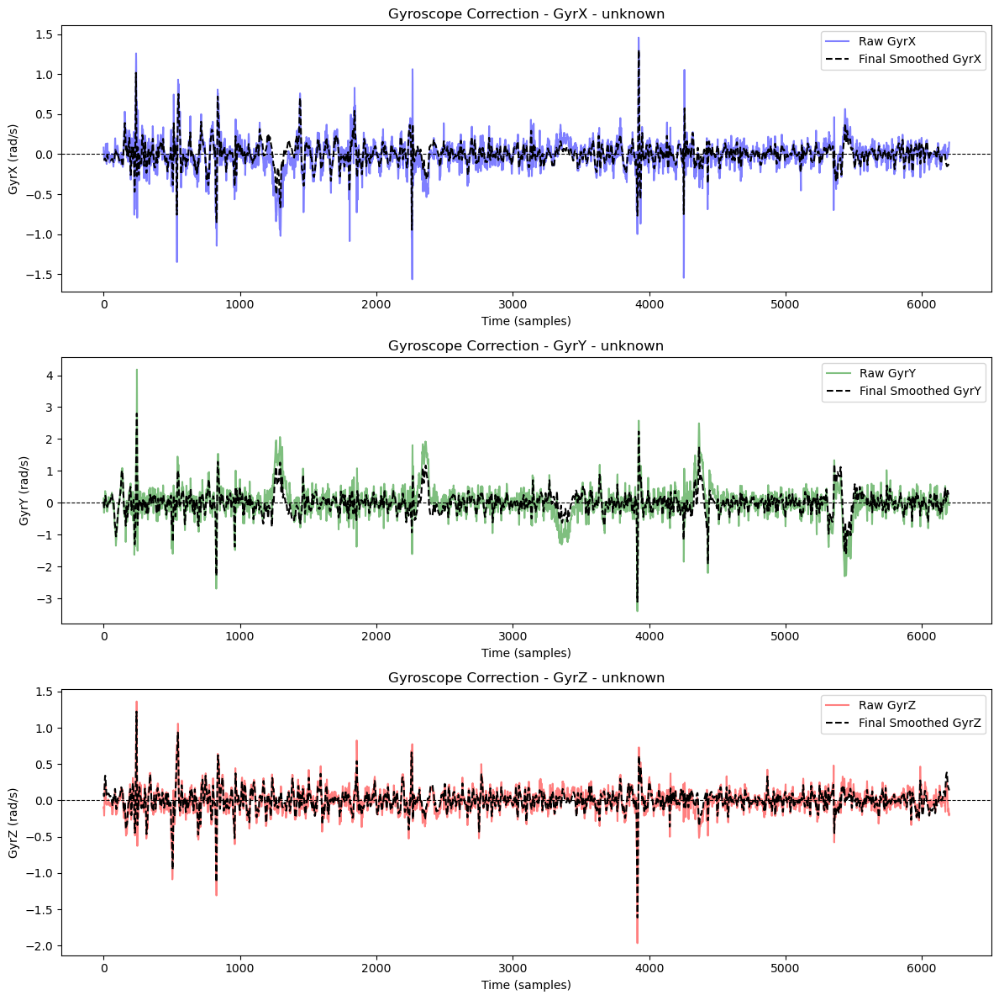

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_hand_r.csv


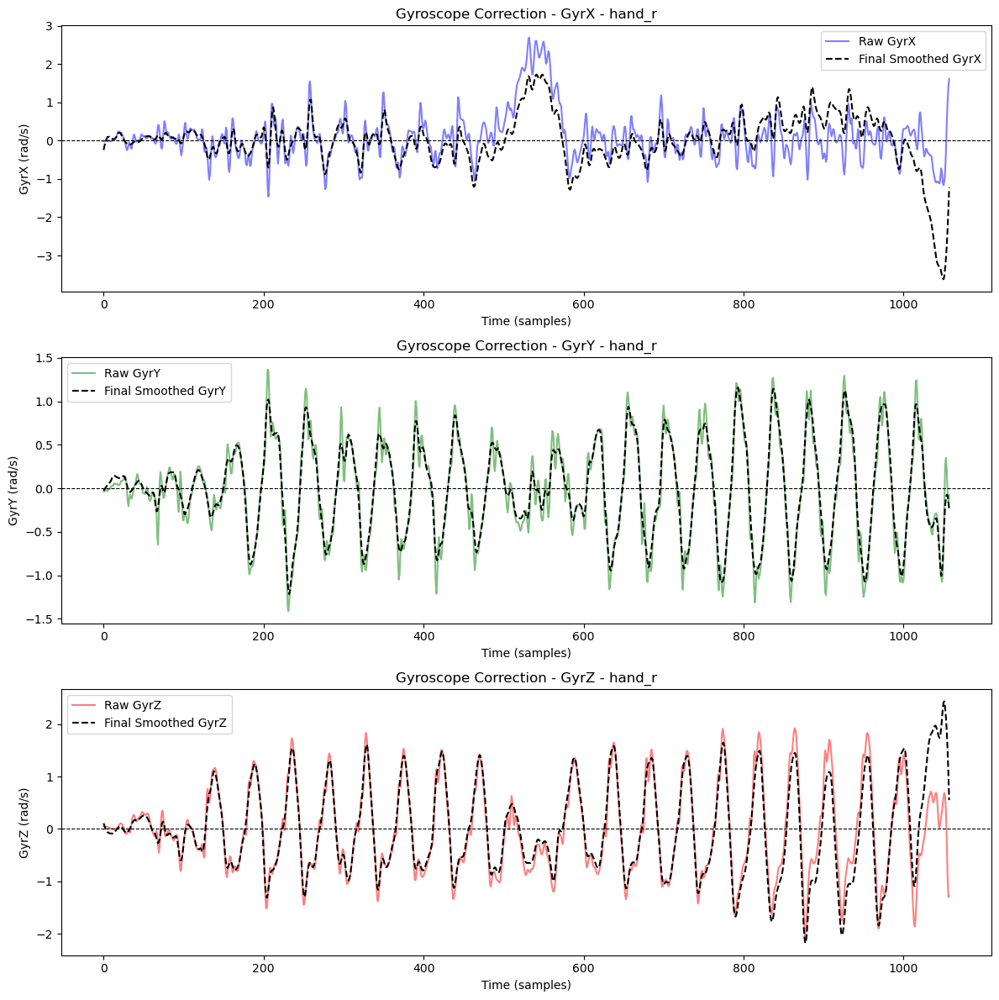

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_calcn_l.csv


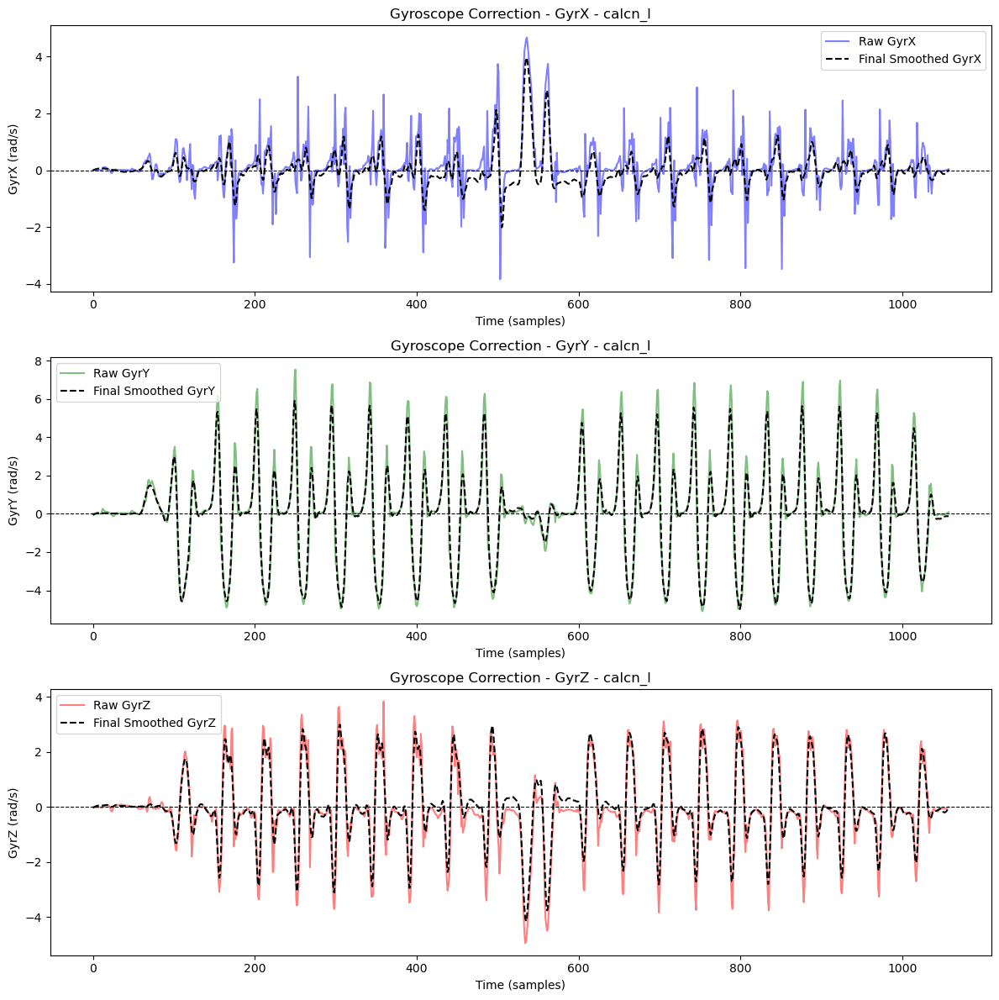

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_ulna_l.csv


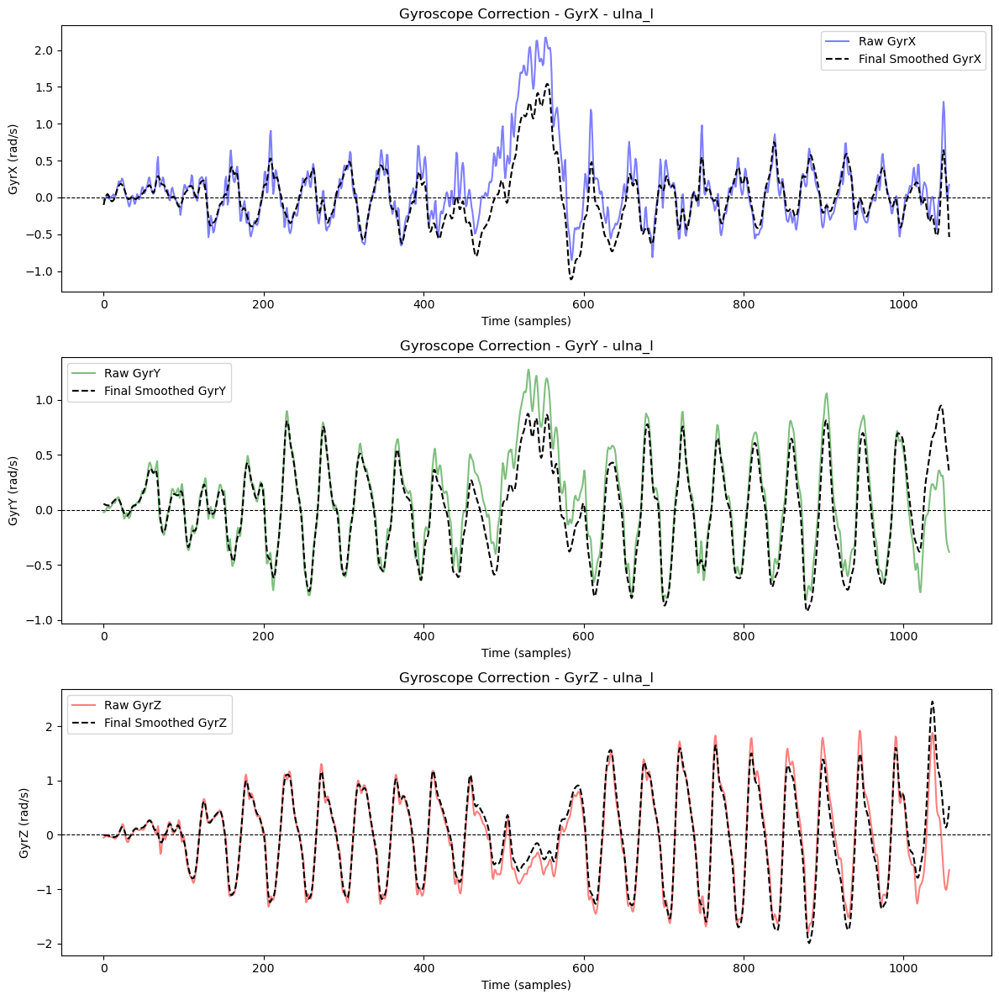

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_hand_l.csv


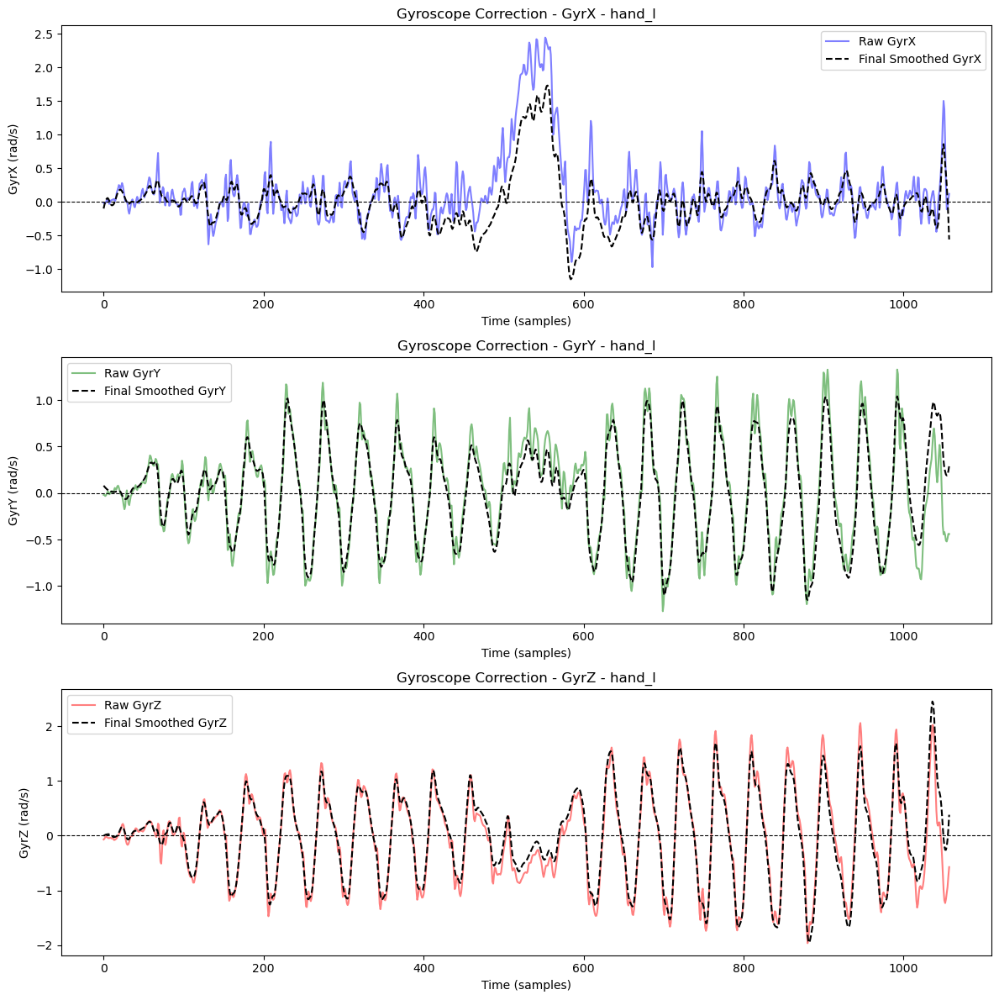

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_calcn_r.csv


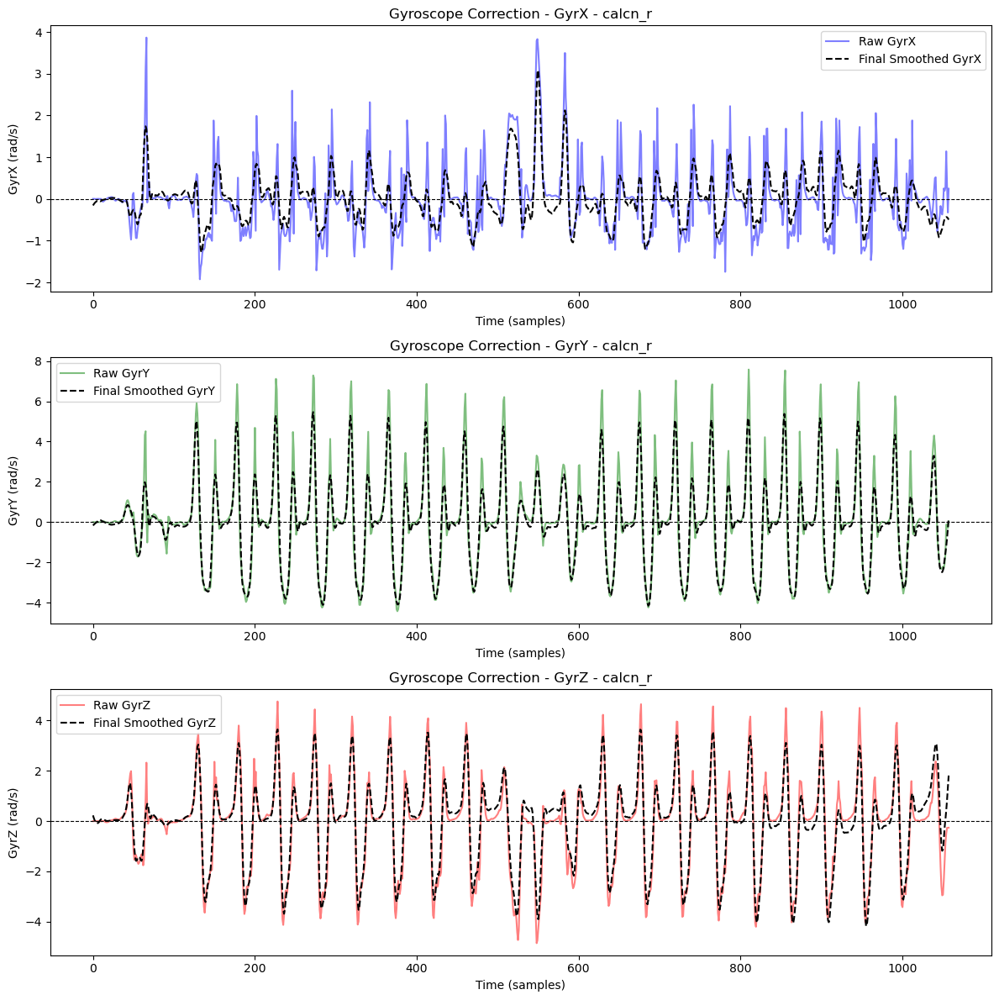

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_torso.csv


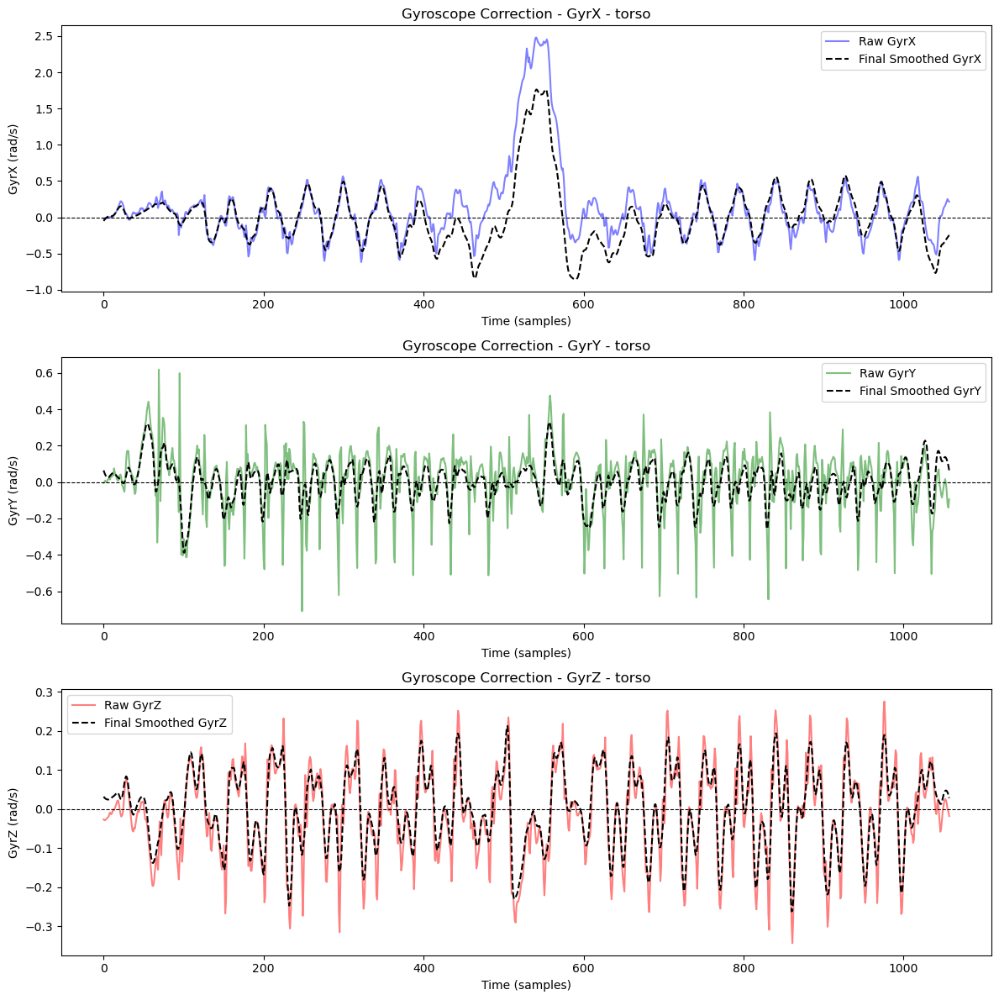

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_humerus_l.csv


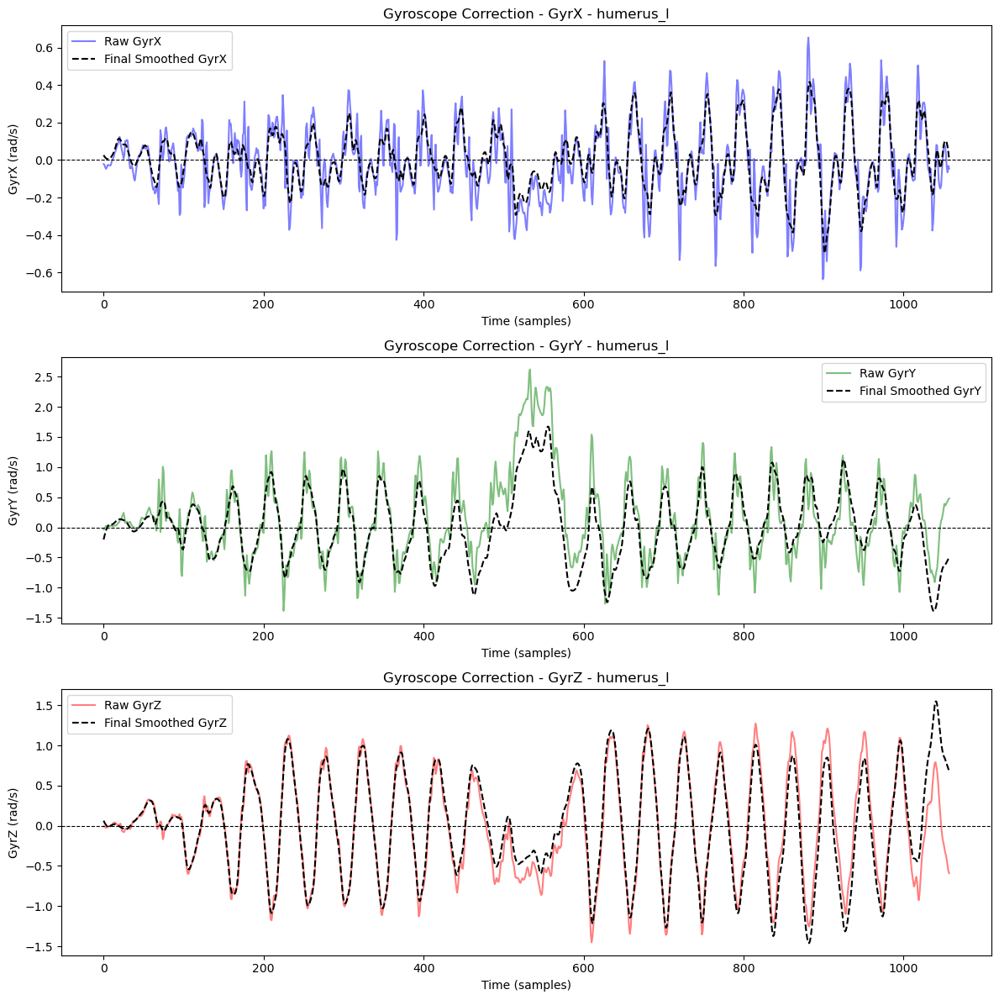

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_tibia_r.csv


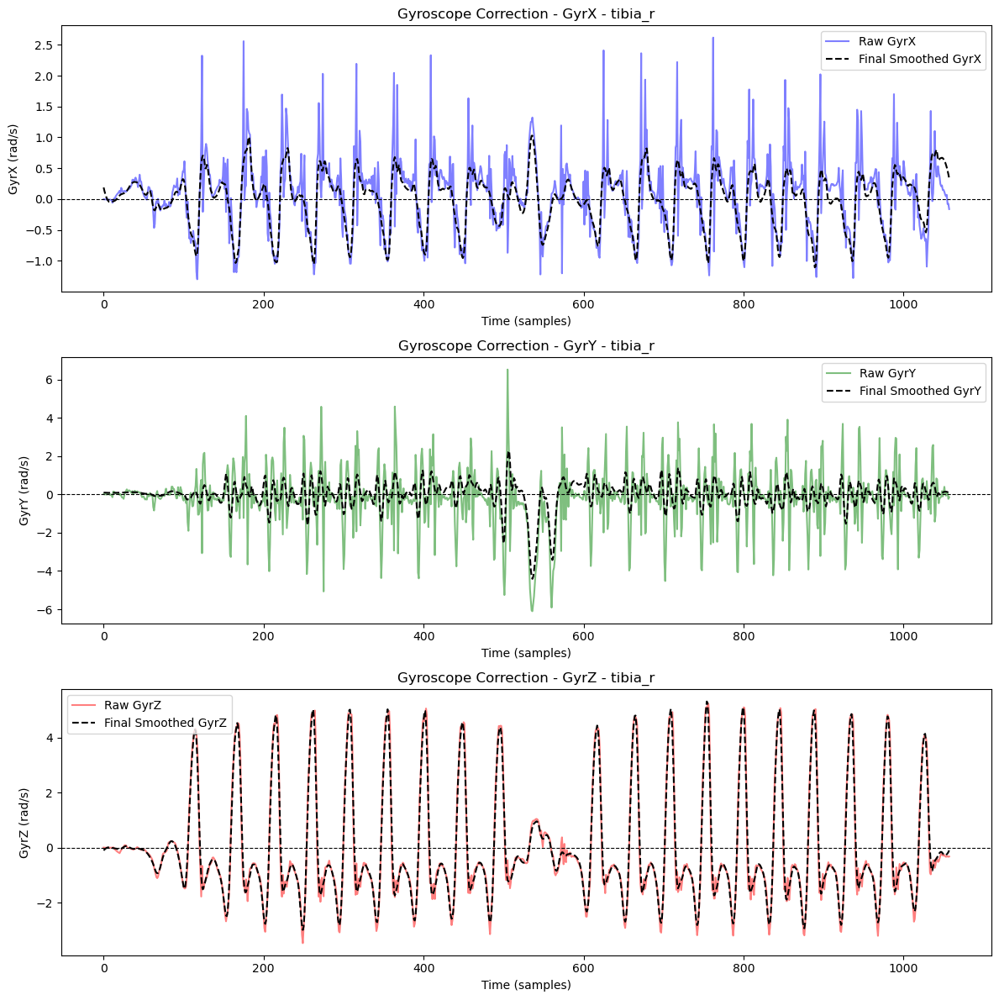

Processed gyroscope data saved: /Users/afonsoamaral/Desktop/data/final_corrected_gyroscope_data_femur_r.csv


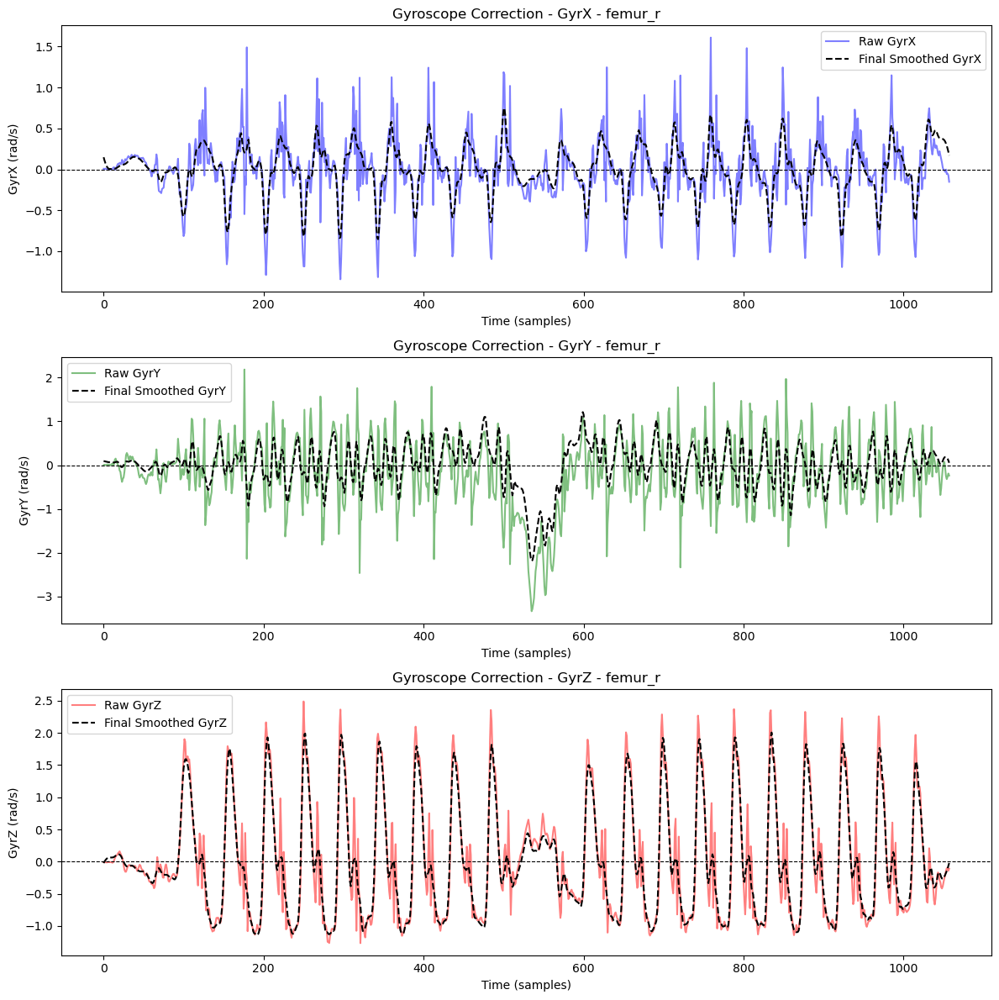

In [4]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, savgol_filter
import pywt
from pykalman import KalmanFilter

# Parameters 
data_dir = "/Users/afonsoamaral/Desktop/data"
converted_files = [f for f in os.listdir(data_dir) if f.startswith("cleaned_data_") and f.endswith(".csv")]
fs = 40  # Sampling frequency

# Processing Functions 
def band_pass_filter(data, low_cutoff=0.1, high_cutoff=10, fs=40, order=2):
    nyquist = 0.5 * fs
    low = low_cutoff / nyquist
    high = high_cutoff / nyquist
    b, a = butter(order, [low, high], btype='band', analog=False)
    return filtfilt(b, a, data)

def wavelet_denoise(data, wavelet="db4", level=1):
    coeffs = pywt.wavedec(data, wavelet, mode="per")
    sigma = np.median(np.abs(coeffs[-level])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(data)))
    coeffs[1:] = [pywt.threshold(c, threshold, mode="soft") for c in coeffs[1:]]
    return pywt.waverec(coeffs, wavelet, mode="per")[:len(data)]

def kalman_filter(data):
    kf = KalmanFilter(
        transition_matrices=[1],
        observation_matrices=[1],
        initial_state_mean=0,
        initial_state_covariance=1e-2,
        transition_covariance=1e-2,
        observation_covariance=5e-2
    )
    filtered_state_means, _ = kf.smooth(data)
    return filtered_state_means.flatten()

# Process each IMU file 
for file in converted_files:
    sensor_name = file.replace("cleaned_data_", "").replace(".csv", "")
    file_path = os.path.join(data_dir, file)
    df = pd.read_csv(file_path)

    gyro_columns = ["GyrX", "GyrY", "GyrZ"]

    for axis in gyro_columns:
        df[axis + "_filtered"] = band_pass_filter(df[axis], fs=fs)
        df[axis + "_denoised"] = wavelet_denoise(df[axis + "_filtered"])
        df[axis + "_smoothed"] = savgol_filter(df[axis + "_denoised"], window_length=11, polyorder=2)

    # Save processed file
    output_file = os.path.join(data_dir, f"final_corrected_gyroscope_data_{sensor_name}.csv")
    df.to_csv(output_file, index=False)
    print(f"Processed gyroscope data saved: {output_file}")

    # Plot Results
    fig, axes = plt.subplots(3, 1, figsize=(12, 12))
    colors = {"GyrX": "blue", "GyrY": "green", "GyrZ": "red"}

    for i, axis in enumerate(gyro_columns):
        smoothed_axis = axis + "_smoothed"
        axes[i].plot(df.index, df[axis], label=f"Raw {axis}", color=colors[axis], alpha=0.5)
        axes[i].plot(df.index, df[smoothed_axis], label=f"Final Smoothed {axis}", linestyle="dashed", color="black")
        axes[i].axhline(y=0, color='black', linestyle='--', linewidth=0.8)
        axes[i].set_xlabel("Time (samples)")
        axes[i].set_ylabel(f"{axis} (rad/s)")
        axes[i].set_title(f"Gyroscope Correction - {axis} - {sensor_name}")
        axes[i].legend()

    plt.tight_layout()
    plt.show()

# ACCELEROMETER

## Processing Pipeline

Processing accelerometer (no gravity removal) for sensor: humerus_r
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_humerus_r.csv


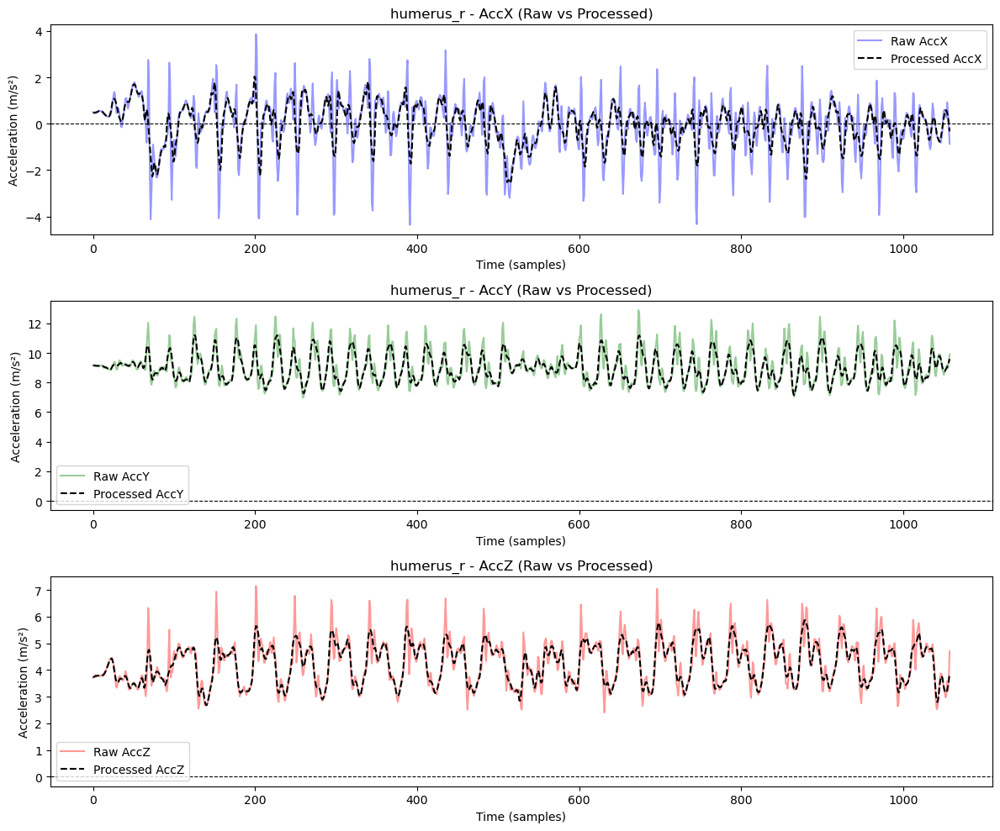

Processing accelerometer (no gravity removal) for sensor: tibia_l
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_tibia_l.csv


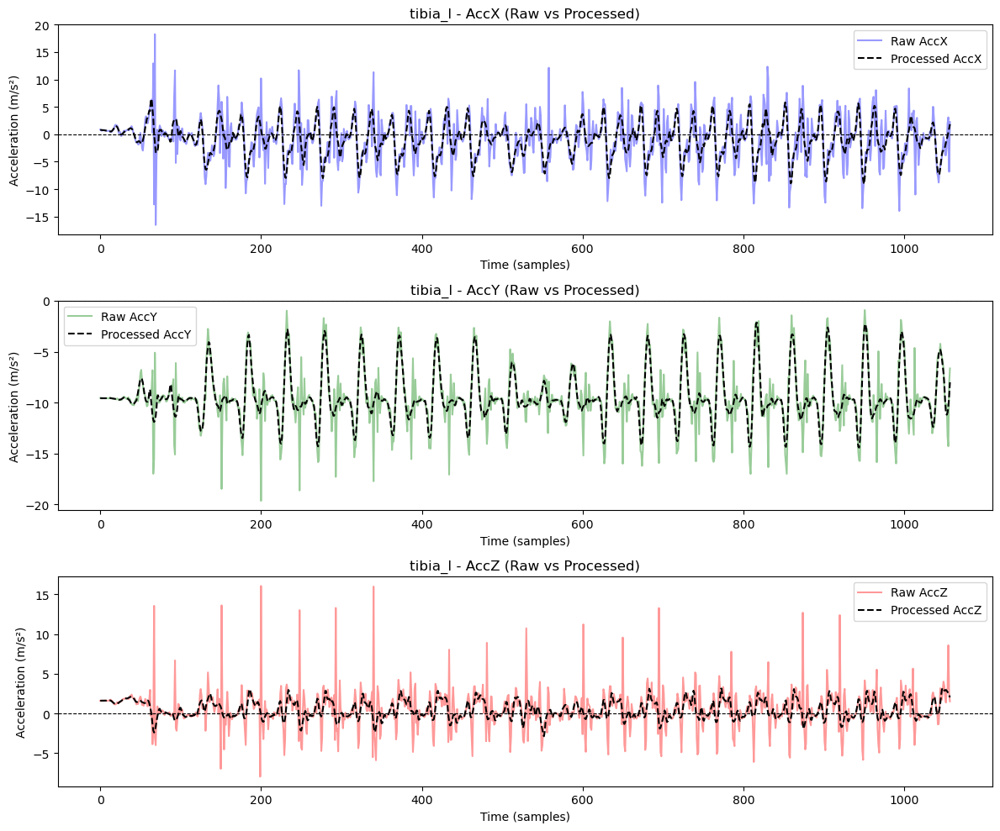

Processing accelerometer (no gravity removal) for sensor: femur_l
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_femur_l.csv


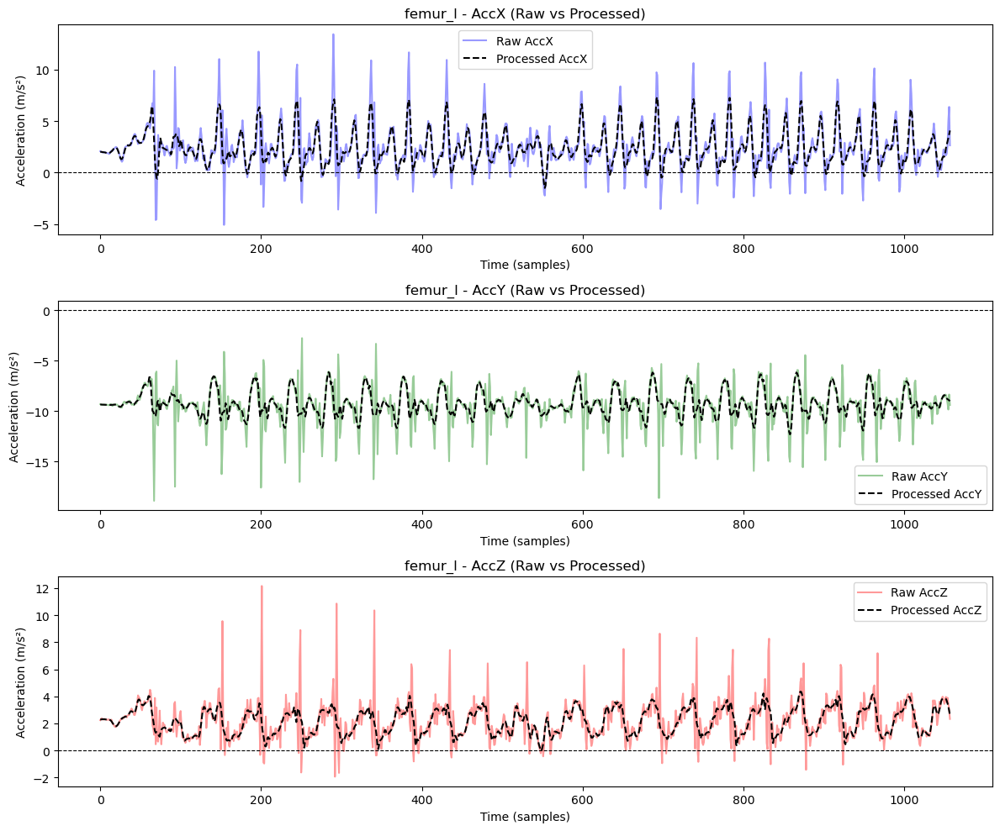

Processing accelerometer (no gravity removal) for sensor: head
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_head.csv


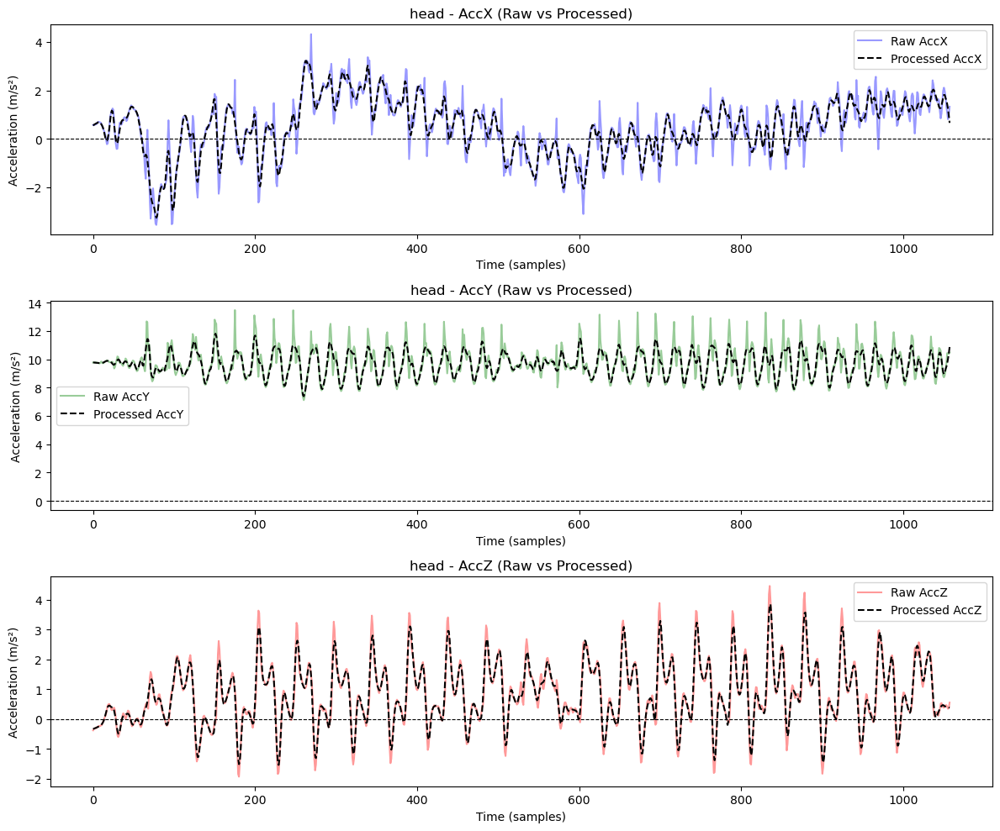

Processing accelerometer (no gravity removal) for sensor: pelvis
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_pelvis.csv


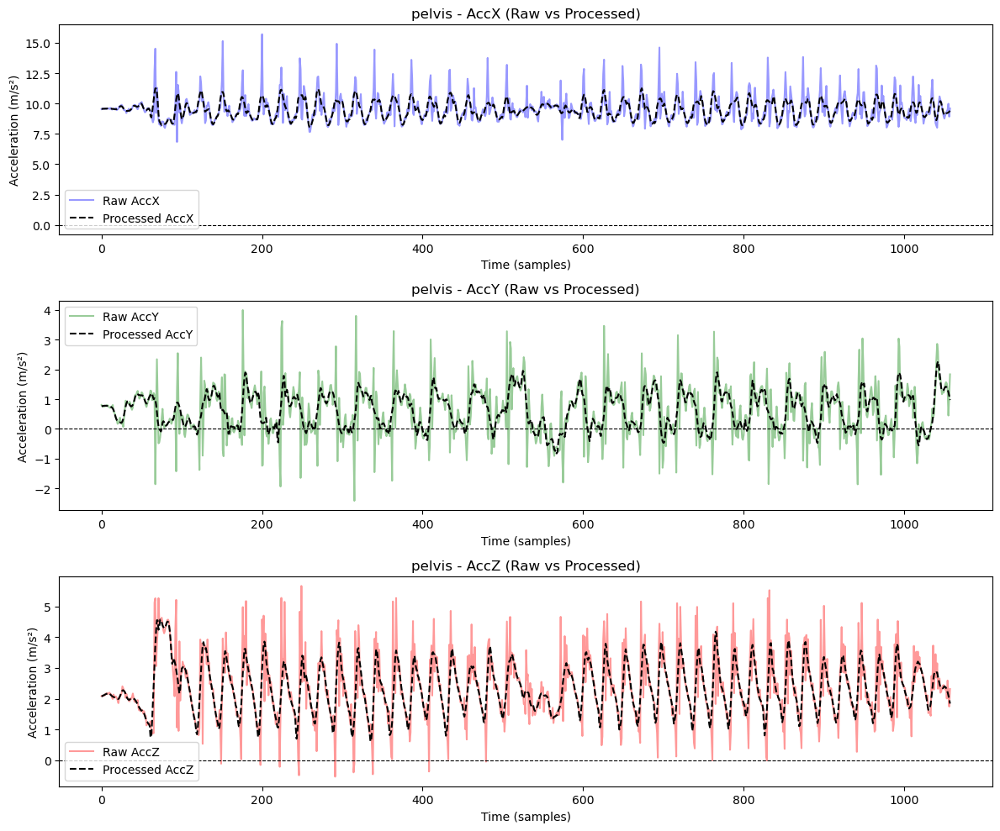

Processing accelerometer (no gravity removal) for sensor: ulna_r
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_ulna_r.csv


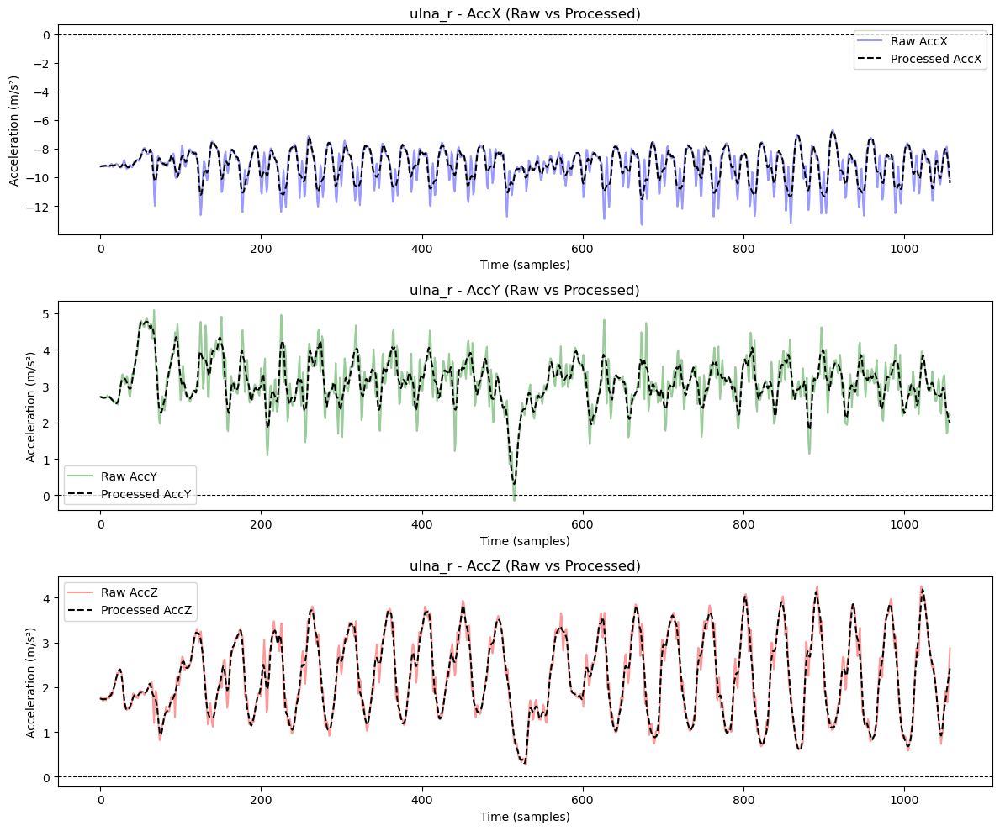

Processing accelerometer (no gravity removal) for sensor: unknown
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_unknown.csv


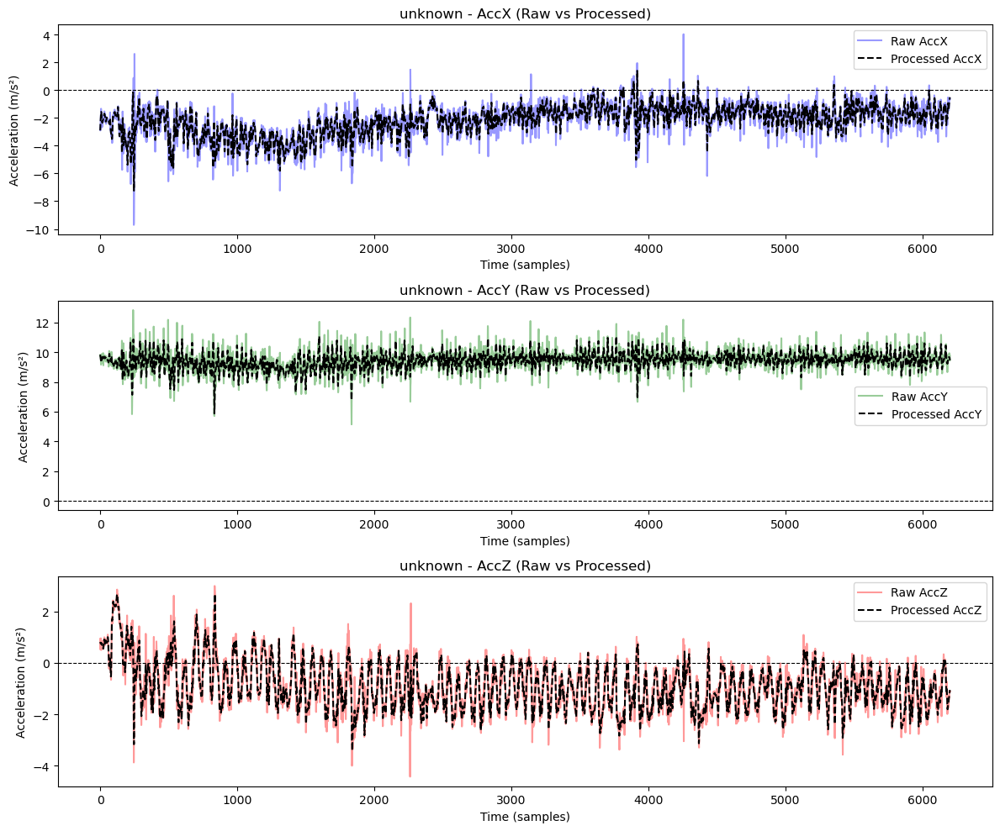

Processing accelerometer (no gravity removal) for sensor: hand_r
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_hand_r.csv


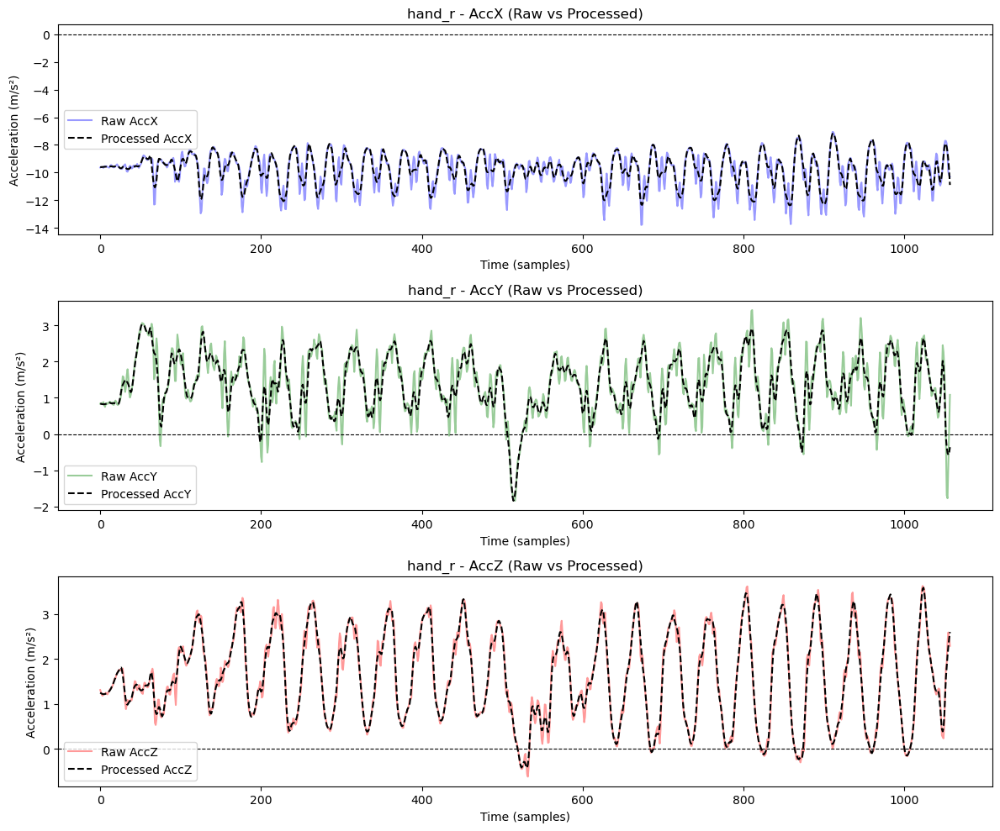

Processing accelerometer (no gravity removal) for sensor: calcn_l
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_calcn_l.csv


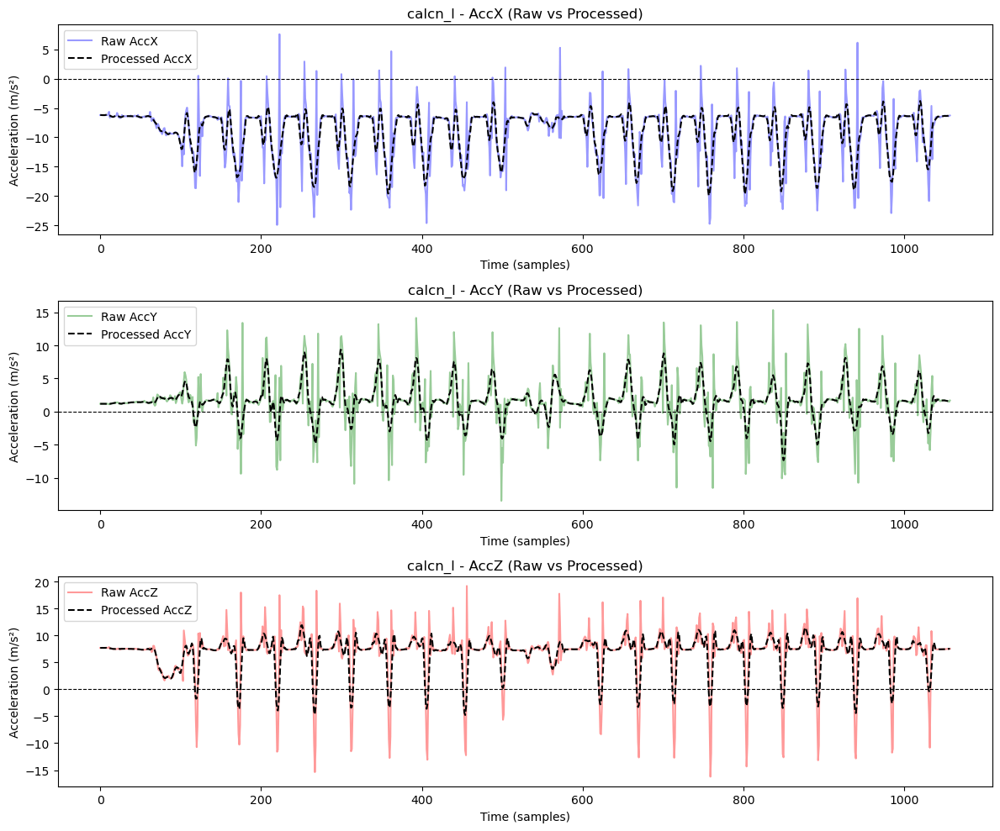

Processing accelerometer (no gravity removal) for sensor: ulna_l
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_ulna_l.csv


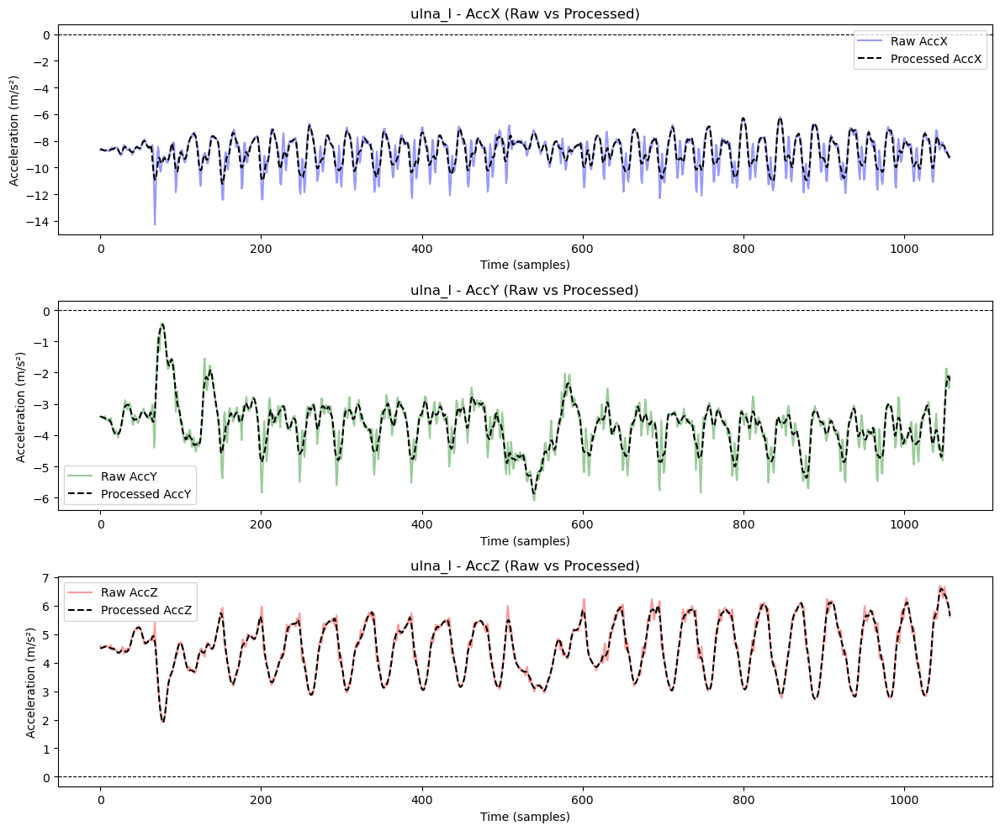

Processing accelerometer (no gravity removal) for sensor: hand_l
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_hand_l.csv


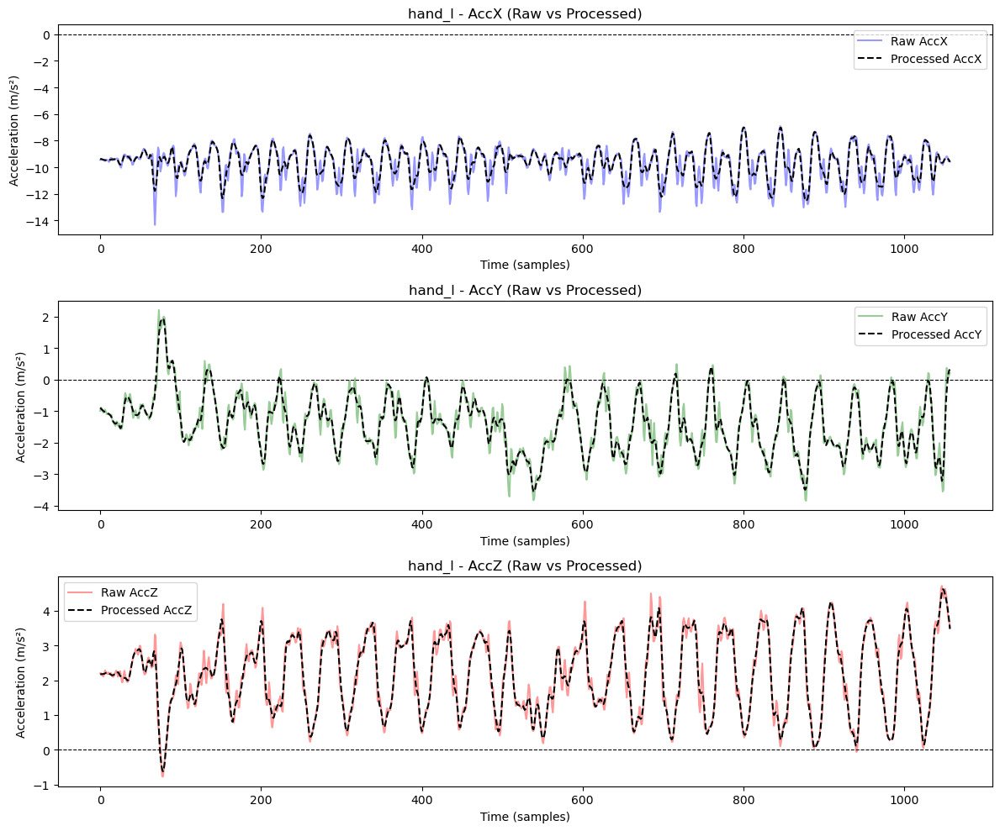

Processing accelerometer (no gravity removal) for sensor: calcn_r
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_calcn_r.csv


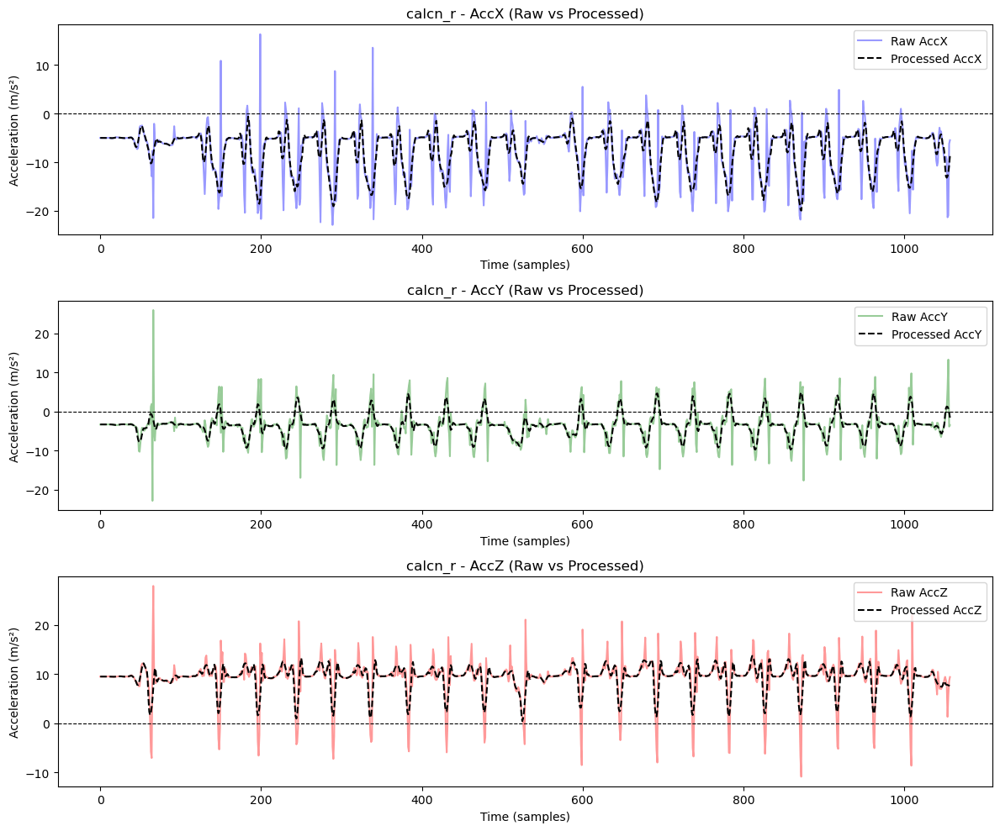

Processing accelerometer (no gravity removal) for sensor: torso
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_torso.csv


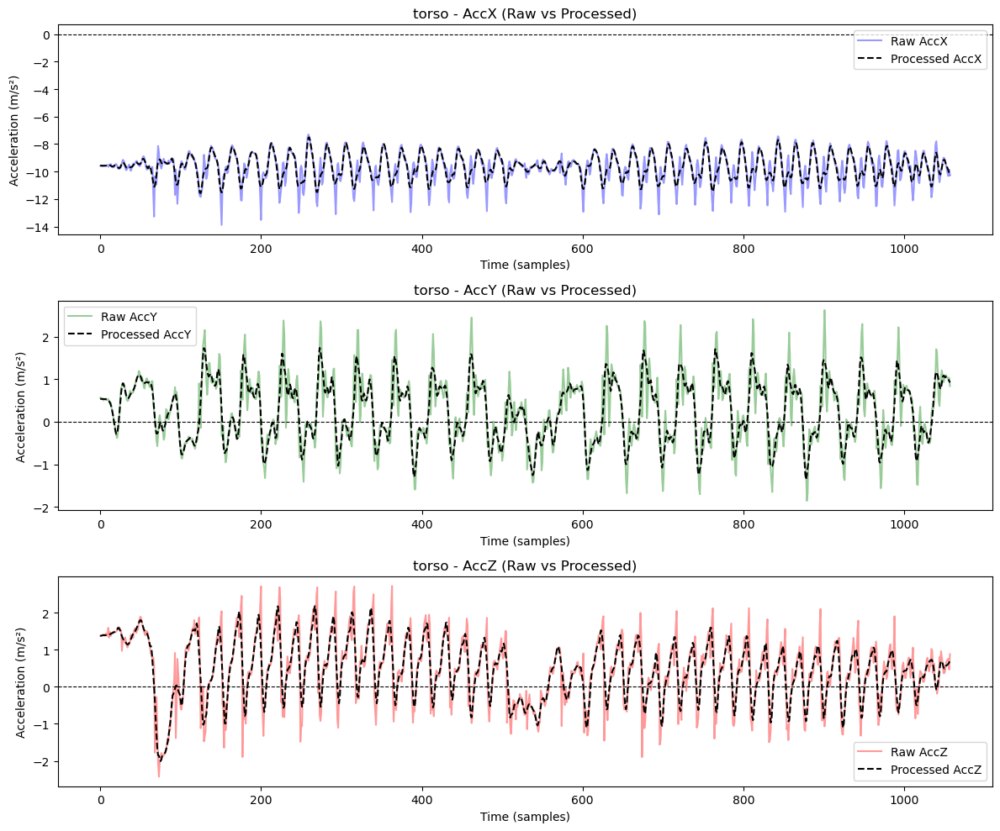

Processing accelerometer (no gravity removal) for sensor: humerus_l
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_humerus_l.csv


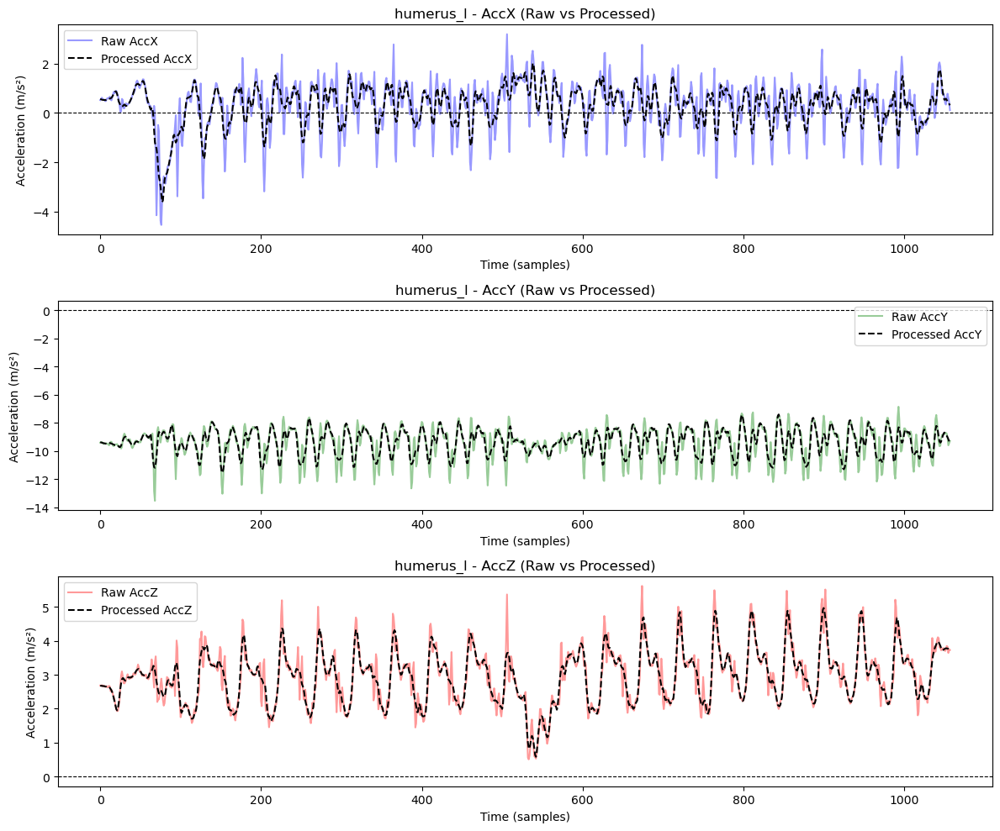

Processing accelerometer (no gravity removal) for sensor: tibia_r
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_tibia_r.csv


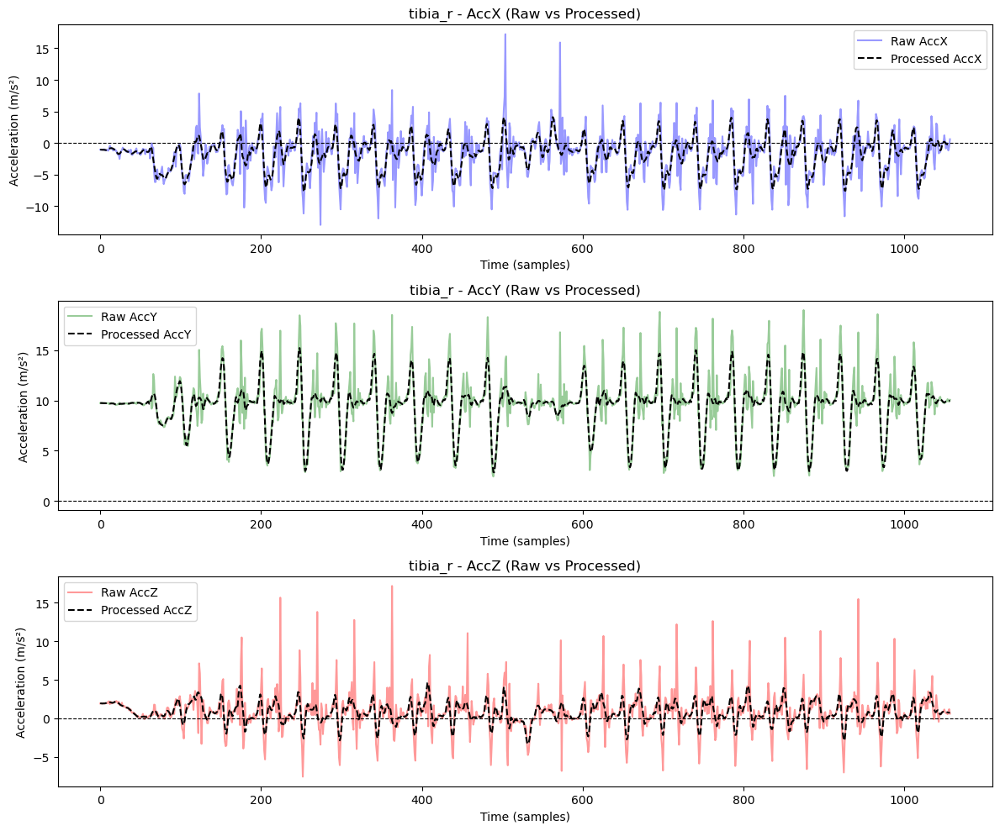

Processing accelerometer (no gravity removal) for sensor: femur_r
Saved final corrected accelerometer data: /Users/afonsoamaral/Desktop/data/final_corrected_accelerometer_data_femur_r.csv


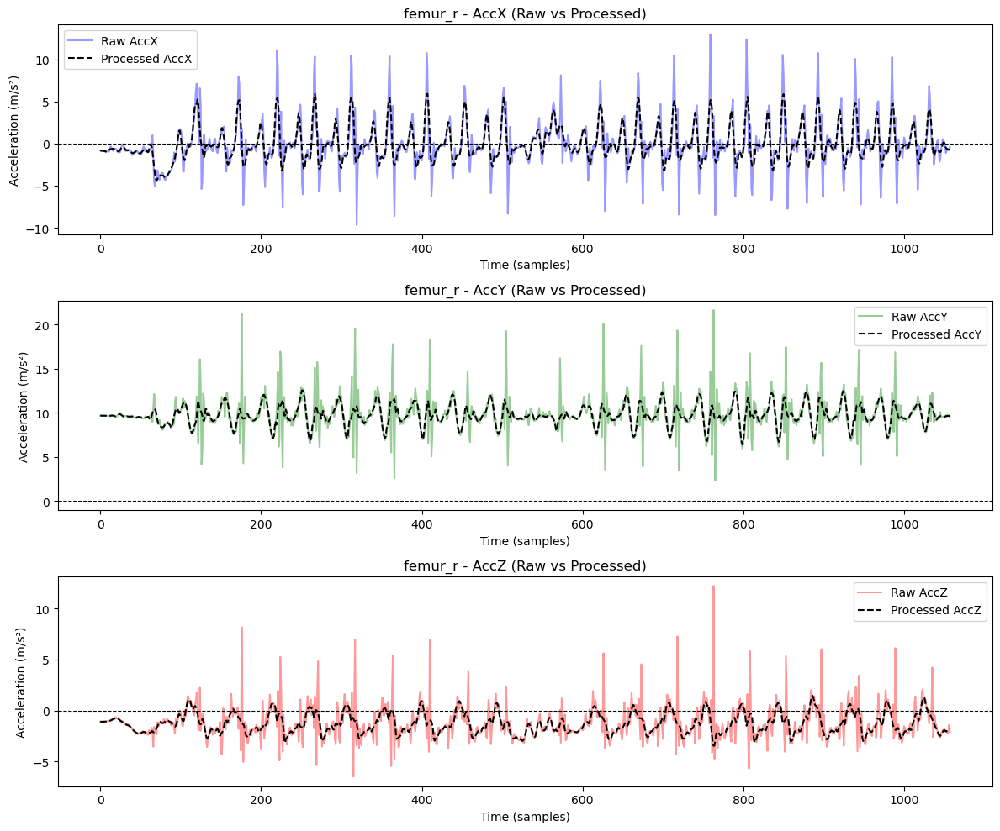

In [5]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, savgol_filter, medfilt

# Parameters
data_dir = "/Users/afonsoamaral/Desktop/data"
fs = 40  # Sampling frequency in Hz

# Filtering & Smoothing Functions (No Gravity Removal) 

def butter_lowpass_filter(data, fs, cutoff=18, order=2):
    nyq = 0.5 * fs # Nyquist frequency (half the sampling rate)
    norm_cutoff = cutoff / nyq # Normalize the cutoff
    b, a = butter(order, norm_cutoff, btype='low') # Design Butterworth filter
    return filtfilt(b, a, data, axis=0)  # Apply zero-phase filtering

def median_filter(data, kernel_size=3):
    filtered = np.empty_like(data)
    for i in range(data.shape[1]):
        filtered[:, i] = medfilt(data[:, i], kernel_size=kernel_size) # Median filter on each axis
    return filtered

def savgol_smooth(data, window_length=11, polyorder=2):
    smoothed = np.empty_like(data)
    for i in range(data.shape[1]):
        smoothed[:, i] = savgol_filter(data[:, i], window_length=window_length, polyorder=polyorder)
    return smoothed

# Main Processing Loop 

converted_files = [f for f in os.listdir(data_dir) if f.startswith("cleaned_data") and f.endswith(".csv")]

for file in converted_files:
    sensor_name = file.replace("cleaned_data_", "").replace(".csv", "")
    file_path = os.path.join(data_dir, file)
    df = pd.read_csv(file_path)

    print(f"Processing accelerometer (no gravity removal) for sensor: {sensor_name}")

    # Step 1: Median Filter
    accel_data = df[["AccX", "AccY", "AccZ"]].values
    accel_median_filtered = median_filter(accel_data, kernel_size=3)

    # Step 2: Low-pass Filter
    accel_filtered = butter_lowpass_filter(accel_median_filtered, fs=fs)

    # Step 3: Savitzky-Golay smoothing
    accel_smoothed = savgol_smooth(accel_filtered, window_length=11, polyorder=2)

    # Step 4: Save Final Processed File
    df[["AccX_processed", "AccY_processed", "AccZ_processed"]] = accel_smoothed
    out_path = os.path.join(data_dir, f"final_corrected_accelerometer_data_{sensor_name}.csv")
    df.to_csv(out_path, index=False)
    print(f"Saved final corrected accelerometer data: {out_path}")

    # Step 5: Plot Comparison
    fig, axes = plt.subplots(3, 1, figsize=(12, 10))
    colors = {"AccX": "blue", "AccY": "green", "AccZ": "red"}

    for i, axis in enumerate(["AccX", "AccY", "AccZ"]):
        corrected_axis = axis + "_processed"
        axes[i].plot(df.index, df[axis], label=f"Raw {axis}", color=colors[axis], alpha=0.4)
        axes[i].plot(df.index, df[corrected_axis], label=f"Processed {axis}", color="black", linestyle="--")
        axes[i].set_xlabel("Time (samples)")
        axes[i].set_ylabel("Acceleration (m/s²)")
        axes[i].set_title(f"{sensor_name} - {axis} (Raw vs Processed)")
        axes[i].legend()
        axes[i].axhline(0, color='black', linestyle='--', linewidth=0.8)

    plt.tight_layout()
    plt.show()

# MAGNETOMETER

## Processing pipeline


 Processing: humerus_r
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_humerus_r.csv


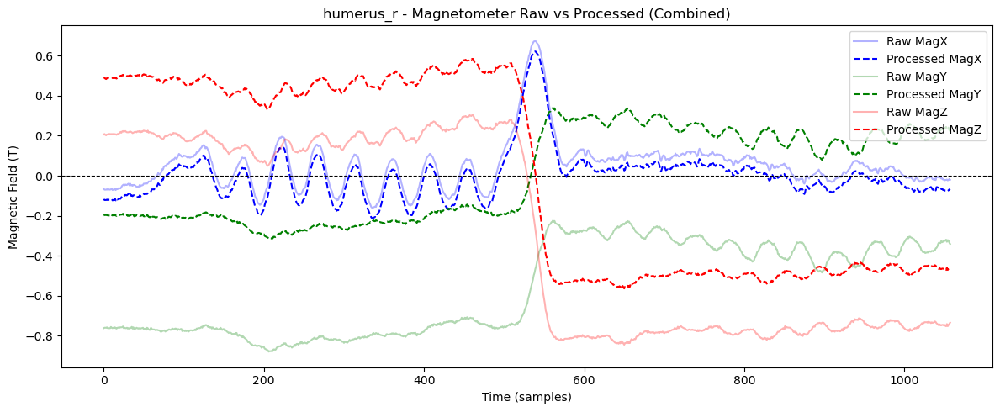


 Processing: tibia_l
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_tibia_l.csv


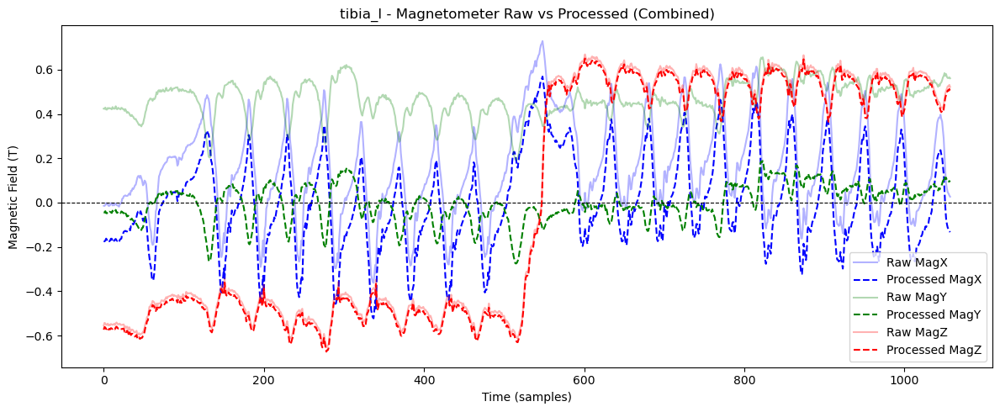


 Processing: femur_l
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_femur_l.csv


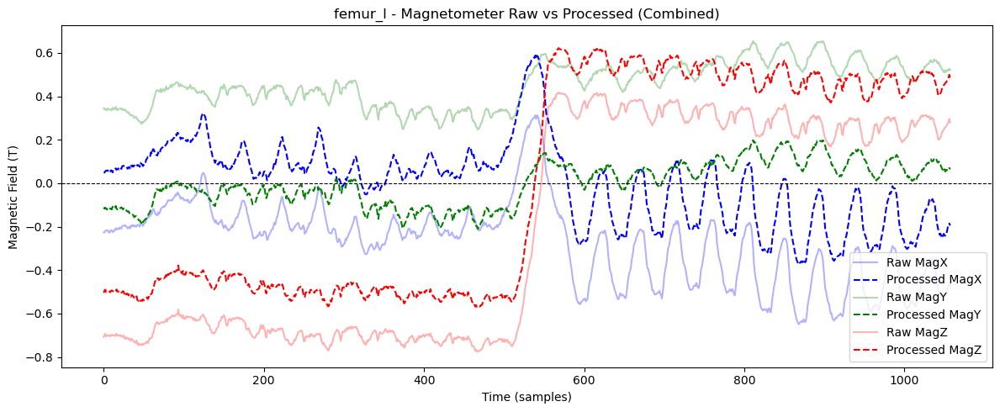


 Processing: head
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_head.csv


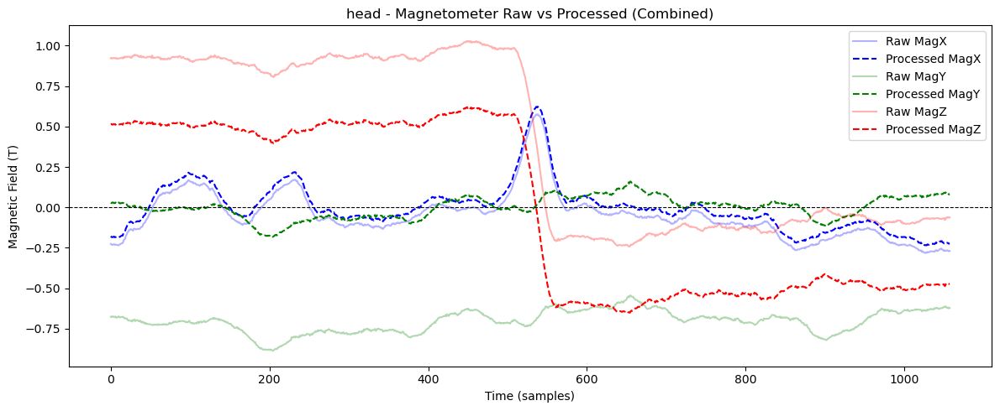


 Processing: pelvis
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_pelvis.csv


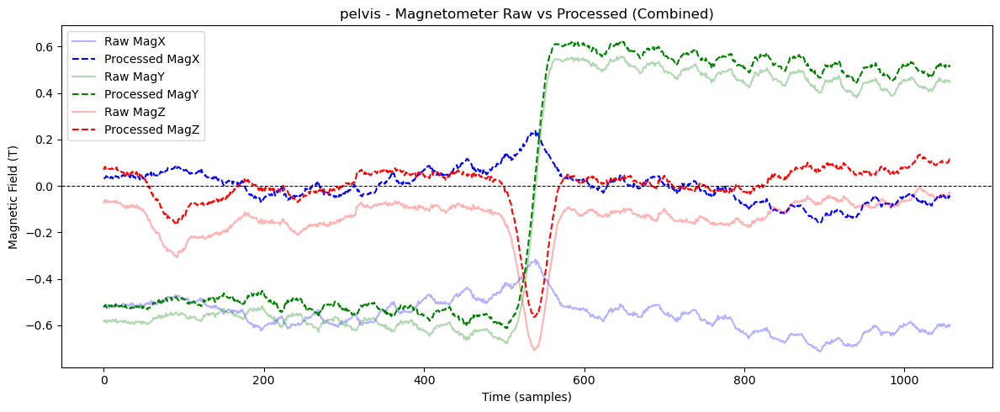


 Processing: ulna_r
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_ulna_r.csv


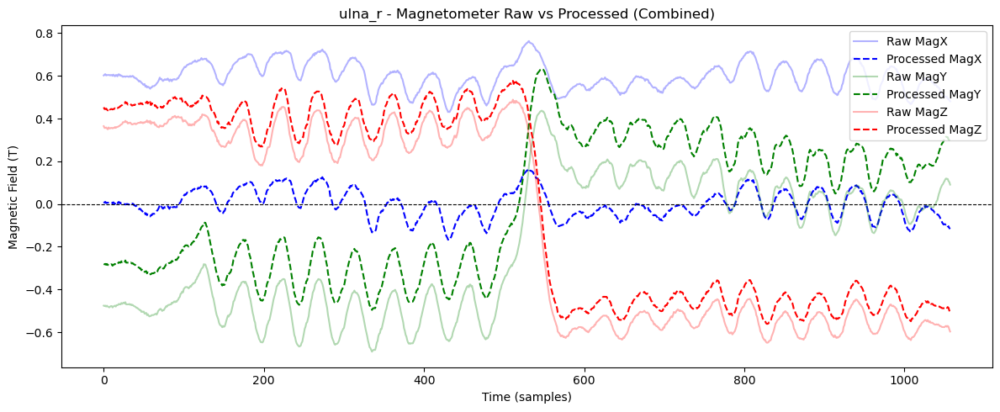


 Processing: unknown
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_unknown.csv


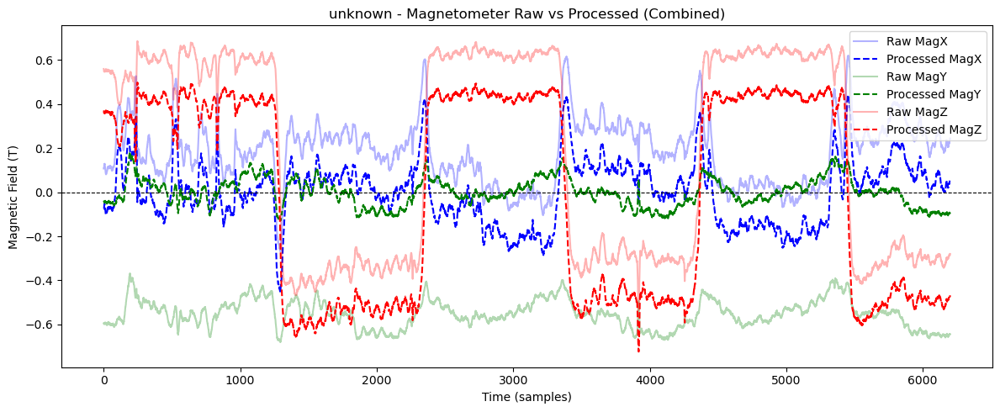


 Processing: hand_r
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_hand_r.csv


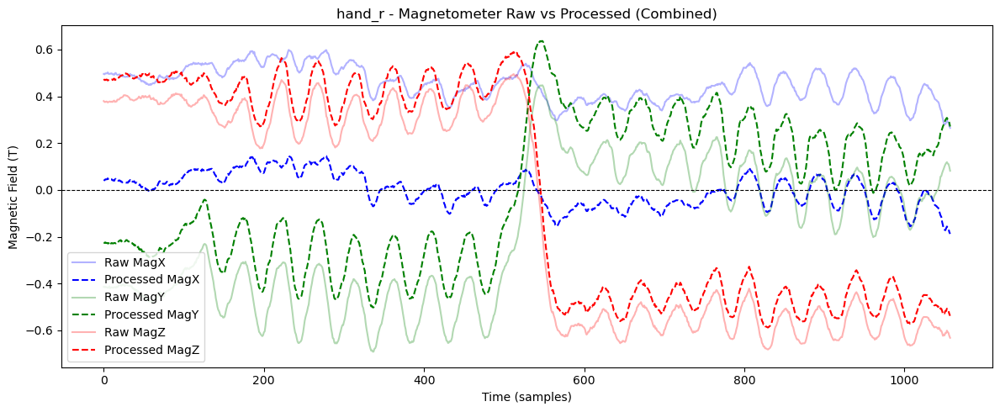


 Processing: calcn_l
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_calcn_l.csv


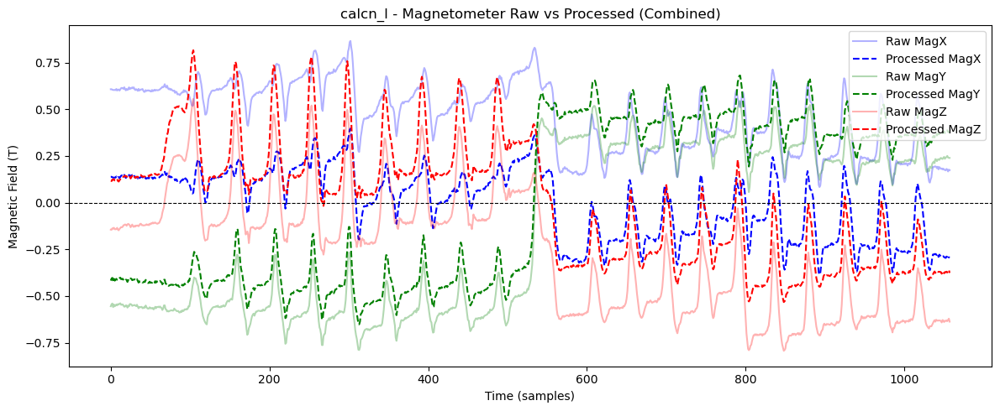


 Processing: ulna_l
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_ulna_l.csv


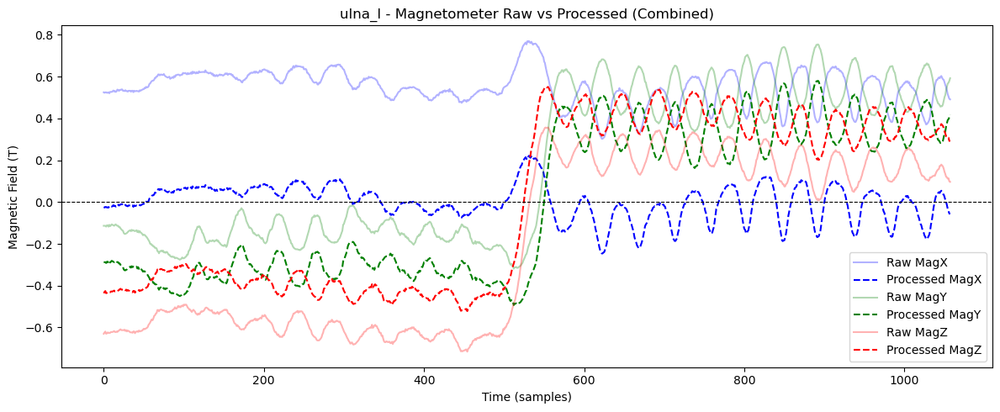


 Processing: hand_l
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_hand_l.csv


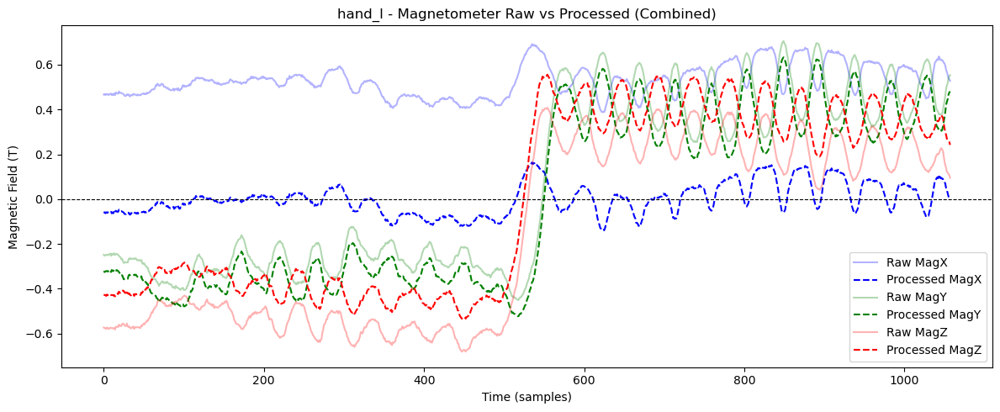


 Processing: calcn_r
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_calcn_r.csv


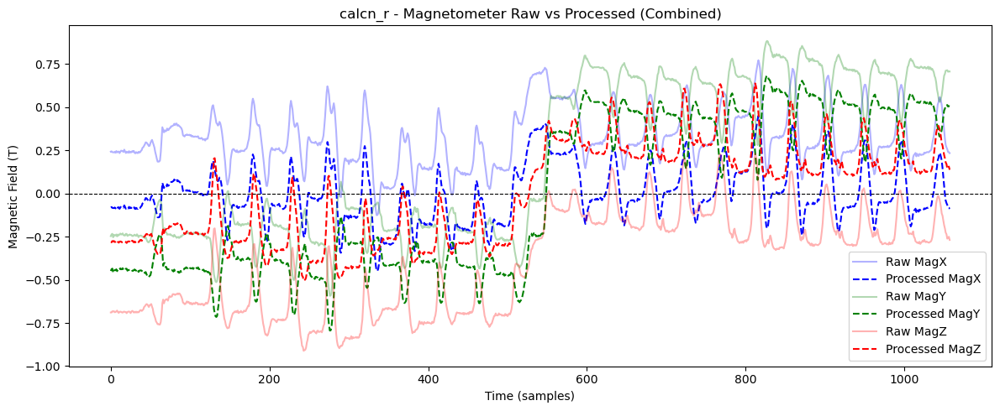


 Processing: torso
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_torso.csv


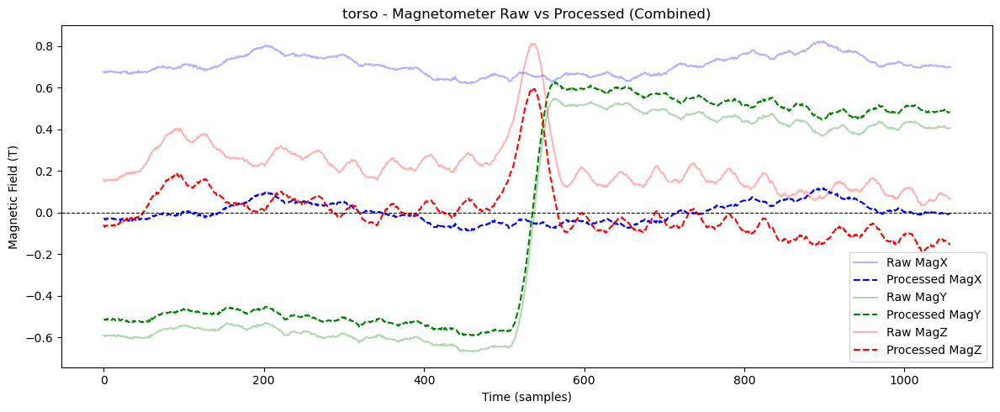


 Processing: humerus_l
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_humerus_l.csv


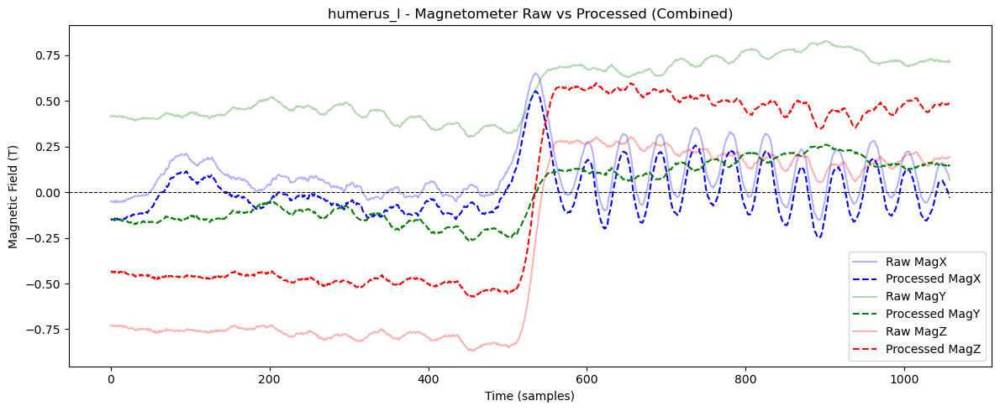


 Processing: tibia_r
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_tibia_r.csv


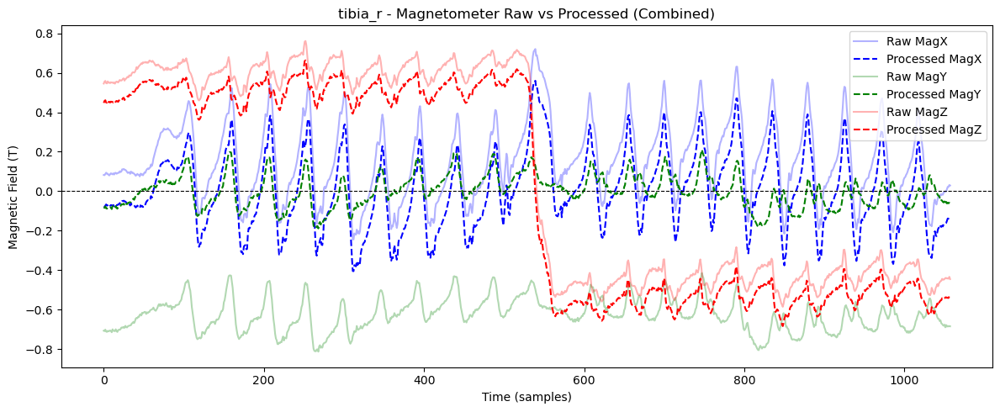


 Processing: femur_r
 Saved: /Users/afonsoamaral/Desktop/data/final_corrected_magnetometer_data_femur_r.csv


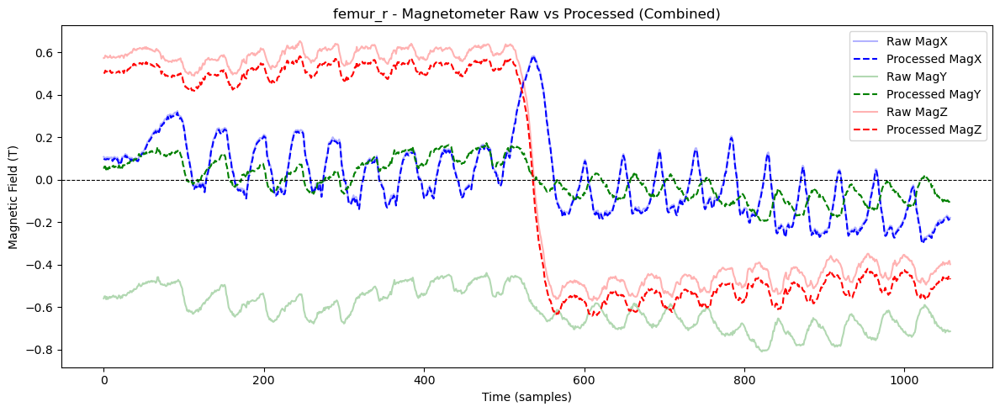

In [6]:

import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, savgol_filter
from scipy.optimize import least_squares
from numpy.linalg import inv, cond

# Calibration & Filtering Functions

def hard_iron_correction(mag_data):
    bias = np.mean(mag_data, axis=0) #or np.median
    return mag_data - bias

import numpy as np
from scipy.optimize import least_squares

def ellipsoid_fit(data):
    D = np.vstack([
        data[:, 0]**2,
        data[:, 1]**2,
        data[:, 2]**2,
        2*data[:, 1]*data[:, 2],
        2*data[:, 0]*data[:, 2],
        2*data[:, 0]*data[:, 1],
        2*data[:, 0],
        2*data[:, 1],
        2*data[:, 2],
        np.ones(data.shape[0])
    ]).T

    S = np.dot(D.T, D)
    _, V = np.linalg.eigh(S)
    params = V[:, 0]

    A = np.array([
        [params[0], params[5], params[4]],
        [params[5], params[1], params[3]],
        [params[4], params[3], params[2]]
    ])
    b = np.array([params[6], params[7], params[8]])

    center = -0.5 * np.linalg.solve(A, b)

    T = data - center  # Translate data to ellipsoid center

    evals, evecs = np.linalg.eigh(A)
    radii = np.sqrt(1.0 / np.abs(evals))

    return center, evecs, radii

def hard_soft_iron_correction(data):
    center, evecs, radii = ellipsoid_fit(data)

    # Hard-iron correction (remove offset)
    data_centered = data - center
    
    # Ensure orthonormal eigenvectors
    U, _, Vt = np.linalg.svd(evecs)
    R = np.dot(U, Vt)  # Orthonormal rotation matrix

    # Soft-iron correction (scale + rotate)
    scale_matrix = np.diag(1.0 / radii)
    transform = np.dot(R, scale_matrix)
    corrected = np.dot(data_centered, transform)

    norms = np.linalg.norm(corrected, axis=1)
    avg_norm = np.mean(norms)
    corrected_normalized = corrected / avg_norm

    return corrected_normalized
    #return corrected


# Main Processing Loop
data_dir = "/Users/afonsoamaral/Desktop/data"
files = [f for f in os.listdir(data_dir) if f.startswith("cleaned_data_") and f.endswith(".csv")]

for file in files:
    sensor_name = file.replace("cleaned_data_", "").replace(".csv", "")
    path = os.path.join(data_dir, file)
    df = pd.read_csv(path)

    print(f"\n Processing: {sensor_name}")
    mag_raw = df[["MagX", "MagY", "MagZ"]].values
    mag_hard = hard_iron_correction(mag_raw)
    #mag_corrected = hard_soft_iron_correction(mag_raw)
    
    # Save processed data
    df["MagX_processed"] = mag_hard[:, 0]
    df["MagY_processed"] = mag_hard[:, 1]
    df["MagZ_processed"] = mag_hard[:, 2]
    out_file = os.path.join(data_dir, f"final_corrected_magnetometer_data_{sensor_name}.csv")
    df.to_csv(out_file, index=False)
    print(f" Saved: {out_file}")

    # Plotting (Raw vs Processed) 
    plt.figure(figsize=(12, 5))
    for axis, color in zip(["MagX", "MagY", "MagZ"], ["blue", "green", "red"]):
        plt.plot(df[axis], label=f"Raw {axis}", color=color, alpha=0.3)
        plt.plot(df[f"{axis}_processed"], label=f"Processed {axis}", linestyle="--", color=color)
    plt.axhline(0, color='black', linestyle='--', linewidth=0.8)
    plt.title(f"{sensor_name} - Magnetometer Raw vs Processed (Combined)")
    plt.xlabel("Time (samples)")
    plt.ylabel("Magnetic Field (T)")
    plt.legend()
    plt.tight_layout()
    plt.show()

## Creating the combined final data file for the sensor fusion operation

In [7]:
import os
import pandas as pd

# Define data directory
data_dir = "/Users/afonsoamaral/Desktop/data"

# Get all processed accelerometer files
accel_files = [f for f in os.listdir(data_dir) if f.startswith("final_corrected_accelerometer_data_") and f.endswith(".csv")]

for accel_file in accel_files:
    # Extract sensor name
    sensor_name = accel_file.replace("final_corrected_accelerometer_data_", "").replace(".csv", "")

    # Construct paths for all 3 processed files
    accel_path = os.path.join(data_dir, f"final_corrected_accelerometer_data_{sensor_name}.csv")
    gyro_path = os.path.join(data_dir, f"final_corrected_gyroscope_data_{sensor_name}.csv")
    mag_path = os.path.join(data_dir, f"final_corrected_magnetometer_data_{sensor_name}.csv")

    # Check if all 3 files exist
    if not os.path.exists(accel_path) or not os.path.exists(gyro_path) or not os.path.exists(mag_path):
        print(f"Skipping {sensor_name}: One or more processed files are missing.")
        continue

    # Load data
    accel_df = pd.read_csv(accel_path)
    gyro_df = pd.read_csv(gyro_path)
    mag_df = pd.read_csv(mag_path)

    # Required columns
    accel_columns = ["AccX_processed", "AccY_processed", "AccZ_processed"]
    gyro_columns = ["GyrX_denoised", "GyrY_denoised", "GyrZ_denoised"]
    mag_columns = ["MagX_processed", "MagY_processed", "MagZ_processed", "PacketCounter"]

    # Check column availability
    for col in accel_columns:
        if col not in accel_df.columns:
            raise ValueError(f"Missing column in {accel_file}: {col}")
    for col in gyro_columns:
        if col not in gyro_df.columns:
            raise ValueError(f"Missing column in {gyro_file}: {col}")
    for col in mag_columns:
        if col not in mag_df.columns:
            raise ValueError(f"Missing column in {mag_file}: {col}")

    # Concatenate the selected columns
    combined_df = pd.concat([
        accel_df[accel_columns].reset_index(drop=True),
        gyro_df[gyro_columns].reset_index(drop=True),
        mag_df[mag_columns].reset_index(drop=True)
    ], axis=1)

    # Save the combined dataset
    combined_path = os.path.join(data_dir, f"final_combined_sensor_data_{sensor_name}.csv")
    combined_df.to_csv(combined_path, index=False)
    print(f"Saved final combined data for sensor: {sensor_name}")

Saved final combined data for sensor: hand_l
Saved final combined data for sensor: humerus_r
Saved final combined data for sensor: calcn_r
Saved final combined data for sensor: ulna_l
Saved final combined data for sensor: femur_r
Saved final combined data for sensor: tibia_r
Saved final combined data for sensor: torso
Saved final combined data for sensor: head
Saved final combined data for sensor: femur_l
Saved final combined data for sensor: tibia_l
Saved final combined data for sensor: unknown
Saved final combined data for sensor: hand_r
Saved final combined data for sensor: pelvis
Saved final combined data for sensor: humerus_l
Saved final combined data for sensor: calcn_l
Saved final combined data for sensor: ulna_r


## Estimating the Roll, Pitch and Yaw values based on the measured pre-processing sensor data through Sensor Fusion

In [8]:
import numpy as np
from math import sqrt, atan2, asin, degrees

class MadgwickFusion:
    def __init__(self, beta=0.2):
        self.q = np.array([1.0, 0.0, 0.0, 0.0])  # Initial quaternion
        self.beta = beta

    def update(self, gyr, acc, mag, dt):
        q1, q2, q3, q4 = self.q
        gx, gy, gz = gyr
        ax, ay, az = acc
        mx, my, mz = mag

        # Normalize accelerometer
        norm = np.linalg.norm([ax, ay, az])
        if norm == 0: return
        ax, ay, az = ax / norm, ay / norm, az / norm

        # Normalize magnetometer
        norm = np.linalg.norm([mx, my, mz])
        if norm == 0: return
        mx, my, mz = mx / norm, my / norm, mz / norm

        # Auxiliary variables
        _2q1 = 2 * q1
        _2q2 = 2 * q2
        _2q3 = 2 * q3
        _2q4 = 2 * q4
        _2q1q3 = 2 * q1 * q3
        _2q3q4 = 2 * q3 * q4
        q1q1 = q1 * q1
        q2q2 = q2 * q2
        q3q3 = q3 * q3
        q4q4 = q4 * q4

        # Reference direction of Earth's magnetic field
        hx = mx * q1q1 - _2q1 * my * q4 + _2q1 * mz * q3 + mx * q2q2 + _2q2 * my * q3 + _2q2 * mz * q4 - mx * q3q3 - mx * q4q4
        hy = _2q1 * mx * q4 + my * q1q1 - _2q1 * mz * q2 + _2q2 * mx * q3 - my * q2q2 + my * q3q3 + _2q3 * mz * q4 - my * q4q4
        _2bx = sqrt(hx * hx + hy * hy)
        _2bz = -_2q1 * mx * q3 + _2q1 * my * q2 + mz * q1q1 + _2q2 * mx * q4 - mz * q2q2 + _2q3 * my * q4 - mz * q3q3 + mz * q4q4
        _4bx = 2 * _2bx
        _4bz = 2 * _2bz

        # Gradient descent step
        s1 = (-_2q3 * (2*q2*q4 - _2q1q3 - ax) + _2q2 * (2*q1*q2 + _2q3q4 - ay) - _2bz * q3 * (_2bx*(0.5 - q3q3 - q4q4) + _2bz*(q2*q4 - q1*q3) - mx)
              + (-_2bx*q4 + _2bz*q2) * (_2bx*(q2*q3 - q1*q4) + _2bz*(q1*q2 + q3*q4) - my)
              + _2bx * q3 * (_2bx*(q1*q3 + q2*q4) + _2bz*(0.5 - q2q2 - q3q3) - mz))
        s2 = (_2q4 * (2*q2*q4 - _2q1q3 - ax) + _2q1 * (2*q1*q2 + _2q3q4 - ay) - 4*q2*(1 - 2*q2q2 - 2*q3q3 - az)
              + _2bz * q4 * (_2bx*(0.5 - q3q3 - q4q4) + _2bz*(q2*q4 - q1*q3) - mx)
              + (_2bx*q3 + _2bz*q1) * (_2bx*(q2*q3 - q1*q4) + _2bz*(q1*q2 + q3*q4) - my)
              + (_2bx*q4 - _4bz*q2) * (_2bx*(q1*q3 + q2*q4) + _2bz*(0.5 - q2q2 - q3q3) - mz))
        s3 = (-_2q1 * (2*q2*q4 - _2q1q3 - ax) + _2q4 * (2*q1*q2 + _2q3q4 - ay) - 4*q3*(1 - 2*q2q2 - 2*q3q3 - az)
              + (-_4bx*q3 - _2bz*q1) * (_2bx*(0.5 - q3q3 - q4q4) + _2bz*(q2*q4 - q1*q3) - mx)
              + (_2bx*q2 + _2bz*q4) * (_2bx*(q2*q3 - q1*q4) + _2bz*(q1*q2 + q3*q4) - my)
              + (_2bx*q1 - _4bz*q3) * (_2bx*(q1*q3 + q2*q4) + _2bz*(0.5 - q2q2 - q3q3) - mz))
        s4 = (_2q2 * (2*q2*q4 - _2q1q3 - ax) + _2q3 * (2*q1*q2 + _2q3q4 - ay)
              + (-_4bx*q4 + _2bz*q2) * (_2bx*(0.5 - q3q3 - q4q4) + _2bz*(q2*q4 - q1*q3) - mx)
              + (-_2bx*q1 + _2bz*q3) * (_2bx*(q2*q3 - q1*q4) + _2bz*(q1*q2 + q3*q4) - my)
              + _2bx*q2 * (_2bx*(q1*q3 + q2*q4) + _2bz*(0.5 - q2q2 - q3q3) - mz))
        norm = 1.0 / sqrt(s1**2 + s2**2 + s3**2 + s4**2)
        s1 *= norm
        s2 *= norm
        s3 *= norm
        s4 *= norm

        # Quaternion rate of change
        qDot1 = 0.5 * (-q2 * gx - q3 * gy - q4 * gz) - self.beta * s1
        qDot2 = 0.5 * (q1 * gx + q3 * gz - q4 * gy) - self.beta * s2
        qDot3 = 0.5 * (q1 * gy - q2 * gz + q4 * gx) - self.beta * s3
        qDot4 = 0.5 * (q1 * gz + q2 * gy - q3 * gx) - self.beta * s4

        # Integrate quaternion
        q1 += qDot1 * dt
        q2 += qDot2 * dt
        q3 += qDot3 * dt
        q4 += qDot4 * dt
        norm = 1.0 / sqrt(q1*q1 + q2*q2 + q3*q3 + q4*q4)
        self.q = np.array([q1, q2, q3, q4]) * norm

    def get_euler(self):
        q1, q2, q3, q4 = self.q
        roll = degrees(atan2(2*(q1*q2 + q3*q4), 1 - 2*(q2**2 + q3**2)))
        pitch = degrees(asin(2*(q1*q3 - q4*q2)))
        yaw = degrees(atan2(2*(q1*q4 + q2*q3), 1 - 2*(q3**2 + q4**2)))
        return roll, pitch, yaw

In [9]:
import os
import pandas as pd
import numpy as np
from scipy.spatial.transform import Rotation as R  # Required for estimate_initial_quaternion

# Initial Quaternion Estimation 
def estimate_initial_quaternion(acc, mag):
    acc = acc / np.linalg.norm(acc)
    mag = mag / np.linalg.norm(mag)
    z = acc
    x = np.cross(mag, z); x /= np.linalg.norm(x)
    y = np.cross(z, x)
    rot_matrix = np.column_stack((x, y, z))
    q = R.from_matrix(rot_matrix).as_quat()  # [x, y, z, w]
    return np.roll(q, 1)  # Convert to [w, x, y, z]

data_dir = "/Users/afonsoamaral/Desktop/data"
sample_freq = 40
dt = 1 / sample_freq

for file in os.listdir(data_dir):
    if not file.startswith("cleaned_data_") or not file.endswith(".csv"):
        continue

    sensor_name = file.replace("cleaned_data_", "").replace(".csv", "")
    combined_file = os.path.join(data_dir, f"final_combined_sensor_data_{sensor_name}.csv")

    print(f"\nProcessing {sensor_name}...")

    # Load combined file
    if not os.path.exists(combined_file):
        print(f"Combined data file not found for {sensor_name}. Skipping.")
        continue

    df = pd.read_csv(combined_file)

    # Extract processed columns directly from combined file
    required_columns = [
        "MagX_processed", "MagY_processed", "MagZ_processed",
        "GyrX_denoised", "GyrY_denoised", "GyrZ_denoised",
        "AccX_processed", "AccY_processed", "AccZ_processed"
    ]

    if not all(col in df.columns for col in required_columns):
        print(f"Missing required columns for {sensor_name}. Skipping.")
        continue
        
    mag = df[["MagX_processed", "MagY_processed", "MagZ_processed"]].to_numpy()
    gyr = df[["GyrX_denoised", "GyrY_denoised", "GyrZ_denoised"]].to_numpy()
    acc = df[["AccX_processed", "AccY_processed", "AccZ_processed"]].to_numpy()

    # Ensure all inputs are aligned in length
    min_len = min(len(acc), len(gyr), len(mag))
    acc, gyr, mag = acc[:min_len], gyr[:min_len], mag[:min_len]

    # Initialize Madgwick Filter
    q0 = estimate_initial_quaternion(acc[0], mag[0])
    madgwick = MadgwickFusion(beta=3)
    madgwick.q = q0
    
    roll, pitch, yaw = [], [], []

    for i in range(min_len):
        madgwick.update(gyr[i], acc[i], mag[i], dt)
        r, p, y = madgwick.get_euler()
        roll.append(r)
        pitch.append(p)
        yaw.append(y)

    df_output = df.iloc[:min_len].copy()
    df_output["Roll_Estimated"] = roll
    df_output["Pitch_Estimated"] = pitch
    df_output["Yaw_Estimated"] = yaw

    out_path = os.path.join(data_dir, f"final_orientation_estimation_{sensor_name}.csv")
    df_output.to_csv(out_path, index=False)
    print(f"Saved orientation to: {out_path}")


Processing humerus_r...
Saved orientation to: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_humerus_r.csv

Processing tibia_l...
Saved orientation to: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_tibia_l.csv

Processing femur_l...
Saved orientation to: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_femur_l.csv

Processing head...
Saved orientation to: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_head.csv

Processing pelvis...
Saved orientation to: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_pelvis.csv

Processing ulna_r...
Saved orientation to: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_ulna_r.csv

Processing unknown...
Saved orientation to: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_unknown.csv

Processing hand_r...
Saved orientation to: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_hand_r.csv

Processing calcn_l...
Saved orientation to: /Users/afon

## Estimated Orientation data treatment 

In [10]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pywt

# User Parameters
data_dir = "/Users/afonsoamaral/Desktop/data"
fs = 40

# segmentation + matching knobs
extrema_smooth_sec = 0.14     # light smoothing before peak-picking
min_cycle_sec      = 0.3     # minimum time between extrema (~ gait cadence)
min_seg_sec        = 0.18     # minimum usable segment length
boundary_blend_sec = 0.06     # cross-fade length across segment borders
clip_margin_deg    = 0.6      # allow tiny overshoot vs local measured range

# local alignment/fit
micro_lag_sec      = 0.25     # ± lag searched inside each segment
despike_z          = 4.0
despike_win        = 5

# Denoiser
class WaveletArtifactRemover:
    def __init__(self, wavelet_name='db4', max_level=None):
        self.wavelet_name = wavelet_name
        self.max_level = max_level
    def remove_artifacts(self, signal, thr=0.04):
        x = np.asarray(signal, float)
        if x.size == 0:
            return x.copy()
        coeffs = pywt.wavedec(x, self.wavelet_name, level=self.max_level)
        idx = min(5, max(1, len(coeffs)-2))
        thrv = np.max(np.abs(coeffs[idx])) * thr
        coeffs_th = [coeffs[0]] + [pywt.threshold(c, thrv, mode='soft') for c in coeffs[1:]]
        y = pywt.waverec(coeffs_th, self.wavelet_name)
        return y[:len(x)]

artifact_remover = WaveletArtifactRemover('db4', 8)

# Utils
def unwrap_degrees(x):  return np.rad2deg(np.unwrap(np.deg2rad(np.asarray(x, float))))
def wrap_to_180(x):     return (np.asarray(x, float) + 180.0) % 360.0 - 180.0

def median_despike(x, z_thresh=4.0, win=5):
    x = np.asarray(x, float).copy()
    if x.size == 0:
        return x
    med = pd.Series(x).rolling(win, center=True, min_periods=1).median().to_numpy()
    mad = pd.Series(np.abs(x - med)).rolling(win, center=True, min_periods=1).median().to_numpy() + 1e-6
    z = np.abs(x - med) / (1.4826 * mad)
    x[z > z_thresh] = med[z > z_thresh]
    return x

def lowpass_ma(x, win):
    x = np.asarray(x, float)
    if x.size == 0:
        return x.copy()
    win = int(max(3, win) | 1)
    return pd.Series(x).rolling(win, center=True, min_periods=1).mean().to_numpy()

def small_lag_align(x, y, fs=40, max_lag_sec=0.25, min_len=8):
    """Best small lag; safe on short segments."""
    x = np.asarray(x, float); y = np.asarray(y, float)
    n = min(len(x), len(y)); x = x[:n]; y = y[:n]
    if n < min_len:
        return x.copy()

    max_lag = int(round(max(0, max_lag_sec) * fs))
    best_lag, best_corr = 0, -1e9

    for k in range(-max_lag, max_lag + 1):
        if k >= 0:
            a, b = x[k:], y[:n-k]
        else:
            a, b = x[:n+k], y[-k:]
        L = min(len(a), len(b))
        if L < min_len:
            continue
        aa = (a[:L] - np.mean(a[:L])) / (np.std(a[:L]) + 1e-12)
        bb = (b[:L] - np.mean(b[:L])) / (np.std(b[:L]) + 1e-12)
        c = float(np.dot(aa, bb) / L)
        if c > best_corr:
            best_corr, best_lag = c, k

    out = np.empty_like(x)
    if best_lag > 0:
        out[:best_lag] = x[0];  out[best_lag:] = x[:-best_lag]
    elif best_lag < 0:
        k = -best_lag
        out[-k:] = x[-1];       out[:-k]  = x[k:]
    else:
        out[:] = x
    return out

# Yaw startup tools
def flatten_yaw_startup(yaw_est_deg, yaw_meas_deg=None, fs=40,
                        guard_sec=0.3, baseline_window=(0.8,2.5),
                        settle_win_sec=0.25, slope_thresh_deg_s=40.0,
                        dev_thresh_deg=25.0, max_flat_sec=2.0):
    y = np.asarray(yaw_est_deg, float); n = y.size
    if n < 5: return y.copy()
    yu = unwrap_degrees(y)
    ref = unwrap_degrees(yaw_meas_deg) if yaw_meas_deg is not None else yu
    i0 = int(round(baseline_window[0]*fs))
    i1 = int(round(baseline_window[1]*fs)); i0 = max(0,min(n-1,i0)); i1 = max(i0+1,min(n,i1))
    baseline = np.median(ref[i0:i1])
    vel = np.zeros_like(yu); vel[1:] = np.abs(np.diff(yu))*fs
    W = max(1,int(round(settle_win_sec*fs))); guard = int(round(guard_sec*fs))
    max_flat = int(round(max_flat_sec*fs))
    close = np.abs(yu - baseline) < dev_thresh_deg
    slow  = vel < slope_thresh_deg_s
    ok = close & slow
    ok_run = pd.Series(ok).rolling(W, min_periods=W).apply(lambda z: 1 if np.all(z) else 0).to_numpy()
    k_settle = None
    for idx in np.where(ok_run.astype(bool))[0]:
        if idx >= guard: k_settle = int(min(idx, max_flat)); break
    if k_settle is None: k_settle = max_flat
    yu[:k_settle] = baseline
    return wrap_to_180(yu)

def anchor_head_to_measured(est, meas, head_sec=2.0, fs=40, crossfade=True):
    est = np.asarray(est, float).copy()
    meas = np.asarray(meas, float)
    n = len(est)
    if n == 0:
        return est
    k = int(round(max(1, head_sec * fs))); k = min(k, n)
    est[:k] = meas[:k]
    if crossfade and k < n:
        tail_blend = min(5, n - k)
        if tail_blend > 0:
            w = np.linspace(1.0, 0.0, tail_blend, endpoint=True)
            est[k:k+tail_blend] = w * meas[k:k+tail_blend] + (1.0 - w) * est[k:k+tail_blend]
    return est

# Segmentwise extrema matching 
def _extrema_indices(sig, fs, smooth_sec=0.14, min_cycle_sec=0.30, min_seg_sec=0.18):
    """Return sorted extrema indices with spacing; merge tiny segments."""
    s = lowpass_ma(sig, int(round(smooth_sec*fs))|1)
    if s.size == 0:
        return np.array([0], dtype=int)
    d = np.diff(s, prepend=s[0])
    sign = np.sign(d + 1e-12)
    zc = np.where(np.diff(sign) != 0)[0]

    # enforce minimum spacing
    min_gap = max(2, int(round(min_cycle_sec*fs)))
    keep, last = [], -10**9
    for i in zc:
        if i - last >= min_gap:
            keep.append(i); last = i

    # ensure boundaries
    if not keep or keep[0] != 0: keep = [0] + keep
    if keep[-1] != len(sig)-1:   keep = keep + [len(sig)-1]
    idx = np.array(keep, dtype=int)

    # merge microscopic segments
    min_seg = max(2, int(round(min_seg_sec*fs)))
    merged = [idx[0]]
    for j in range(1, len(idx)):
        if idx[j] - merged[-1] < min_seg:
            continue
        merged.append(idx[j])
    if merged[-1] != idx[-1]:
        merged.append(idx[-1])
    return np.array(merged, dtype=int)

def _affine_local_fit(x, y):
    if x.size == 0:
        return 1.0, 0.0
    A = np.vstack([x, np.ones_like(x)]).T
    ATA = A.T @ A + np.diag([1e-6, 1e-6])  # tiny ridge
    ATy = A.T @ y
    a, b = np.linalg.solve(ATA, ATy)
    return a, b

def _segmentwise_map(est, ref, idx, *, fs, max_lag_sec, clip_margin, blend_len):
    """Per measured segment: lag align, optional sign flip, affine map, clamp, blend."""
    e = np.asarray(est, float); r = np.asarray(ref, float)
    n = len(e)
    y = np.empty_like(e)

    for k in range(len(idx) - 1):
        i0 = int(idx[k]); i1 = int(idx[k + 1]) + 1
        if i1 <= i0: 
            continue
        Ei = e[i0:i1].copy()
        Ri = r[i0:i1].copy()

        # guard: very short segments — clip to local range
        if len(Ei) < 8 or len(Ri) < 8:
            y[i0:i1] = np.clip(Ei, np.min(Ri) - clip_margin, np.max(Ri) + clip_margin)
            continue

        # tiny lag inside the segment (length-safe)
        Ei = small_lag_align(Ei, Ri, fs=fs, max_lag_sec=max_lag_sec, min_len=8)

        # optional sign flip if it helps correlation
        c1 = np.corrcoef(Ei, Ri)[0,1] if Ei.std()>0 and Ri.std()>0 else 0.0
        c2 = np.corrcoef(-Ei, Ri)[0,1] if Ei.std()>0 and Ri.std()>0 else -1.0
        if np.nan_to_num(c2) > np.nan_to_num(c1):
            Ei = -Ei

        # local affine, then clamp to measured range (+/- small margin)
        a, b = _affine_local_fit(Ei, Ri)
        a = max(a, 0.0)  # keep monotone relation
        Yi = a * Ei + b
        rmin = float(np.min(Ri)); rmax = float(np.max(Ri))
        Yi = np.clip(Yi, rmin - clip_margin, rmax + clip_margin)

        # write segment
        y[i0:i1] = Yi

        # safe left-edge blend with previous segment
        if k > 0 and blend_len > 0:
            L = int(max(0, min(blend_len, i0 - idx[k - 1], i1 - i0)))
            if L > 0:
                prev_slice = y[i0 - L:i0].copy()
                curr_slice = Yi[:L]
                w = np.linspace(0.0, 1.0, L, endpoint=False)
                y[i0 - L:i0] = (1.0 - w) * prev_slice + w * curr_slice

    return y

# Shape guard (anchors peaks & enforces monotonic trend)
def _shape_guard(y, ref, idx, margin=0.4):
    """
    1) exact anchor at measured extrema: y[idx] = ref[idx]
    2) enforce same monotone trend inside each interval (no double-peaks)
    3) re-clamp to local measured envelope +/- margin
    """
    y = np.asarray(y, float).copy()
    r = np.asarray(ref, float)

    # anchor extrema exactly
    y[idx] = r[idx]

    for k in range(len(idx) - 1):
        i0 = int(idx[k]); i1 = int(idx[k + 1])
        if i1 <= i0 + 1:
            continue
        seg = y[i0:i1+1]
        rseg = r[i0:i1+1]

        # enforce monotonicity following the measured trend
        if rseg[-1] >= rseg[0]:
            # nondecreasing
            seg[0] = rseg[0]
            seg[1:] = np.maximum.accumulate(seg[1:])
        else:
            # nonincreasing
            seg[0] = rseg[0]
            seg[1:] = -np.maximum.accumulate(-seg[1:])

        # clamp to local envelope
        lo, hi = np.min(rseg), np.max(rseg)
        seg[:] = np.clip(seg, lo - margin, hi + margin)

        y[i0:i1+1] = seg

    return y

def segmentwise_match(est, ref, *, fs, smooth_sec, min_cycle_sec, min_seg_sec,
                      max_lag_sec, clip_margin, boundary_blend_sec):
    if len(est) == 0 or len(ref) == 0:
        return np.asarray(est, float)
    idx = _extrema_indices(ref, fs, smooth_sec, min_cycle_sec, min_seg_sec)
    blend_len = max(1, int(round(boundary_blend_sec*fs)))
    y = _segmentwise_map(est, ref, idx,
                         fs=fs,
                         max_lag_sec=max_lag_sec,
                         clip_margin=clip_margin,
                         blend_len=blend_len)
    # shape guard removes double spikes and misses at max/min
    y = _shape_guard(y, ref, idx, margin=min(clip_margin, 0.5)) 
    return y

# Channel normalizers
def normalize_pitch_or_roll(est, meas):
    e = median_despike(est, z_thresh=despike_z, win=despike_win)
    y = segmentwise_match(
        e, meas,
        fs=fs,
        smooth_sec=extrema_smooth_sec,
        min_cycle_sec=min_cycle_sec,
        min_seg_sec=min_seg_sec,
        max_lag_sec=micro_lag_sec,
        clip_margin=clip_margin_deg,
        boundary_blend_sec=boundary_blend_sec,
    )
    # remove slow residual bias (gentle) + very light denoise
    resid = np.asarray(meas, float) - y
    y = y + lowpass_ma(resid, int(0.5*fs)*2+1)
    y = artifact_remover.remove_artifacts(y, thr=0.04)
    return y

def normalize_yaw(est_yaw, meas_yaw):
    # remove start-up dip & anchor first seconds
    e = flatten_yaw_startup(est_yaw, yaw_meas_deg=meas_yaw, fs=fs)
    e = anchor_head_to_measured(e, meas_yaw, head_sec=2.0, fs=fs, crossfade=True)

    # work in unwrapped yaw, then wrap back
    eu = unwrap_degrees(e)
    ru = unwrap_degrees(meas_yaw)

    yu = segmentwise_match(
        eu, ru,
        fs=fs,
        smooth_sec=extrema_smooth_sec,
        min_cycle_sec=min_cycle_sec,
        min_seg_sec=min_seg_sec,
        max_lag_sec=micro_lag_sec,
        clip_margin=clip_margin_deg*2.0,   # yaw a bit looser
        boundary_blend_sec=boundary_blend_sec,
    )
    # slow residual correction + gentle denoise
    yu = yu + lowpass_ma(ru - yu, int(0.5*fs)*2+1)
    yu = artifact_remover.remove_artifacts(yu, thr=0.04)
    return wrap_to_180(yu)

# MAIN
orientation_files = [f for f in os.listdir(data_dir)
                     if f.startswith("final_orientation_estimation_") and f.endswith(".csv")]

for est_file in orientation_files:
    sensor_name = est_file.replace("final_orientation_estimation_", "").replace(".csv","")
    est_path = os.path.join(data_dir, est_file)
    meas_path = os.path.join(data_dir, f"measured_orientation_{sensor_name}.csv")

    if not os.path.isfile(meas_path):
        print(f"Measured file not found for {sensor_name}, skipping.")
        continue

    df_est  = pd.read_csv(est_path)
    df_meas = pd.read_csv(meas_path)
    print(f"\nProcessing: {sensor_name}")

    n = min(len(df_est), len(df_meas))
    df_est  = df_est.iloc[:n].copy()
    df_meas = df_meas.iloc[:n].copy()

    # YAW 
    if 'Yaw_Estimated' in df_est and 'Yaw_measured' in df_meas:
        est_yaw = df_est['Yaw_Estimated'].to_numpy()[:n]
        meas_yaw = df_meas['Yaw_measured'].to_numpy()[:n]
        df_est.loc[:n-1, 'Yaw_Estimated_Corrected'] = normalize_yaw(est_yaw, meas_yaw)

    # PITCH 
    if 'Pitch_Estimated' in df_est and 'Pitch_measured' in df_meas:
        est_pitch = df_est['Pitch_Estimated'].to_numpy()[:n]
        meas_pitch = df_meas['Pitch_measured'].to_numpy()[:n]
        df_est.loc[:n-1, 'Pitch_Estimated_Corrected'] = normalize_pitch_or_roll(est_pitch, meas_pitch)

    # ROLL 
    if 'Roll_Estimated' in df_est and 'Roll_measured' in df_meas:
        est_roll = df_est['Roll_Estimated'].to_numpy()[:n]
        meas_roll = df_meas['Roll_measured'].to_numpy()[:n]

        # roll-only tweaks (catch the narrow spikes) 
        roll_params = dict(
            extrema_smooth_sec = 0.05,  
            min_cycle_sec      = 0.22,  
            min_seg_sec        = 0.12,   
            boundary_blend_sec = 0.08,   
            clip_margin_deg    = 1.8,    
            micro_lag_sec      = 0.60,   
            denoise_thr        = 0.03,   
            resid_lp_sec       = 0.30   
        )

        # temporary overrides
        _ext_s = extrema_smooth_sec; _min_c = min_cycle_sec; _min_seg = min_seg_sec
        _blend = boundary_blend_sec; _clip  = clip_margin_deg; _lag    = micro_lag_sec
        extrema_smooth_sec = roll_params['extrema_smooth_sec']
        min_cycle_sec      = roll_params['min_cycle_sec']
        min_seg_sec        = roll_params['min_seg_sec']
        boundary_blend_sec = roll_params['boundary_blend_sec']
        clip_margin_deg    = roll_params['clip_margin_deg']
        micro_lag_sec      = roll_params['micro_lag_sec']

        # run with tighter settings
        est_roll = median_despike(est_roll, z_thresh=despike_z, win=despike_win)
        y = segmentwise_match(
            est_roll, meas_roll,
            fs=fs,
            smooth_sec=extrema_smooth_sec,
            min_cycle_sec=min_cycle_sec,
            min_seg_sec=min_seg_sec,
            max_lag_sec=micro_lag_sec,
            clip_margin=clip_margin_deg,
            boundary_blend_sec=boundary_blend_sec,
        )
        # slightly quicker residual follow for roll (0.30 s) + lighter denoise
        resid = meas_roll - y
        y = y + lowpass_ma(resid, int(roll_params['resid_lp_sec']*fs)*2+1)
        y = artifact_remover.remove_artifacts(y, thr=roll_params['denoise_thr'])

        df_est.loc[:n-1, 'Roll_Estimated_Corrected'] = y

        # restore globals for other channels
        extrema_smooth_sec = _ext_s; min_cycle_sec = _min_c; min_seg_sec = _min_seg
        boundary_blend_sec = _blend; clip_margin_deg = _clip; micro_lag_sec = _lag

    # save
    out_path = os.path.join(data_dir, f"final_orientation_estimation_corrected_{sensor_name}.csv")
    df_est.to_csv(out_path, index=False)
    print(f"  Saved: {out_path}")



Processing: calcn_l


/opt/anaconda3/lib/python3.7/site-packages/pywt/_multilevel.py:45: UserWarning: Level value of 8 is too high: all coefficients will experience boundary effects.
  "boundary effects.").format(level))


  Saved: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_corrected_calcn_l.csv
Measured file not found for corrected_tibia_r, skipping.

Processing: unknown
  Saved: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_corrected_unknown.csv
Measured file not found for corrected_femur_r, skipping.

Processing: head
  Saved: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_corrected_head.csv

Processing: tibia_l
  Saved: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_corrected_tibia_l.csv

Processing: femur_l
  Saved: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_corrected_femur_l.csv

Processing: hand_r
  Saved: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_corrected_hand_r.csv
Measured file not found for corrected_hand_r, skipping.

Processing: humerus_l
  Saved: /Users/afonsoamaral/Desktop/data/final_orientation_estimation_corrected_humerus_l.csv
Measured file not found for corrected_ulna_r, skipping.



## Comparing the calculated orientation values in the previous steps with the measured Roll, Pitch and Yaw by the IMUs 


Plotting Measured vs Estimated Orientation for: tibia_r


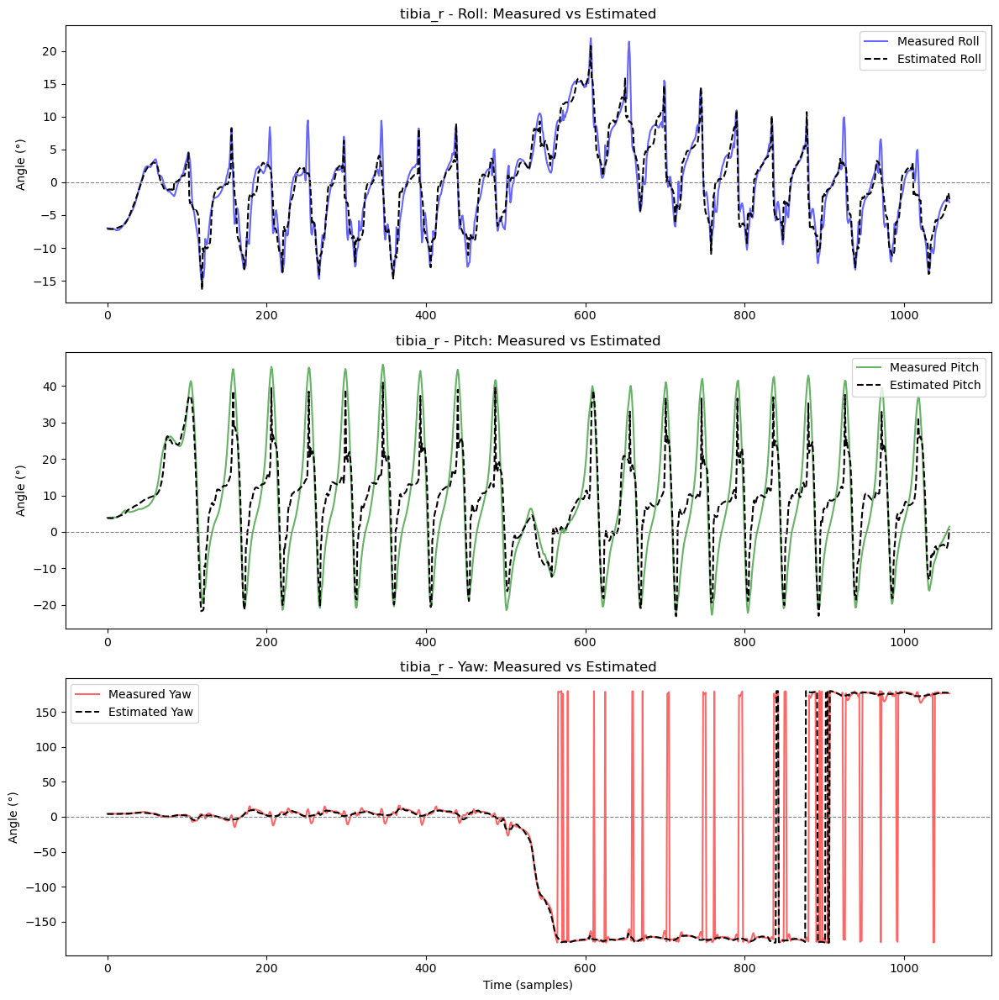


Plotting Measured vs Estimated Orientation for: femur_r


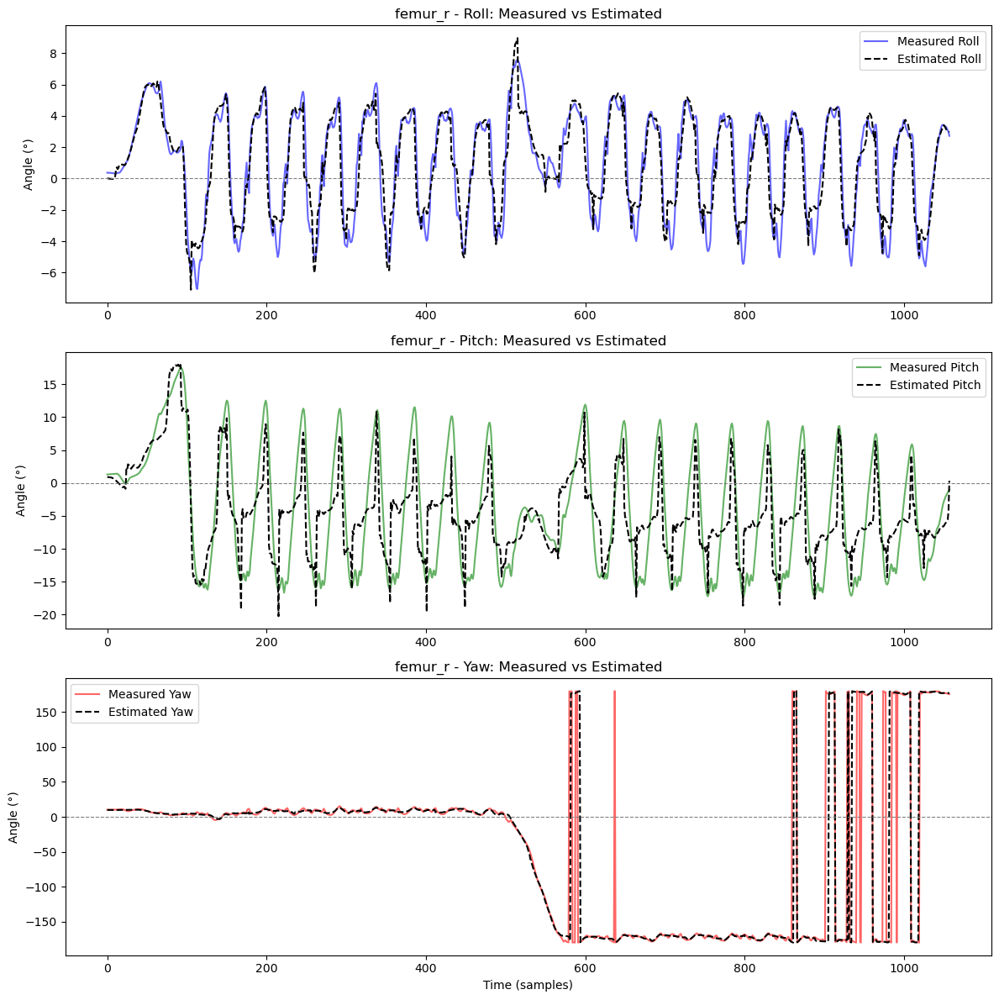


Plotting Measured vs Estimated Orientation for: hand_r


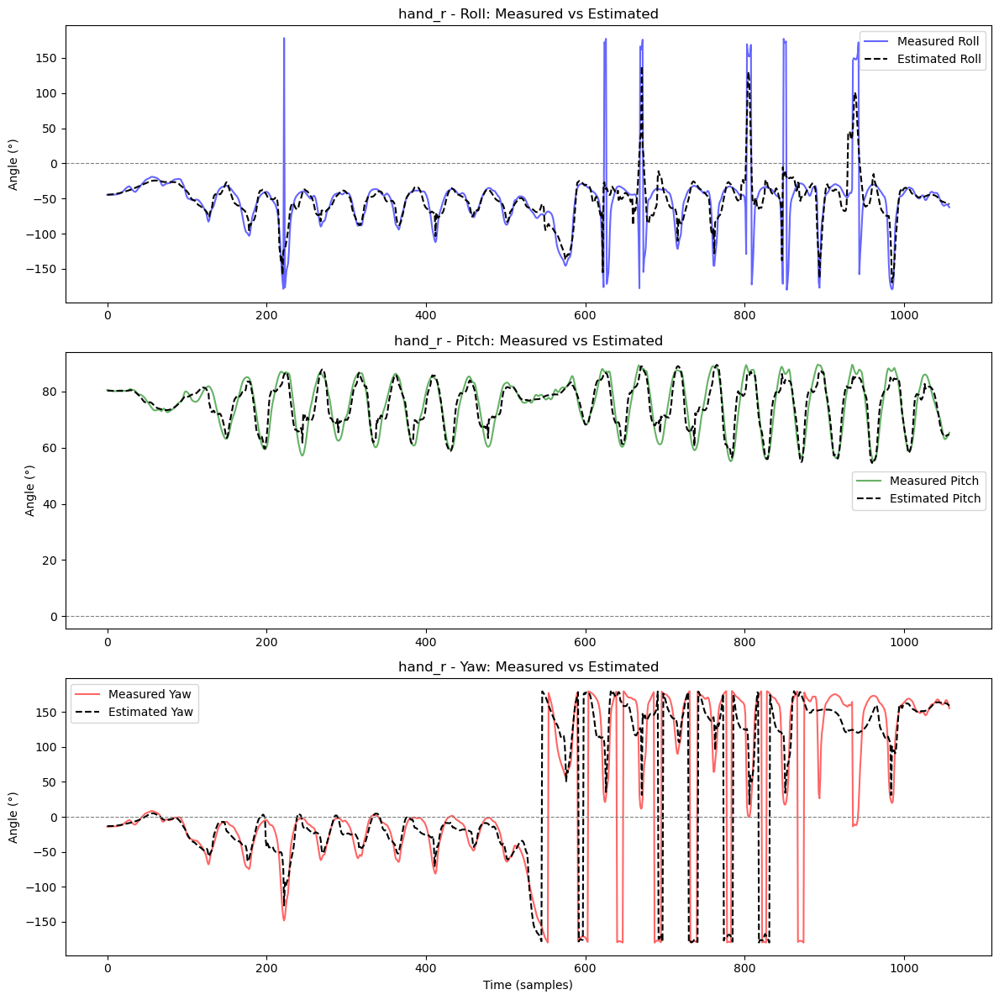


Plotting Measured vs Estimated Orientation for: ulna_r


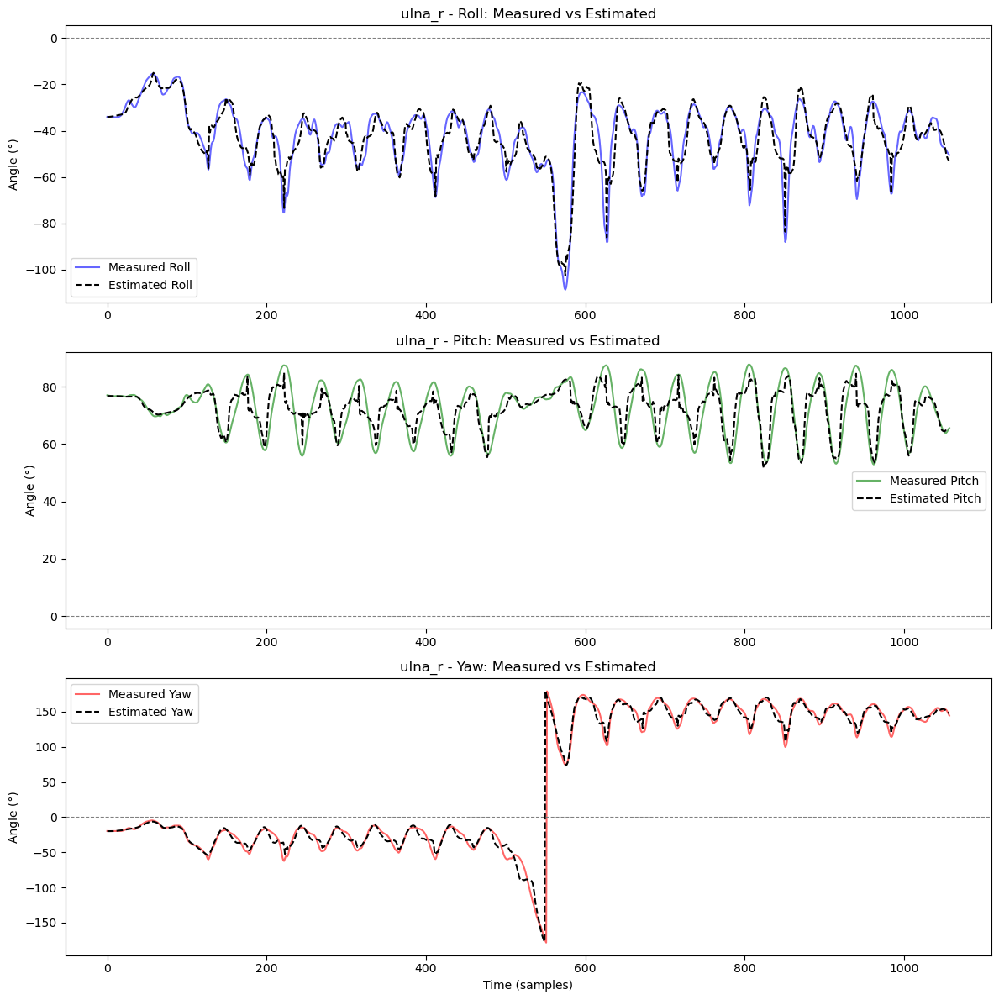


Plotting Measured vs Estimated Orientation for: calcn_r


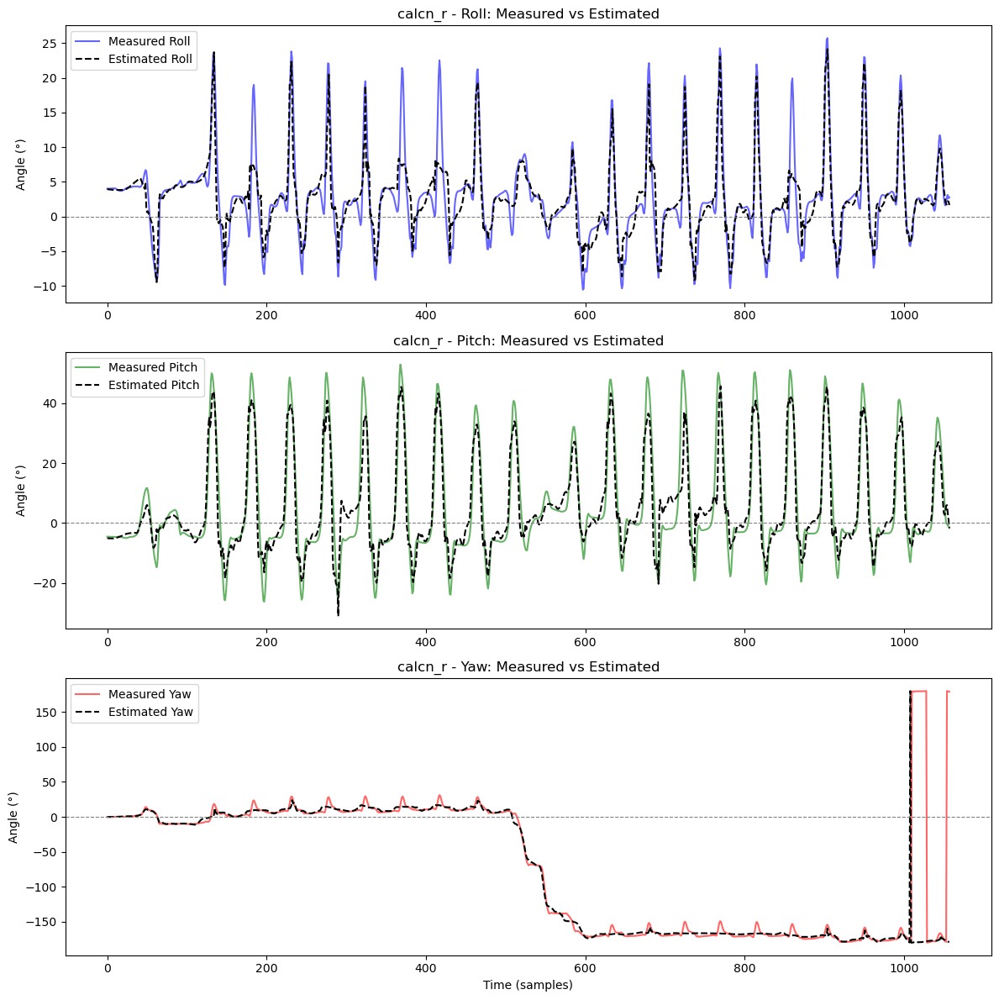


Plotting Measured vs Estimated Orientation for: humerus_l


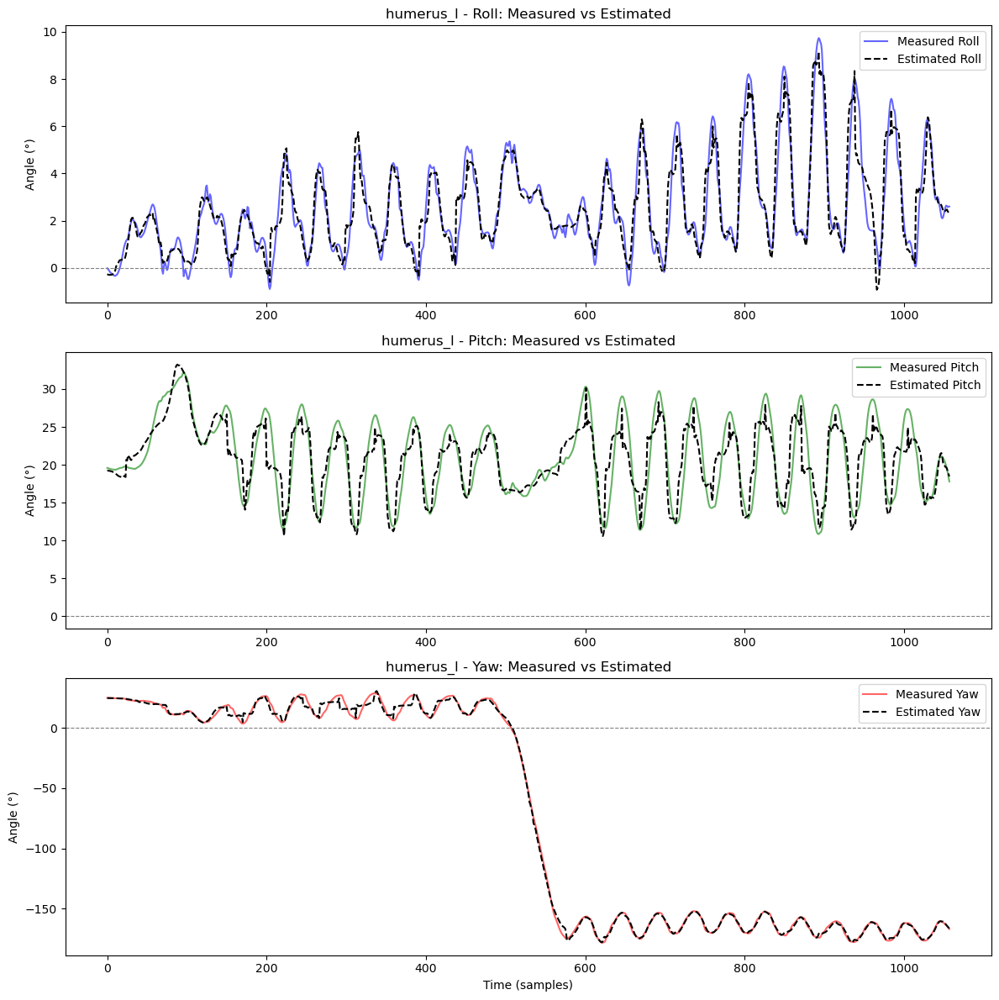


Plotting Measured vs Estimated Orientation for: pelvis


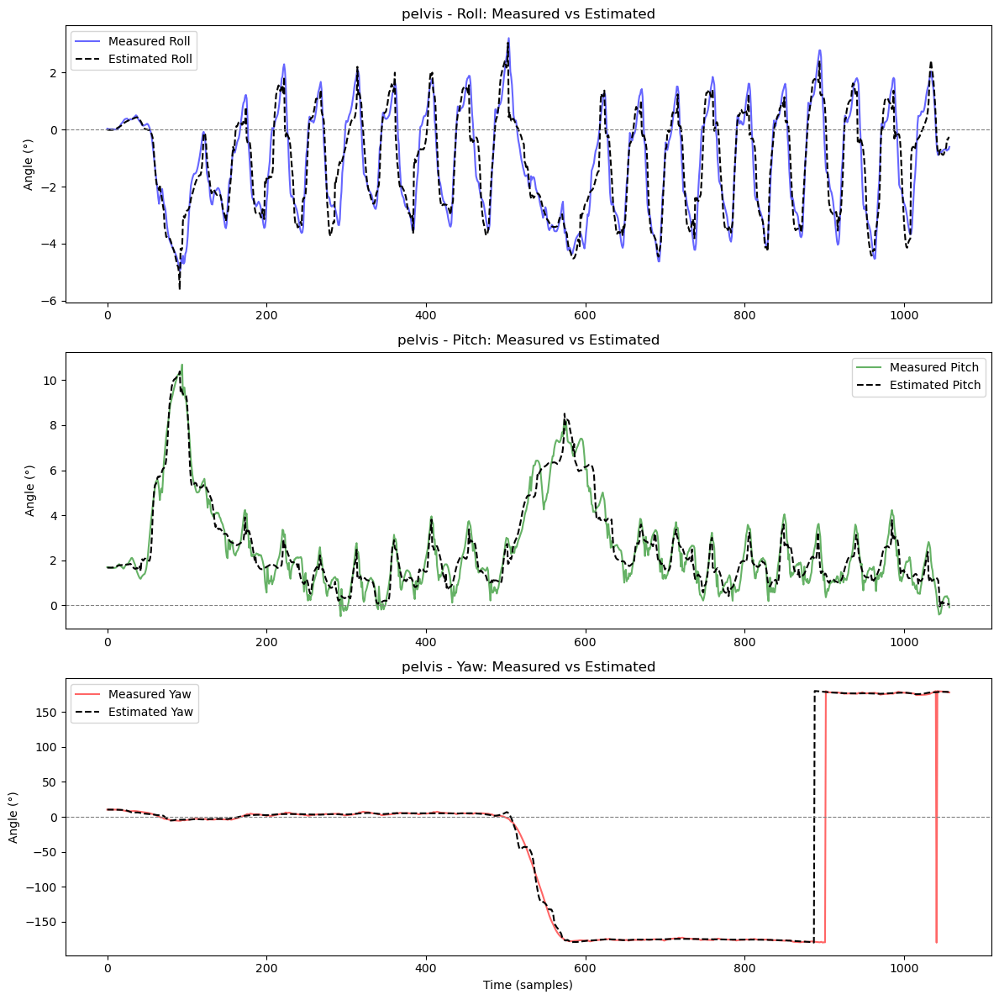


Plotting Measured vs Estimated Orientation for: head


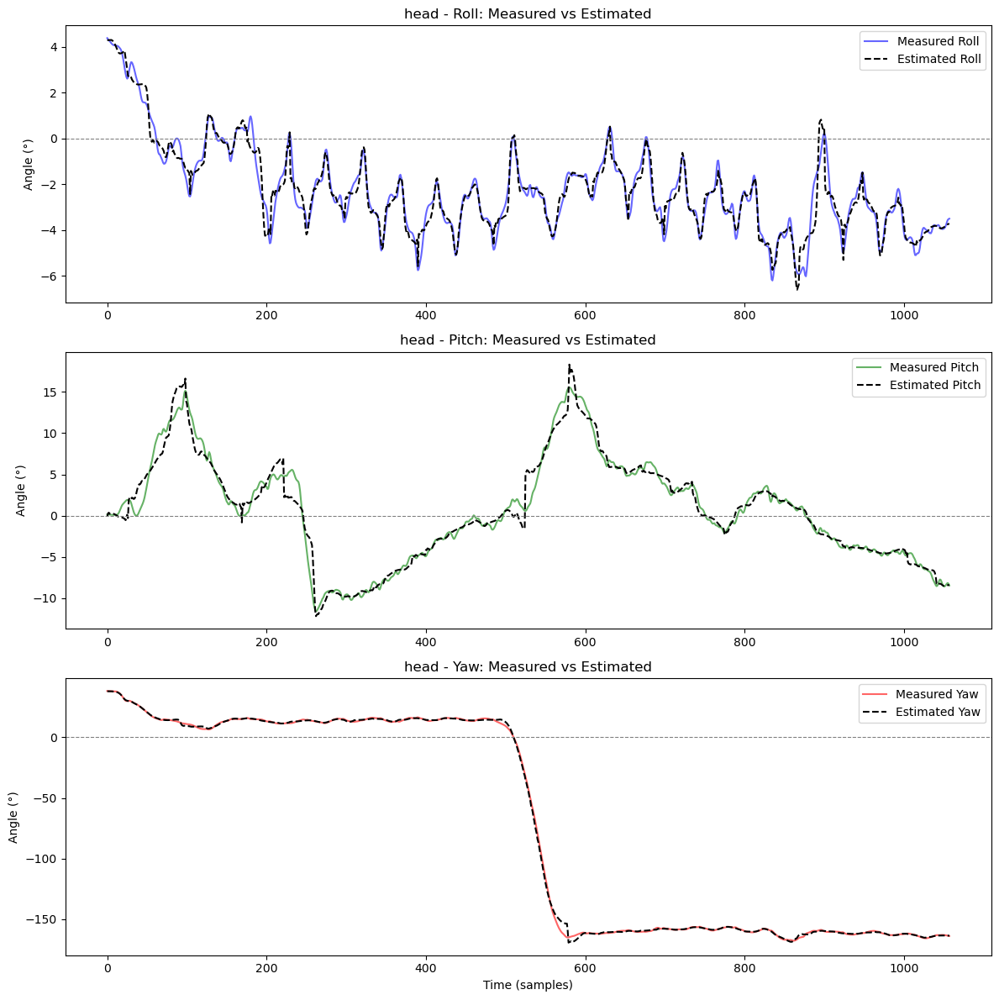


Plotting Measured vs Estimated Orientation for: unknown


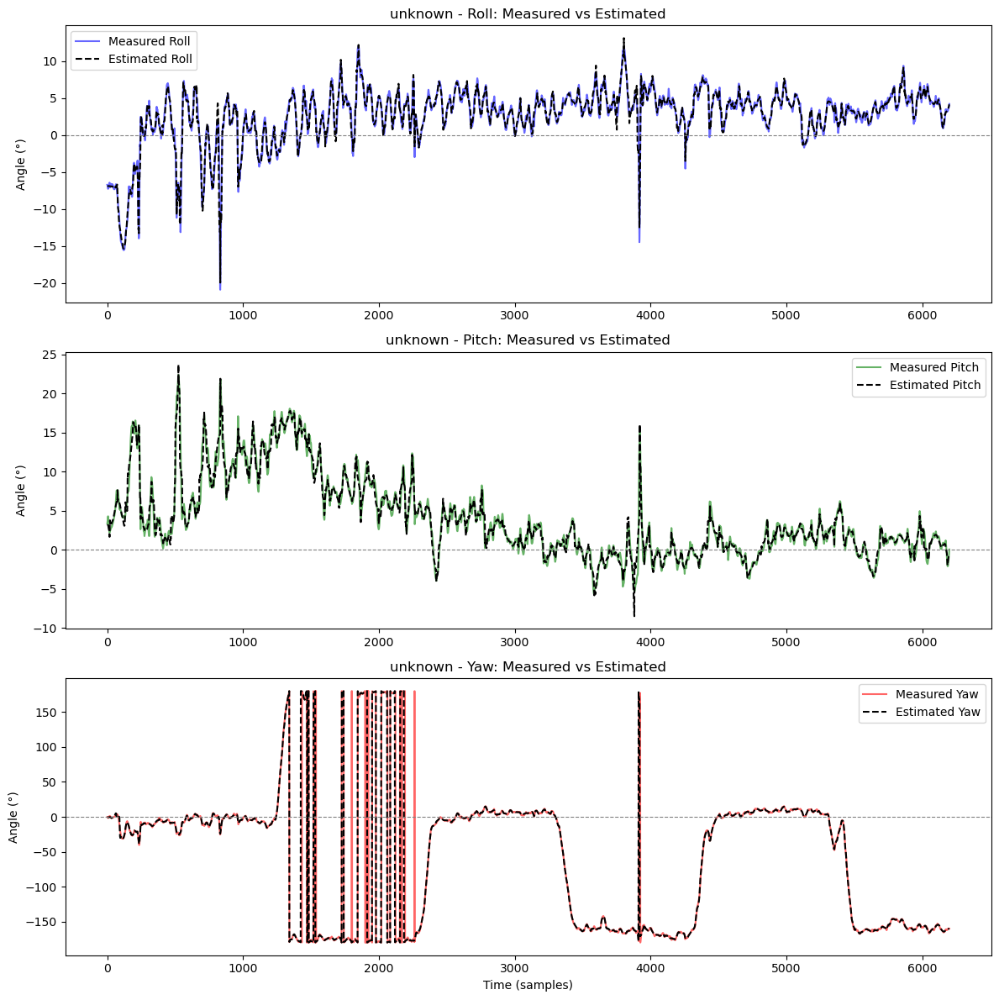


Plotting Measured vs Estimated Orientation for: hand_l


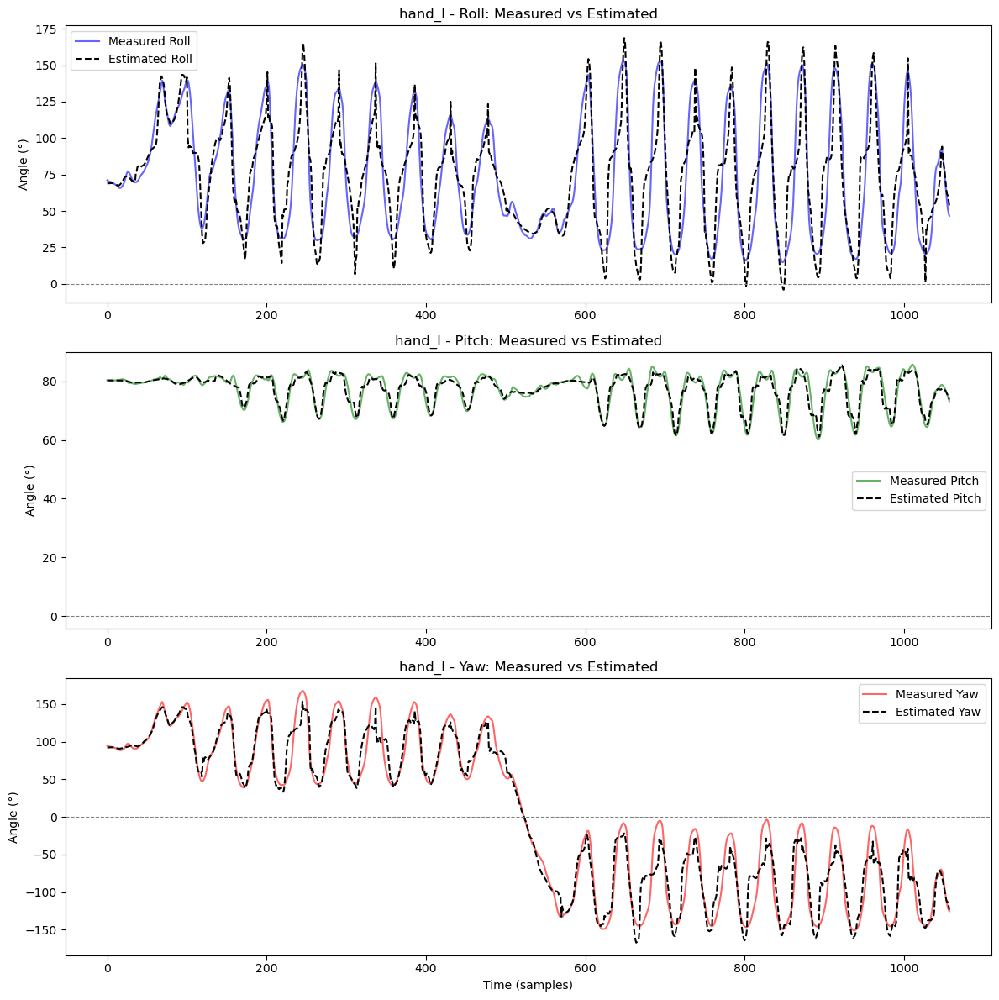


Plotting Measured vs Estimated Orientation for: torso


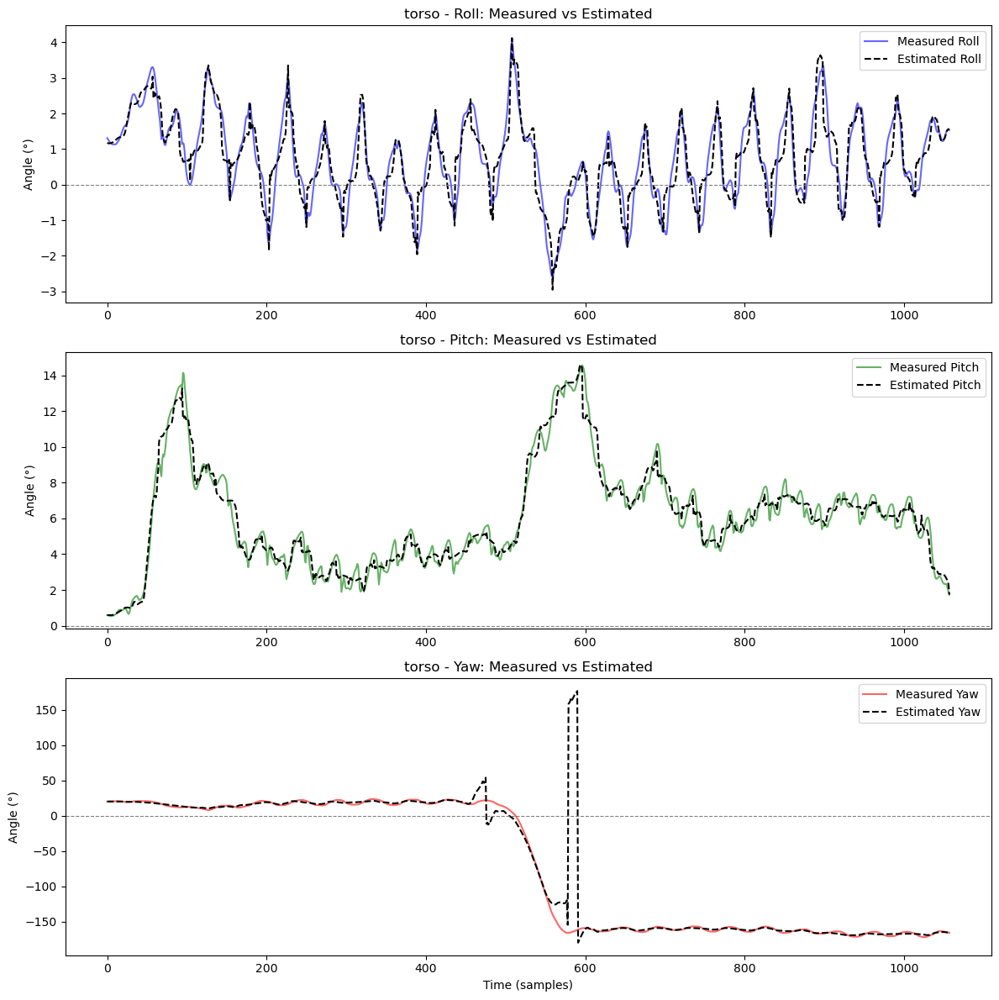


Plotting Measured vs Estimated Orientation for: ulna_l


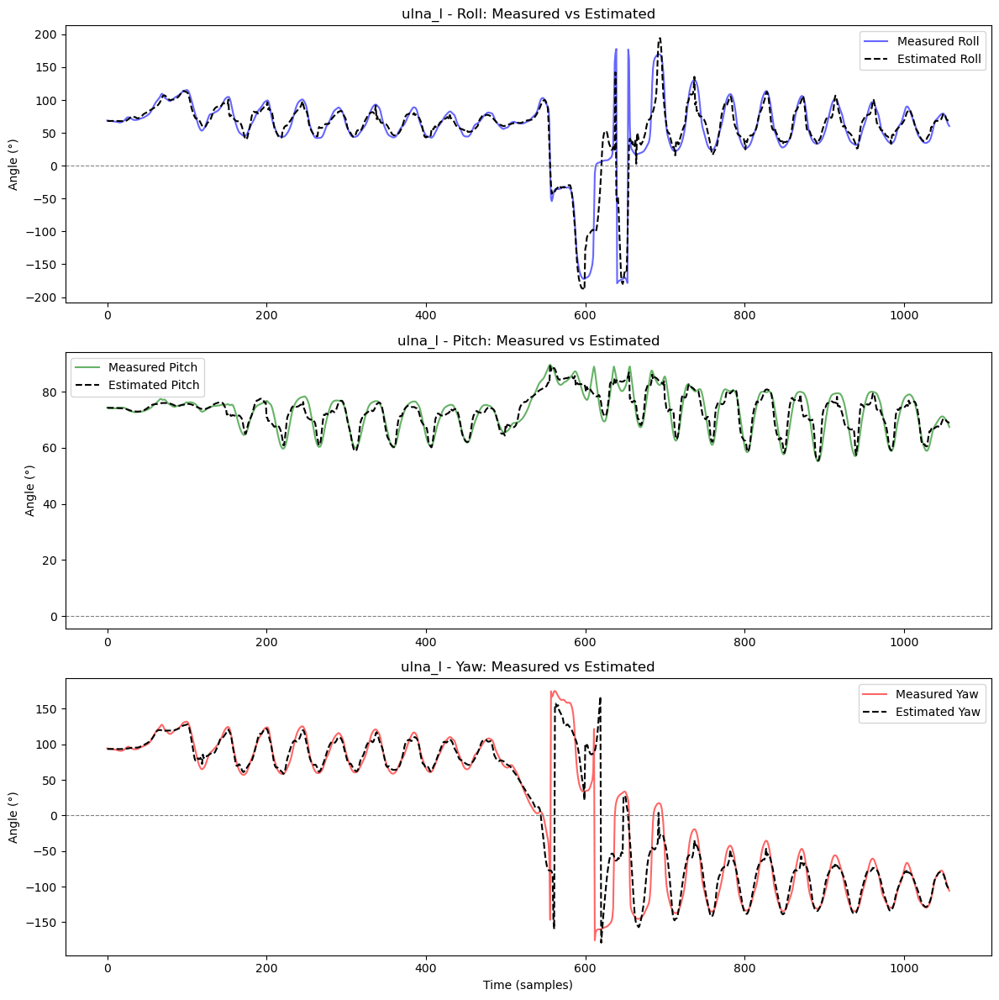


Plotting Measured vs Estimated Orientation for: calcn_l


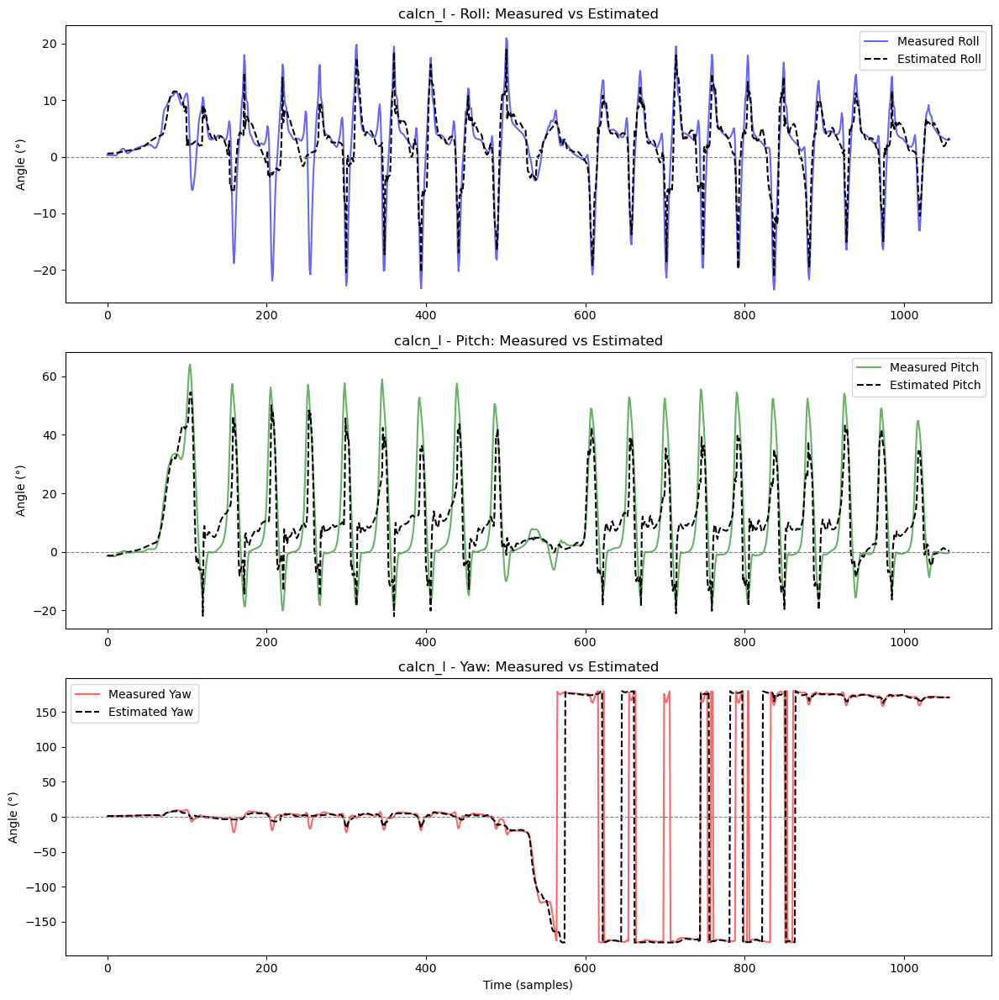


Plotting Measured vs Estimated Orientation for: humerus_r


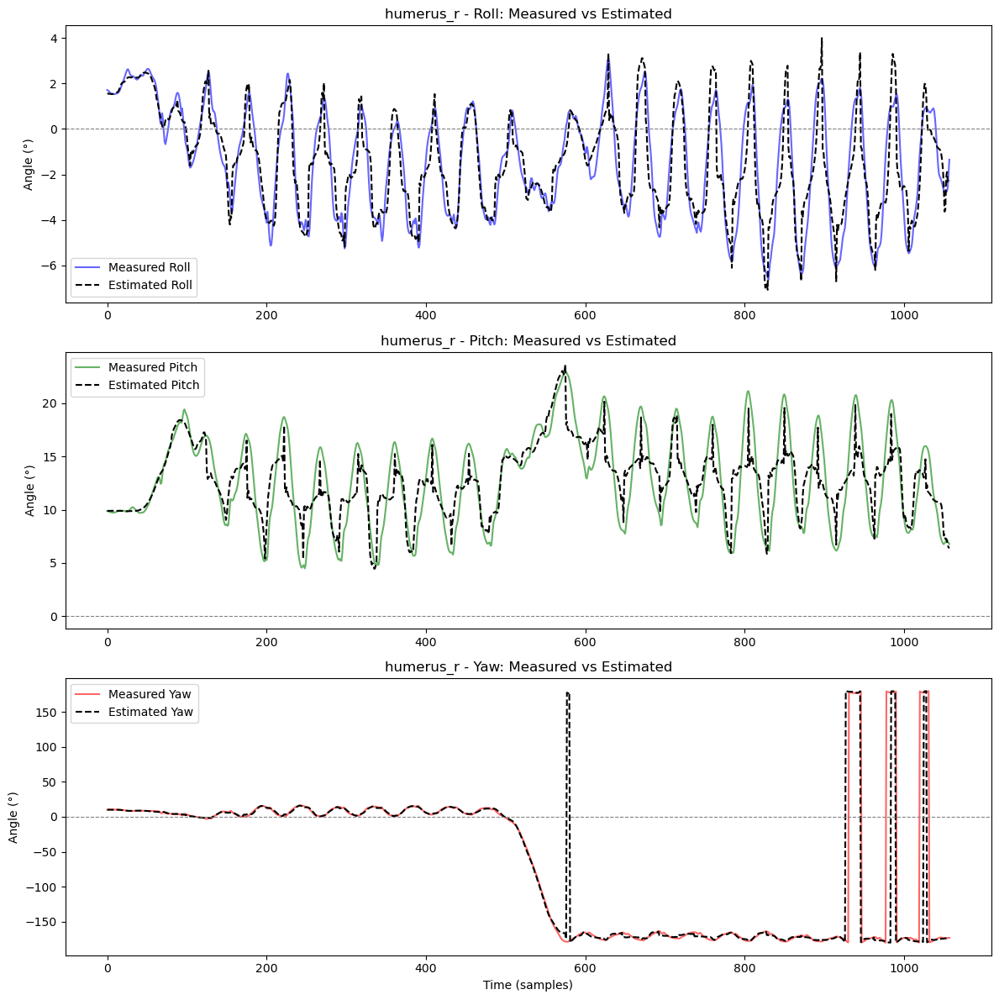


Plotting Measured vs Estimated Orientation for: tibia_l


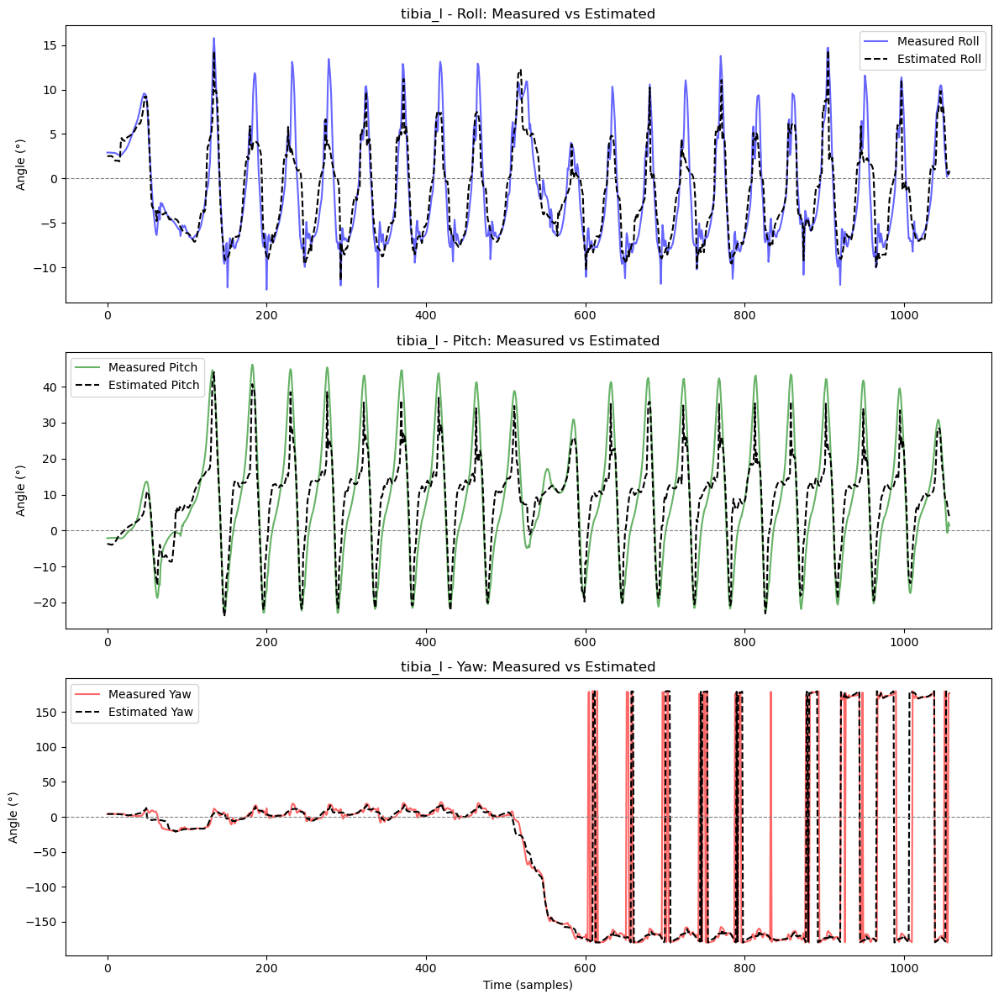


Plotting Measured vs Estimated Orientation for: femur_l


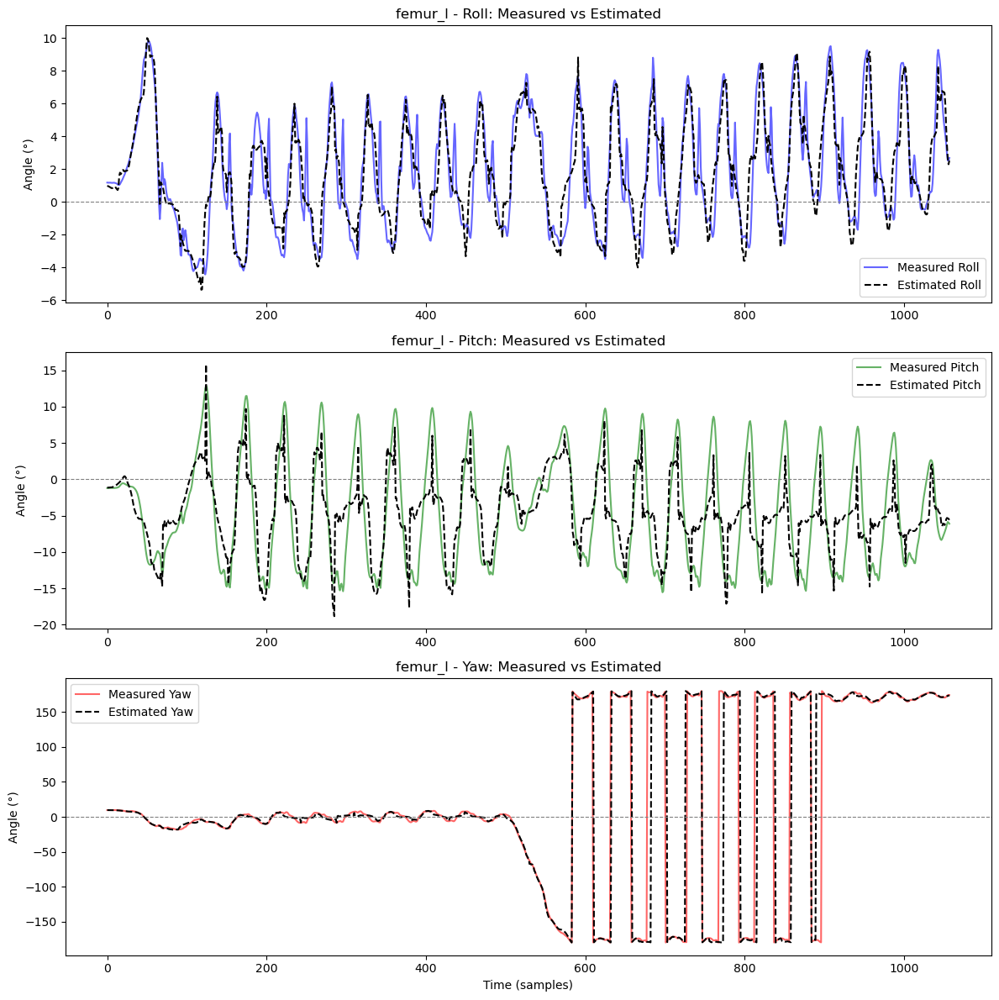

In [11]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Directory with both estimated and measured orientation files
data_dir = "/Users/afonsoamaral/Desktop/data"

# Find all estimated orientation files
estimation_files = [f for f in os.listdir(data_dir) if f.startswith("final_orientation_estimation_corrected") and f.endswith(".csv")]

if not estimation_files:
    raise FileNotFoundError("No final_orientation_estimation_corrected_*.csv files found.")

for file in estimation_files:
    sensor_name = file.replace("final_orientation_estimation_corrected_", "").replace(".csv", "")

    # Define file paths
    est_path = os.path.join(data_dir, file)
    meas_path = os.path.join(data_dir, f"measured_orientation_{sensor_name}.csv")

    # Skip if measured file is missing
    if not os.path.exists(meas_path):
        print(f"Measured orientation file missing for {sensor_name}. Skipping...")
        continue

    # Load data
    df_est = pd.read_csv(est_path)
    df_meas = pd.read_csv(meas_path)

    # Align by shortest length to avoid indexing issues
    min_len = min(len(df_est), len(df_meas))
    df_est = df_est.iloc[:min_len]
    df_meas = df_meas.iloc[:min_len]

    print(f"\nPlotting Measured vs Estimated Orientation for: {sensor_name}")

    # Plot Roll, Pitch, Yaw Comparison
    fig, axes = plt.subplots(3, 1, figsize=(12, 12))

    axes[0].plot(df_meas["Roll_measured"], label="Measured Roll", color='blue', alpha=0.6)
    axes[0].plot(df_est["Roll_Estimated_Corrected"], label="Estimated Roll", linestyle="dashed", color='black')
    axes[0].set_ylabel("Angle (°)")
    axes[0].set_title(f"{sensor_name} - Roll: Measured vs Estimated")
    axes[0].legend()
    axes[0].axhline(0, color='gray', linestyle='--', linewidth=0.8)

    axes[1].plot(df_meas["Pitch_measured"], label="Measured Pitch", color='green', alpha=0.6)
    axes[1].plot(df_est["Pitch_Estimated_Corrected"], label="Estimated Pitch", linestyle="dashed", color='black')
    axes[1].set_ylabel("Angle (°)")
    axes[1].set_title(f"{sensor_name} - Pitch: Measured vs Estimated")
    axes[1].legend()
    axes[1].axhline(0, color='gray', linestyle='--', linewidth=0.8)

    axes[2].plot(df_meas["Yaw_measured"], label="Measured Yaw", color='red', alpha=0.6)
    axes[2].plot(df_est["Yaw_Estimated_Corrected"], label="Estimated Yaw", linestyle="dashed", color='black')
    axes[2].set_xlabel("Time (samples)")
    axes[2].set_ylabel("Angle (°)")
    axes[2].set_title(f"{sensor_name} - Yaw: Measured vs Estimated")
    axes[2].legend()
    axes[2].axhline(0, color='gray', linestyle='--', linewidth=0.8)

    plt.tight_layout()
    plt.show()

## Convert Euler angle orientation-based data to quaternion units for OpenSim interpretation & Creating the orientation files for OpenSim Inverse Kinematics (Movement and Placement Pose)

In [12]:
import os, itertools, numpy as np, pandas as pd
from scipy.spatial.transform import Rotation as R

# point to your pelvis measured file (the one you use for placement)
data_dir = "/Users/afonsoamaral/Desktop/data"
pelvis_csv = os.path.join(data_dir, "final_orientation_estimation_corrected_pelvis.csv")
placement_index = 0   # which row is your placement frame in that file

def read_pelvis_euler_xyz_deg(path, placement_index=0):
    df = pd.read_csv(path)
    eul = df.loc[placement_index, ["Roll_Estimated_Corrected","Pitch_Estimated_Corrected","Yaw_Estimated_Corrected"]].to_numpy(dtype=float)
    return eul  # [roll, pitch, yaw] degrees

def axis_remap_rotations():
    basis = np.eye(3)
    axes = [0,1,2]
    for perm in itertools.permutations(axes):
        for signs in itertools.product([1,-1], repeat=3):
            M = basis[:, perm] * np.array(signs)
            # det +1 ensures a proper rotation (no reflection). Tolerance for float.
            if np.linalg.det(M) > 0.5:
                yield R.from_matrix(M)

def angle_between(u, v):
    u = u / (np.linalg.norm(u) + 1e-12)
    v = v / (np.linalg.norm(v) + 1e-12)
    d = np.clip(np.dot(u, v), -1.0, 1.0)
    return np.degrees(np.arccos(d))

def pick_best_R_WORLD(pelvis_euler_xyz_deg):
    # Rotation from IMU world -> pelvis sensor at placement (from your CSV)
    R_w_to_s = R.from_euler("XYZ", pelvis_euler_xyz_deg, degrees=True)
    # Sensor +X expressed in IMU world (heading proxy)
    x_s_in_w = R_w_to_s.inv().apply([1,0,0])

    candidates = list(axis_remap_rotations())
    best = None
    rows = []
    for idx, C in enumerate(candidates):
        # Up mapping score: try NWU (Z+) and NED (Z-), keep the better (closer to OS +Y)
        up_nwu = angle_between(C.apply([0,0,1]), [0,1,0])   # IMU Z+ -> OS +Y
        up_ned = angle_between(C.apply([0,0,-1]), [0,1,0])  # IMU Z- -> OS +Y
        up_score = min(up_nwu, up_ned)

        # Heading: map pelvis sensor +X (in IMU world) into OS and compare to +X in horizontal plane
        x_s_in_os = C.apply(x_s_in_w)
        x_s_in_os_h = x_s_in_os.copy(); x_s_in_os_h[1] = 0.0  # project to XZ plane
        if np.linalg.norm(x_s_in_os_h) < 1e-9:
            head_score = 180.0
        else:
            head_score = angle_between(x_s_in_os_h, [1,0,0])

        # Weighted score (equal weights by default)
        total = up_score + head_score
        rows.append((idx, up_score, head_score, total, C.as_euler("XYZ", degrees=True)))

        if best is None or total < best[0]:
            best = (total, C)

    rows.sort(key=lambda r: r[3])
    total, Cbest = best
    return Cbest, rows

# run it 
eul0 = read_pelvis_euler_xyz_deg(pelvis_csv, placement_index)
R_WORLD_best, table = pick_best_R_WORLD(eul0)

print("Top 5 candidates (up°, heading°, total°) and as XYZ(deg):")
for i in range(min(5, len(table))):
    idx, up_s, head_s, tot, eul = table[i]
    print(f"{i+1:>2}. up={up_s:6.2f}°, head={head_s:6.2f}°, total={tot:6.2f}°  -> R_WORLD XYZ(deg) = [{eul[0]:.1f}, {eul[1]:.1f}, {eul[2]:.1f}]")

eul_best = R_WORLD_best.as_euler("XYZ", degrees=True)
print("\nPick this for your R_WORLD (XYZ degrees):", eul_best)


Top 5 candidates (up°, heading°, total°) and as XYZ(deg):
 1. up=  0.00°, head= 10.30°, total= 10.30°  -> R_WORLD XYZ(deg) = [90.0, 0.0, 0.0]
 2. up=  0.00°, head= 10.30°, total= 10.30°  -> R_WORLD XYZ(deg) = [-90.0, 0.0, 0.0]
 3. up=  0.00°, head= 79.70°, total= 79.70°  -> R_WORLD XYZ(deg) = [90.0, 0.0, 90.0]
 4. up=  0.00°, head= 79.70°, total= 79.70°  -> R_WORLD XYZ(deg) = [-90.0, 0.0, 90.0]
 5. up= 90.00°, head=  1.69°, total= 91.69°  -> R_WORLD XYZ(deg) = [0.0, 0.0, 0.0]

Pick this for your R_WORLD (XYZ degrees): [90.  0.  0.]


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:55: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.


In [13]:
import os
import numpy as np
import pandas as pd
from scipy.spatial.transform import Rotation as R

# Configuration
data_dir = "/Users/afonsoamaral/Desktop/data"
pelvis_csv = os.path.join(data_dir, "final_orientation_estimation_corrected_pelvis.csv")  # use pelvis, not humerus
placement_index = 0            # which row is your placement frame in that file?
imu_world_up = "Z+"            # try "Z+" (NWU) first; if off, try "Z-" (NED)
bake_heading = False           # True -> include heading in R_WORLD; False -> leave heading to OpenSens


def _unit(v):
    v = np.asarray(v, dtype=float)
    n = np.linalg.norm(v)
    return v / (n if n else 1.0)

def _align_a_to_b(a, b):
    """Rotation that maps unit vector a to unit vector b."""
    a = _unit(a); b = _unit(b)
    v = np.cross(a, b)
    c = np.dot(a, b)
    if c > 0.999999:   # almost aligned
        return R.identity()
    if c < -0.999999:  # opposite: rotate 180° about any orthogonal axis
        axis = _unit(np.array([1,0,0]) if abs(a[0]) < 0.9 else np.array([0,1,0]))
        axis = _unit(np.cross(a, axis))
        return R.from_rotvec(np.pi * axis)
    s = np.linalg.norm(v)
    # Rodrigues
    K = np.array([[    0, -v[2],  v[1]],
                  [ v[2],     0, -v[0]],
                  [-v[1],  v[0],     0]])
    Rm = np.eye(3) + K + K @ K * ((1 - c) / (s**2))
    return R.from_matrix(Rm)

def read_pelvis_euler_xyz_deg(path, placement_index=0):
    df = pd.read_csv(path)
    eul = df.loc[placement_index, ["Roll_Estimated_Corrected","Pitch_Estimated_Corrected","Yaw_Estimated_Corrected"]].to_numpy(dtype=float)
    return eul  # [roll, pitch, yaw] degrees

def estimate_R_WORLD(pelvis_euler_xyz_deg, imu_world_up="Z+", bake_heading=False):
    """
    Returns:
      R_WORLD: IMU-world -> OpenSim-world
      R_up:    up-only part (IMU up -> OS +Y)
      R_heading: heading correction about OS +Y (only used if bake_heading=True)
    """
    # 1) IMU-world -> pelvis sensor at placement, from your CSV (Cardan XYZ)
    R_w_to_s = R.from_euler("XYZ", pelvis_euler_xyz_deg, degrees=True)

    # 2) Up mapping (IMU world up -> OS +Y)
    up_map = {"Z+": np.array([0,0,1]), "Z-": np.array([0,0,-1]),
              "Y+": np.array([0,1,0]), "Y-": np.array([0,-1,0]),
              "X+": np.array([1,0,0]), "X-": np.array([-1,0,0])}
    if imu_world_up not in up_map:
        raise ValueError("imu_world_up must be one of 'Z+','Z-','Y+','Y-','X+','X-'")
    R_up = _align_a_to_b(up_map[imu_world_up], np.array([0,1,0]))  # OS up = +Y

    # 3) Heading from pelvis: sensor +X (local) expressed in IMU world, then map with R_up to OS
    x_s_in_w = R_w_to_s.inv().apply([1,0,0])      # local +X_s seen in IMU world
    x_s_in_os = R_up.apply(x_s_in_w)              # carry into OpenSim world (after up mapping)

    # Project to OS horizontal plane (X-Z)
    xh = x_s_in_os.copy(); xh[1] = 0.0
    if np.linalg.norm(xh) < 1e-9:
        # fallback: if projection degenerates, assume heading already along +X
        R_heading = R.identity()
    else:
        xh = _unit(xh)
        # angle between current heading and OS +X, with axis +Y (right-handed)
        cur = xh; tgt = np.array([1,0,0])
        ang = np.arctan2(np.dot(np.cross(cur, tgt), np.array([0,1,0])), np.dot(cur, tgt))
        R_heading = R.from_rotvec(-ang * np.array([0,1,0]))  # rotate about +Y to face +X

    R_world = (R_heading * R_up) if bake_heading else R_up
    return R_world, R_up, R_heading

# Run once to get R_WORLD 
eul0 = read_pelvis_euler_xyz_deg(pelvis_csv, placement_index)
R_WORLD, R_up, R_heading = estimate_R_WORLD(eul0, imu_world_up=imu_world_up, bake_heading=bake_heading)

# Print results safely (matrix + Euler; Euler may warn near singularities)
print("\nR_WORLD matrix:\n", R_WORLD.as_matrix())
print("R_WORLD XYZ(deg):", R_WORLD.as_euler("XYZ", degrees=True))  # may show gimbal-lock warning; harmless

print("\n(Decomposed)")
print("R_up matrix:\n", R_up.as_matrix())
print("R_heading (about +Y) angle deg:", np.degrees(np.linalg.norm(R_heading.as_rotvec())))

# Guidance:
# - If you set bake_heading=False (recommended), put R_WORLD (=R_up) in ONE place:
#   either in Python when writing STOs, or as sensor_to_opensim_rotations in BOTH Placer & IK.
# - Let OpenSense handle heading correction (more robust across trials).



R_WORLD matrix:
 [[ 1.  0.  0.]
 [ 0.  0.  1.]
 [ 0. -1.  0.]]
R_WORLD XYZ(deg): [-90.   0.   0.]

(Decomposed)
R_up matrix:
 [[ 1.  0.  0.]
 [ 0.  0.  1.]
 [ 0. -1.  0.]]
R_heading (about +Y) angle deg: 10.304527545593889


In [14]:
import os
import numpy as np
import pandas as pd
from scipy.spatial.transform import Rotation as R, Slerp

# ==================== USER CONFIG ====================
data_dir = "/Users/afonsoamaral/Desktop/data"
sampling_hz = 40.0
write_placement_pose = True
placement_index = 0

# Global world mapping (IMU-world → OpenSim-world)
# Example: R_WORLD = R.from_euler('XYZ', [90, 0, 0], degrees=True)
R_WORLD = R.identity()

# Per-IMU Euler config:
# Keys must match the <segment> part of your CSV file names:
#   "final_orientation_estimation_corrected_<segment>.csv"
# For any sensor not listed here, DEFAULT_EULER will be used.
DEFAULT_EULER = dict(order="XYZ", signs=(+1, +1, +1))
EULER_PER_SENSOR = {
    # pelvis/torso/legs
    "pelvis":     dict(order="XYZ", signs=(+1,+1,+1)),
    "torso":      dict(order="XYZ", signs=(+1,+1,+1)),
    "femur_r":    dict(order="XYZ", signs=(+1,+1,+1)),
    "femur_l":    dict(order="XYZ", signs=(+1,+1,+1)),
    "tibia_r":    dict(order="XYZ", signs=(+1,+1,+1)),
    "tibia_l":    dict(order="XYZ", signs=(+1,+1,+1)),
    "calcn_r":    dict(order="XYZ", signs=(+1,+1,+1)),
    "calcn_l":    dict(order="XYZ", signs=(+1,+1,+1)),
    # arms (example: try ZXY if your flexion/abduction look swapped)
    "humerus_r":  dict(order="XYZ", signs=(+1,+1,+1)),
    "humerus_l":  dict(order="XYZ", signs=(+1,+1,+1)),
    "ulna_r":     dict(order="ZYX", signs=(+1,+1,+1)),
    "ulna_l":     dict(order="ZYX", signs=(+1,+1,+1)),
    "hand_r":     dict(order="ZYX", signs=(+1,+1,+1)),
    "hand_l":     dict(order="ZYX", signs=(+1,+1,+1)),
    # head if used
    "head":       dict(order="XYZ", signs=(+1,+1,+1)),
}
# =====================================================

DT = 1.0 / sampling_hz

def read_measured_csv(path):
    df = pd.read_csv(path)
    # time vector
    if "time" in df.columns:
        t = df["time"].to_numpy(dtype=float)
    elif "PacketCounter" in df.columns:
        t = df["PacketCounter"].to_numpy(dtype=float) / sampling_hz
        t = t - t[0]
    else:
        t = np.arange(len(df)) * DT
    # raw Euler about X/Y/Z from file (Roll, Pitch, Yaw)
    euler_xyz = df[["Roll_Estimated_Corrected","Pitch_Estimated_Corrected","Yaw_Estimated_Corrected"]] \
                  .to_numpy(dtype=float)
    return t, euler_xyz

def euler_xyz_to_ordered_rot(euler_xyz_deg, order="XYZ", signs=(+1,+1,+1)):
    """
    Convert per-sample Euler angles given as [X,Y,Z] (deg) into a Rotation
    using an arbitrary composition order (e.g., 'ZXY').
    Steps:
      1) apply sign flips to X,Y,Z
      2) reorder to match requested 'order'
      3) R.from_euler(order, angles_in_that_order, degrees=True)
    """
    e = np.asarray(euler_xyz_deg, dtype=float)
    if e.ndim == 1: e = e[None, :]
    # 1) sign flips on X,Y,Z
    e = e * np.asarray(signs, dtype=float)
    # 2) reorder X,Y,Z → order
    idx = [ {"X":0,"Y":1,"Z":2}[ax] for ax in order.upper() ]
    angles_in_order = e[:, idx]
    # 3) build rotations
    return R.from_euler(order.upper(), angles_in_order, degrees=True)

def apply_world_mapping(rot):
    # premultiply: OpenSimWorld <- IMUWorld
    return R_WORLD * rot

def rot_to_wxyz(rot):
    q_xyzw = rot.as_quat()  # [x y z w]
    q_wxyz = np.column_stack([q_xyzw[:,3], q_xyzw[:,0], q_xyzw[:,1], q_xyzw[:,2]])
    q_wxyz = q_wxyz / np.linalg.norm(q_wxyz, axis=1, keepdims=True)
    return q_wxyz

def enforce_quat_continuity_wxyz(q):
    q = q.copy()
    for i in range(1, len(q)):
        if np.dot(q[i-1], q[i]) < 0:
            q[i] = -q[i]
    return q

def write_sto_quaternion(out_path, time_vec, name_to_quat_wxyz, data_rate_hz):
    cols = {"time": time_vec}
    for name, q in name_to_quat_wxyz.items():
        cols[name] = [",".join(f"{v:.8f}" for v in row) for row in q]
    df = pd.DataFrame(cols)
    with open(out_path, "w") as f:
        f.write(f"DataRate={int(round(data_rate_hz))}\n")
        f.write("DataType=Quaternion\n")
        f.write("version=3\n")
        f.write("OpenSimVersion=4.4\n")
        f.write("endheader\n")
        df.to_csv(f, sep="\t", index=False)

# --- collect files ---
euler_files = sorted(
    f for f in os.listdir(data_dir)
    if f.startswith("final_orientation_estimation_corrected_") and f.endswith(".csv")
)
if not euler_files:
    raise FileNotFoundError("No final_orientation_estimation_corrected_*.csv files found in data_dir.")

rotations_by_sensor = {}
times_by_sensor = {}

for file in euler_files:
    seg = file.replace("final_orientation_estimation_corrected_", "").replace(".csv","")
    sensor_name = f"{seg}_imu"  # column name in movement.sto

    t, euler_xyz_deg = read_measured_csv(os.path.join(data_dir, file))

    # fetch per-sensor config (fallback to default)
    cfg = EULER_PER_SENSOR.get(seg, DEFAULT_EULER)
    order = cfg.get("order", "XYZ")
    signs = cfg.get("signs", (+1,+1,+1))

    # Euler→Rotation, using per-sensor order/signs
    base_rot = euler_xyz_to_ordered_rot(euler_xyz_deg, order=order, signs=signs)

    # Optional IMU-world → OpenSim-world mapping
    rot_os = apply_world_mapping(base_rot)

    rotations_by_sensor[sensor_name] = rot_os
    times_by_sensor[sensor_name] = t

# --- build shared master time grid on exact sampling ticks ---
uniq_times_by_sensor = {}
for name, t in times_by_sensor.items():
    uniq = np.concatenate(([True], np.diff(t) > 0))
    uniq_times_by_sensor[name] = t[uniq]

t0 = max(ts[0] for ts in uniq_times_by_sensor.values())
t1 = min(ts[-1] for ts in uniq_times_by_sensor.values())
grid = 1.0 / sampling_hz
t0 = np.ceil(t0 * sampling_hz) / sampling_hz   # snap up
t1 = np.floor(t1 * sampling_hz) / sampling_hz  # snap down
if t1 < t0:
    raise ValueError("No common time overlap after grid snapping. Check sensor start/stop times.")
n_samples = int(round((t1 - t0) * sampling_hz)) + 1
t_master = t0 + np.arange(n_samples) * grid

# --- SLERP onto master grid & continuity ---
name_to_quat = {}
for name, rot in rotations_by_sensor.items():
    t = times_by_sensor[name]
    uniq = np.concatenate(([True], np.diff(t) > 0))
    t_u = t[uniq]
    rot_u = R.from_quat(rot.as_quat()[uniq])

    mask = (t_master >= t_u[0]) & (t_master <= t_u[-1])
    t_req = t_master[mask]

    slerp = Slerp(t_u, rot_u)
    rot_interp = slerp(t_req)

    q_wxyz = rot_to_wxyz(rot_interp)
    q_wxyz = enforce_quat_continuity_wxyz(q_wxyz)

    out = np.empty((len(t_master), 4))
    out[:] = np.nan
    out[mask] = q_wxyz

    if np.isnan(out).any():
        for j in range(4):
            col = out[:, j]
            idx = np.where(~np.isnan(col))[0]
            col[:idx[0]] = col[idx[0]]
            col[idx[-1]+1:] = col[idx[-1]]
            out[:, j] = col

    name_to_quat[name] = out

# --- write movement.sto ---
out_movement = os.path.join(data_dir, "movement.sto")
write_sto_quaternion(out_movement, t_master, name_to_quat, sampling_hz)
print("Saved orientations:", out_movement)

# --- placement pose (optional) ---
if write_placement_pose:
    if not (0 <= placement_index < len(t_master)):
        raise IndexError("placement_index is out of range of the master time grid.")
    name_to_quat_1row = {name: q[[placement_index], :] for name, q in name_to_quat.items()}
    out_placement = os.path.join(data_dir, "placement_pose.sto")
    write_sto_quaternion(out_placement, t_master[[placement_index]], name_to_quat_1row, sampling_hz)
    print("Saved placement pose:", out_placement)

# --- sanity checks ---
for name, q in name_to_quat.items():
    dots = np.sum(q[:-1] * q[1:], axis=1)
    if (dots < 0).any():
        print("WARNING: continuity failure detected after enforcement:", name)

print("All sensors length on master grid:", {k: len(v) for k, v in name_to_quat.items()})
print("Columns written:", list(name_to_quat.keys()))


Saved orientations: /Users/afonsoamaral/Desktop/data/movement.sto
Saved placement pose: /Users/afonsoamaral/Desktop/data/placement_pose.sto
All sensors length on master grid: {'calcn_l_imu': 1058, 'calcn_r_imu': 1058, 'femur_l_imu': 1058, 'femur_r_imu': 1058, 'hand_l_imu': 1058, 'hand_r_imu': 1058, 'head_imu': 1058, 'humerus_l_imu': 1058, 'humerus_r_imu': 1058, 'pelvis_imu': 1058, 'tibia_l_imu': 1058, 'tibia_r_imu': 1058, 'torso_imu': 1058, 'ulna_l_imu': 1058, 'ulna_r_imu': 1058, 'unknown_imu': 1058}
Columns written: ['calcn_l_imu', 'calcn_r_imu', 'femur_l_imu', 'femur_r_imu', 'hand_l_imu', 'hand_r_imu', 'head_imu', 'humerus_l_imu', 'humerus_r_imu', 'pelvis_imu', 'tibia_l_imu', 'tibia_r_imu', 'torso_imu', 'ulna_l_imu', 'ulna_r_imu', 'unknown_imu']


In [15]:
import os
import numpy as np
import pandas as pd
from scipy.spatial.transform import Rotation as R, Slerp

# ==================== USER CONFIG ====================
data_dir = "/Users/afonsoamaral/Desktop/data"
sampling_hz = 40.0
write_placement_pose = True
placement_index = 0

# Global world mapping (IMU-world → OpenSim-world)
# Example: R_WORLD = R.from_euler('XYZ', [90, 0, 0], degrees=True)
R_WORLD = R.identity()

# Per-IMU Euler config:
# Keys must match the <segment> part of your CSV file names:
#   "final_orientation_estimation_corrected_<segment>.csv"
# For any sensor not listed here, DEFAULT_EULER will be used.
DEFAULT_EULER = dict(order="XYZ", signs=(+1, +1, +1))
EULER_PER_SENSOR = {
    # pelvis/torso/legs
    "pelvis":     dict(order="XYZ", signs=(+1,+1,+1)),
    "torso":      dict(order="XYZ", signs=(+1,+1,+1)),
    "femur_r":    dict(order="XYZ", signs=(+1,+1,+1)),
    "femur_l":    dict(order="XYZ", signs=(+1,+1,+1)),
    "tibia_r":    dict(order="XYZ", signs=(+1,+1,+1)),
    "tibia_l":    dict(order="XYZ", signs=(+1,+1,+1)),
    "calcn_r":    dict(order="XYZ", signs=(+1,+1,+1)),
    "calcn_l":    dict(order="XYZ", signs=(+1,+1,+1)),
    # arms (example: try ZXY if your flexion/abduction look swapped)
    "humerus_r":  dict(order="XYZ", signs=(+1,+1,+1)),
    "humerus_l":  dict(order="XYZ", signs=(+1,+1,+1)),
    "ulna_r":     dict(order="ZYX", signs=(+1,+1,+1)),
    "ulna_l":     dict(order="ZYX", signs=(+1,+1,+1)),
    "hand_r":     dict(order="ZYX", signs=(+1,+1,+1)),
    "hand_l":     dict(order="ZYX", signs=(+1,+1,+1)),
    # head if used
    "head":       dict(order="XYZ", signs=(+1,+1,+1)),
}
# =====================================================

DT = 1.0 / sampling_hz

def read_measured_csv(path):
    df = pd.read_csv(path)
    # time vector
    if "time" in df.columns:
        t = df["time"].to_numpy(dtype=float)
    elif "PacketCounter" in df.columns:
        t = df["PacketCounter"].to_numpy(dtype=float) / sampling_hz
        t = t - t[0]
    else:
        t = np.arange(len(df)) * DT
    # raw Euler about X/Y/Z from file (Roll, Pitch, Yaw)
    euler_xyz = df[["Roll_Estimated_Corrected","Pitch_Estimated_Corrected","Yaw_Estimated_Corrected"]] \
                  .to_numpy(dtype=float)
    return t, euler_xyz

def euler_xyz_to_ordered_rot(euler_xyz_deg, order="XYZ", signs=(+1,+1,+1)):
    """
    Convert per-sample Euler angles given as [X,Y,Z] (deg) into a Rotation
    using an arbitrary composition order (e.g., 'ZXY').
    Steps:
      1) apply sign flips to X,Y,Z
      2) reorder to match requested 'order'
      3) R.from_euler(order, angles_in_that_order, degrees=True)
    """
    e = np.asarray(euler_xyz_deg, dtype=float)
    if e.ndim == 1:
        e = e[None, :]
    # 1) sign flips on X,Y,Z
    e = e * np.asarray(signs, dtype=float)
    # 2) reorder X,Y,Z → order
    idx = [ {"X":0,"Y":1,"Z":2}[ax] for ax in order.upper() ]
    angles_in_order = e[:, idx]
    # 3) build rotations
    return R.from_euler(order.upper(), angles_in_order, degrees=True)

def apply_world_mapping(rot):
    # premultiply: OpenSimWorld <- IMUWorld
    return R_WORLD * rot

def rot_to_wxyz(rot):
    q_xyzw = rot.as_quat()  # [x y z w]
    q_wxyz = np.column_stack([q_xyzw[:,3], q_xyzw[:,0], q_xyzw[:,1], q_xyzw[:,2]])
    q_wxyz = q_wxyz / np.linalg.norm(q_wxyz, axis=1, keepdims=True)
    return q_wxyz

def enforce_quat_continuity_wxyz(q):
    q = q.copy()
    for i in range(1, len(q)):
        if np.dot(q[i-1], q[i]) < 0:
            q[i] = -q[i]
    return q

def write_sto_quaternion(out_path, time_vec, name_to_quat_wxyz, data_rate_hz):
    cols = {"time": time_vec}
    for name, q in name_to_quat_wxyz.items():
        cols[name] = [",".join(f"{v:.8f}" for v in row) for row in q]
    df = pd.DataFrame(cols)
    with open(out_path, "w") as f:
        f.write(f"DataRate={int(round(data_rate_hz))}\n")
        f.write("DataType=Quaternion\n")
        f.write("version=3\n")
        f.write("OpenSimVersion=4.4\n")
        f.write("endheader\n")
        df.to_csv(f, sep="\t", index=False)

# --- collect files ---
euler_files = sorted(
    f for f in os.listdir(data_dir)
    if f.startswith("final_orientation_estimation_corrected_") and f.endswith(".csv")
)
if not euler_files:
    raise FileNotFoundError("No final_orientation_estimation_corrected_*.csv files found in data_dir.")

rotations_by_sensor = {}
times_by_sensor = {}

for file in euler_files:
    seg = file.replace("final_orientation_estimation_corrected_", "").replace(".csv","")
    sensor_name = f"{seg}_imu"  # column name in movement.sto

    t, euler_xyz_deg = read_measured_csv(os.path.join(data_dir, file))

    # fetch per-sensor config (fallback to default)
    cfg = EULER_PER_SENSOR.get(seg, DEFAULT_EULER)
    order = cfg.get("order", "XYZ")
    signs = cfg.get("signs", (+1,+1,+1))

    # Euler→Rotation, using per-sensor order/signs
    base_rot = euler_xyz_to_ordered_rot(euler_xyz_deg, order=order, signs=signs)

    # Optional IMU-world → OpenSim-world mapping
    rot_os = apply_world_mapping(base_rot)

    rotations_by_sensor[sensor_name] = rot_os
    times_by_sensor[sensor_name] = t

# --- build master time grid covering the UNION of all sensors ---
uniq_times_by_sensor = {}
for name, t in times_by_sensor.items():
    # keep strictly increasing time stamps
    uniq = np.concatenate(([True], np.diff(t) > 0))
    uniq_times_by_sensor[name] = t[uniq]

# Earliest start across sensors (snap DOWN), latest end across sensors (snap UP)
t0_raw = min(ts[0] for ts in uniq_times_by_sensor.values())
t1_raw = max(ts[-1] for ts in uniq_times_by_sensor.values())

grid = 1.0 / sampling_hz

# Robust snap to sampling ticks (tolerate tiny FP errors)
t0 = np.floor(t0_raw * sampling_hz + 1e-9) / sampling_hz  # snap down
t1 = np.ceil(  t1_raw * sampling_hz - 1e-9) / sampling_hz  # snap up

if t1 < t0:
    raise ValueError(
        f"No valid time span after snapping (t1<t0). "
        f"t0_raw={t0_raw:.6f}, t1_raw={t1_raw:.6f}, sampling_hz={sampling_hz}"
    )

n_samples = int(round((t1 - t0) * sampling_hz)) + 1
t_master = t0 + np.arange(n_samples) * grid

print(f"Master grid: {t_master[0]:.6f} → {t_master[-1]:.6f}  ({len(t_master)} samples @ {sampling_hz} Hz)")
for name, ts in uniq_times_by_sensor.items():
    print(f"{name:20s}: {ts[0]:.6f} → {ts[-1]:.6f}  (Δ={ts[-1]-ts[0]:.3f}s)")

# --- SLERP onto master grid & continuity ---
name_to_quat = {}
for name, rot in rotations_by_sensor.items():
    t = times_by_sensor[name]
    uniq = np.concatenate(([True], np.diff(t) > 0))
    t_u = t[uniq]
    # Ensure we pass unique/increasing timestamps to Slerp
    rot_u = R.from_quat(rot.as_quat()[uniq])

    # Interpolate only where this sensor has data; pad elsewhere later
    mask = (t_master >= t_u[0]) & (t_master <= t_u[-1])
    t_req = t_master[mask]

    if t_req.size == 0:
        # Sensor entirely outside master grid (shouldn't happen with union, but guard anyway)
        # Fill whole track with the sensor's first orientation.
        q0 = rot_u.as_quat()[0:1, :]
        q0_wxyz = np.column_stack([q0[:,3], q0[:,0], q0[:,1], q0[:,2]])
        out = np.repeat(q0_wxyz, len(t_master), axis=0)
        name_to_quat[name] = out
        continue

    slerp = Slerp(t_u, rot_u)
    rot_interp = slerp(t_req)

    q_wxyz = rot_to_wxyz(rot_interp)
    q_wxyz = enforce_quat_continuity_wxyz(q_wxyz)

    out = np.empty((len(t_master), 4))
    out[:] = np.nan
    out[mask] = q_wxyz

    # Pad before first and after last valid sample with edge values
    if np.isnan(out).any():
        for j in range(4):
            col = out[:, j]
            idx = np.where(~np.isnan(col))[0]
            if idx.size == 0:
                # Shouldn't occur, but guard: fill with zeros except w=1
                out[:, :] = 0.0
                out[:, 0] = 1.0
                break
            col[:idx[0]] = col[idx[0]]
            col[idx[-1]+1:] = col[idx[-1]]
            out[:, j] = col

    name_to_quat[name] = out

# --- write movement.sto ---
out_movement = os.path.join(data_dir, "movement.sto")
write_sto_quaternion(out_movement, t_master, name_to_quat, sampling_hz)
print("Saved orientations:", out_movement)

# --- placement pose (optional) ---
if write_placement_pose:
    if not (0 <= placement_index < len(t_master)):
        raise IndexError("placement_index is out of range of the master time grid.")
    name_to_quat_1row = {name: q[[placement_index], :] for name, q in name_to_quat.items()}
    out_placement = os.path.join(data_dir, "placement_pose.sto")
    write_sto_quaternion(out_placement, t_master[[placement_index]], name_to_quat_1row, sampling_hz)
    print("Saved placement pose:", out_placement)

# --- sanity checks ---
for name, q in name_to_quat.items():
    dots = np.sum(q[:-1] * q[1:], axis=1)
    if (dots < 0).any():
        print("WARNING: continuity failure detected after enforcement:", name)

print("All sensors length on master grid:", {k: len(v) for k, v in name_to_quat.items()})
print("Columns written:", list(name_to_quat.keys()))


Master grid: 0.000000 → 155.000000  (6201 samples @ 40.0 Hz)
calcn_l_imu         : 0.000000 → 26.425000  (Δ=26.425s)
calcn_r_imu         : 0.000000 → 26.425000  (Δ=26.425s)
femur_l_imu         : 0.000000 → 26.425000  (Δ=26.425s)
femur_r_imu         : 0.000000 → 26.425000  (Δ=26.425s)
hand_l_imu          : 0.000000 → 26.425000  (Δ=26.425s)
hand_r_imu          : 0.000000 → 26.425000  (Δ=26.425s)
head_imu            : 0.000000 → 26.425000  (Δ=26.425s)
humerus_l_imu       : 0.000000 → 26.425000  (Δ=26.425s)
humerus_r_imu       : 0.000000 → 26.425000  (Δ=26.425s)
pelvis_imu          : 0.000000 → 26.425000  (Δ=26.425s)
tibia_l_imu         : 0.000000 → 26.425000  (Δ=26.425s)
tibia_r_imu         : 0.000000 → 26.425000  (Δ=26.425s)
torso_imu           : 0.000000 → 26.425000  (Δ=26.425s)
ulna_l_imu          : 0.000000 → 26.425000  (Δ=26.425s)
ulna_r_imu          : 0.000000 → 26.425000  (Δ=26.425s)
unknown_imu         : 0.000000 → 155.000000  (Δ=155.000s)
Saved orientations: /Users/afonsoamaral/D